Analysis of Election Dataset

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
pd.set_option('max_columns',25)
pd.set_option('display.max_colwidth',300)
pd.set_option('max_rows',25)
 

In [3]:
pd.read_excel('Election_Data.xlsx')

,**Data Dictionary**
0,1. vote: Party choice: Conservative or Labour
1,2. age: in years
2,"3. economic.cond.national: Assessment of current national economic conditions, 1 to 5."
3,"4. economic.cond.household: Assessment of current household economic conditions, 1 to 5."
4,"5. Blair: Assessment of the Labour leader, 1 to 5."
5,"6. Hague: Assessment of the Conservative leader, 1 to 5."
6,7. Europe: an 11-point scale that measures respondents' attitudes toward European integration. High scores represent ‘Eurosceptic’ sentiment.
7,"8. political.knowledge: Knowledge of parties' positions on European integration, 0 to 3."
8,9. gender: female or male.


In [4]:
df = pd.read_excel ('Election_Data.xlsx', sheet_name='Election_Dataset_Two Classes')

In [5]:
df.head(20)

,Unnamed: 0,vote,age,economic.cond.national,economic.cond.household,Blair,Hague,Europe,political.knowledge,gender
0,1,Labour,43,3,3,4,1,2,2,female
1,2,Labour,36,4,4,4,4,5,2,male
2,3,Labour,35,4,4,5,2,3,2,male
3,4,Labour,24,4,2,2,1,4,0,female
4,5,Labour,41,2,2,1,1,6,2,male
5,6,Labour,47,3,4,4,4,4,2,male
6,7,Labour,57,2,2,4,4,11,2,male
7,8,Labour,77,3,4,4,1,1,0,male
8,9,Labour,39,3,3,4,4,11,0,female
9,10,Labour,70,3,2,5,1,11,2,male


In [6]:
df.drop('Unnamed: 0',axis=1,inplace=True)

In [7]:
df.head()

,vote,age,economic.cond.national,economic.cond.household,Blair,Hague,Europe,political.knowledge,gender
0,Labour,43,3,3,4,1,2,2,female
1,Labour,36,4,4,4,4,5,2,male
2,Labour,35,4,4,5,2,3,2,male
3,Labour,24,4,2,2,1,4,0,female
4,Labour,41,2,2,1,1,6,2,male


In [8]:
df.isna().sum()

vote                       0
age                        0
economic.cond.national     0
economic.cond.household    0
Blair                      0
Hague                      0
Europe                     0
political.knowledge        0
gender                     0
dtype: int64

In [9]:
df.describe(include='all')

,vote,age,economic.cond.national,economic.cond.household,Blair,Hague,Europe,political.knowledge,gender
count,1525,1525.000000,1525.000000,1525.000000,1525.000000,1525.000000,1525.000000,1525.000000,1525
unique,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2
top,Labour,NaN,NaN,NaN,NaN,NaN,NaN,NaN,female
freq,1063,NaN,NaN,NaN,NaN,NaN,NaN,NaN,812
mean,NaN,54.182295,3.245902,3.140328,3.334426,2.746885,6.728525,1.542295,NaN
std,NaN,15.711209,0.880969,0.929951,1.174824,1.230703,3.297538,1.083315,NaN
min,NaN,24.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,NaN
25%,NaN,41.000000,3.000000,3.000000,2.000000,2.000000,4.000000,0.000000,NaN
50%,NaN,53.000000,3.000000,3.000000,4.000000,2.000000,6.000000,2.000000,NaN
75%,NaN,67.000000,4.000000,4.000000,4.000000,4.000000,10.000000,2.000000,NaN


In [10]:
df.shape

(1525, 9)

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1525 entries, 0 to 1524
Data columns (total 9 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   vote                     1525 non-null   object
 1   age                      1525 non-null   int64 
 2   economic.cond.national   1525 non-null   int64 
 3   economic.cond.household  1525 non-null   int64 
 4   Blair                    1525 non-null   int64 
 5   Hague                    1525 non-null   int64 
 6   Europe                   1525 non-null   int64 
 7   political.knowledge      1525 non-null   int64 
 8   gender                   1525 non-null   object
dtypes: int64(7), object(2)
memory usage: 107.4+ KB


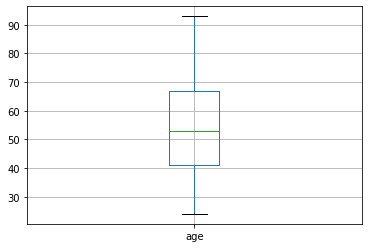

In [12]:
df.boxplot('age')

(array([1, 2, 3, 4, 5, 6]), <a list of 6 Text xticklabel objects>)

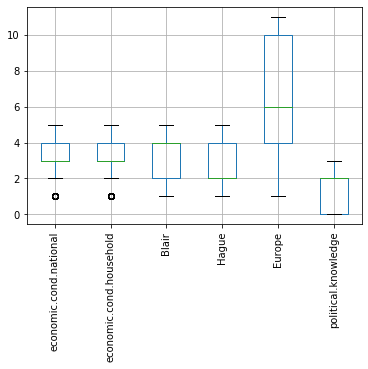

In [13]:
df.drop('age',axis=1).boxplot()
plt.xticks(rotation=90)

In [14]:
def remove_outlier(col):
    sorted(col)
    Q1,Q3=np.percentile(col,[25,75])
    IQR=Q3-Q1
    lower_range= Q1-(1.5 * IQR)
    upper_range= Q3+(1.5 * IQR)
    return lower_range, upper_range

In [15]:
for column in df.iloc[:, 1:7].columns:
    lr,ur=remove_outlier(df[column])
    df[column]=np.where(df[column]>ur,ur,df[column])
    df[column]=np.where(df[column]<lr,lr,df[column])

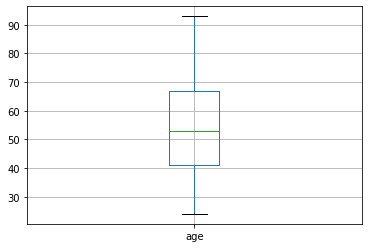

In [16]:
df.boxplot('age')

(array([1, 2, 3, 4, 5, 6]), <a list of 6 Text xticklabel objects>)

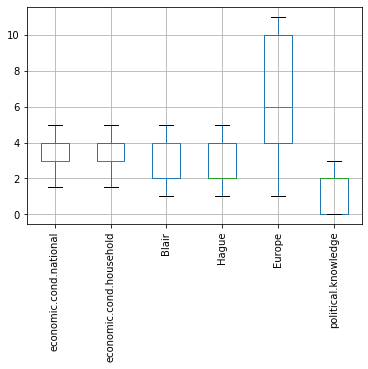

In [17]:
df.drop('age',axis=1).boxplot()
plt.xticks(rotation=90)

In [18]:
df['age']=df['age'].astype('int64')
df['economic.cond.national']=df['economic.cond.national'].astype('int64')
df['economic.cond.household']=df['economic.cond.household'].astype('int64')
df['Blair']=df['Blair'].astype('int64')
df['Hague']=df['Hague'].astype('int64')
df['Europe']=df['Europe'].astype('int64')
df['political.knowledge']=df['political.knowledge'].astype('int64')

In [19]:
df.mean()

age                        54.182295
economic.cond.national      3.245902
economic.cond.household     3.140328
Blair                       3.334426
Hague                       2.746885
Europe                      6.728525
political.knowledge         1.542295
dtype: float64

In [20]:
df.median()

age                        53.0
economic.cond.national      3.0
economic.cond.household     3.0
Blair                       4.0
Hague                       2.0
Europe                      6.0
political.knowledge         2.0
dtype: float64

In [21]:
df.mode()

,vote,age,economic.cond.national,economic.cond.household,Blair,Hague,Europe,political.knowledge,gender
0,Labour,37,3,3,4,2,11,2,female


In [22]:
df.var()

age                        246.842075
economic.cond.national       0.776107
economic.cond.household      0.864810
Blair                        1.380212
Hague                        1.514631
Europe                      10.873759
political.knowledge          1.173571
dtype: float64

In [23]:
sns.set()
sns.set_style("whitegrid") 
sns.set_style("ticks", 
{"xtick.major.size":8,
"ytick.major.size":8})
sns.axes_style("whitegrid")

{'figure.facecolor': 'white',
 'axes.labelcolor': '.15',
 'xtick.direction': 'out',
 'ytick.direction': 'out',
 'xtick.color': '.15',
 'ytick.color': '.15',
 'axes.axisbelow': True,
 'grid.linestyle': '-',
 'text.color': '.15',
 'font.family': ['sans-serif'],
 'font.sans-serif': ['Arial',
  'DejaVu Sans',
  'Liberation Sans',
  'Bitstream Vera Sans',
  'sans-serif'],
 'lines.solid_capstyle': 'round',
 'patch.edgecolor': 'w',
 'patch.force_edgecolor': True,
 'image.cmap': 'rocket',
 'xtick.top': False,
 'ytick.right': False,
 'axes.grid': True,
 'axes.facecolor': 'white',
 'axes.edgecolor': '.8',
 'grid.color': '.8',
 'axes.spines.left': True,
 'axes.spines.bottom': True,
 'axes.spines.right': True,
 'axes.spines.top': True,
 'xtick.bottom': False,
 'ytick.left': False}

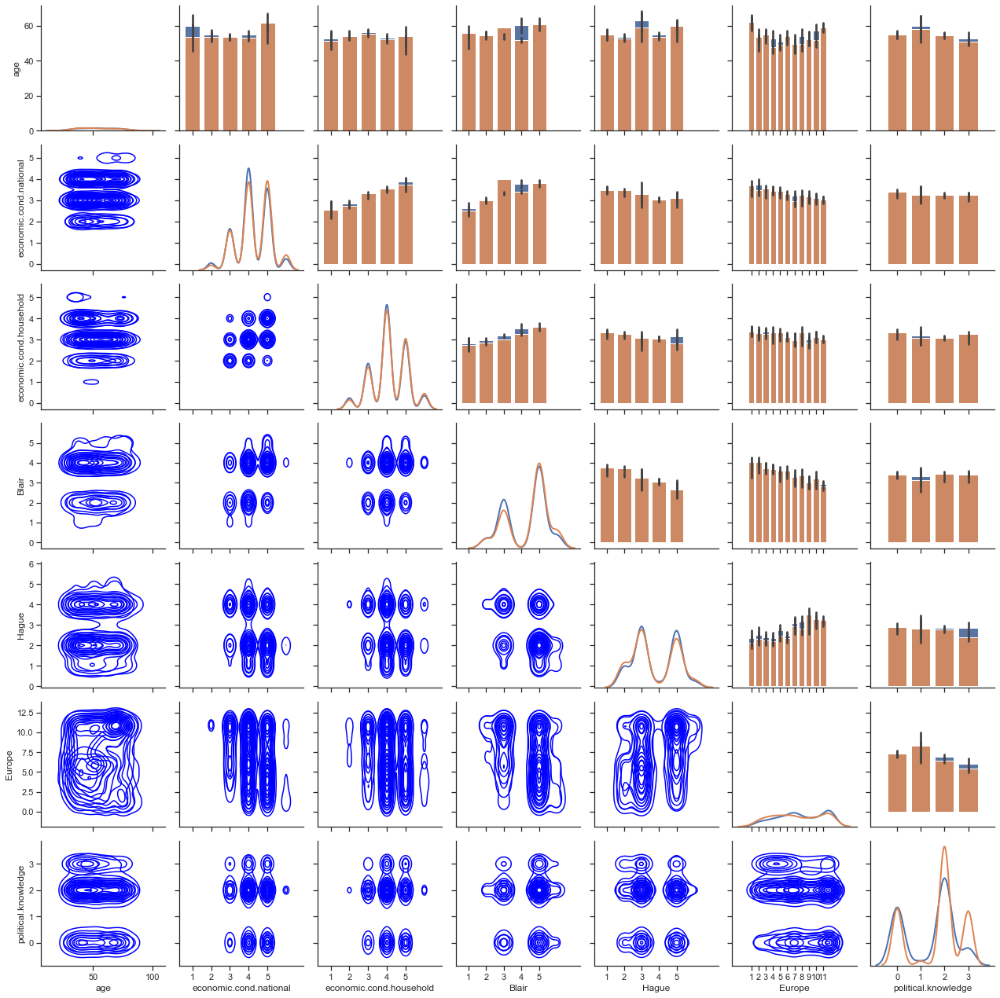

In [24]:
#sns.pairplot(df,hue='gender',kind="reg")


g = sns.PairGrid(df,hue='gender')
g = g.map_upper(sns.barplot)
g = g.map_lower(sns.kdeplot, colors=["Blue"])
g = g.map_diag(sns.kdeplot, lw=2)

In [26]:
df.shape

(1525, 9)

In [27]:
pd.crosstab(df['vote'],df['gender'],margins=True)

gender,female,male,All
vote,,,
Conservative,259,203,462
Labour,553,510,1063
All,812,713,1525


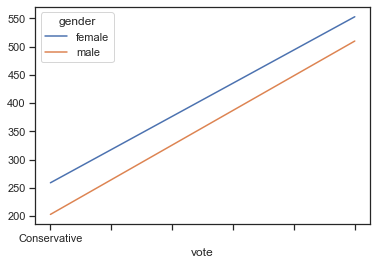

In [28]:
pd.crosstab(df['vote'],df['gender']).plot()

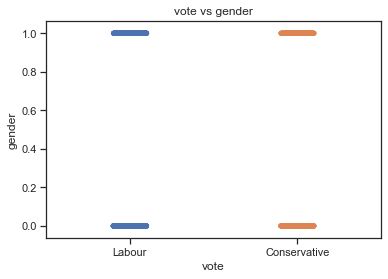

In [30]:


ax = sns.stripplot(df['vote'],df['gender'].replace({'male':0,'female':1}),jitter=True); 
  
# giving labels to x-axis and y-axis 
ax.set(xlabel ='vote', ylabel ='gender') 
  
# giving title to the plot 
plt.title('vote vs gender'); 
  
# function to show plot 
plt.show()




In [31]:
pd.crosstab(df['vote'],df['age'],margins=True).T

vote,Conservative,Labour,All
age,,,
24,4,7,11
25,1,3,4
26,1,6,7
27,5,10,15
28,2,7,9
...,...,...,...
90,1,0,1
91,0,1,1
92,2,0,2


In [32]:
pd.set_option('max_columns',100)
pd.set_option('display.max_colwidth',300)
pd.set_option('max_rows',100)
pd.crosstab(df['vote'],df['age'],margins=True).T

vote,Conservative,Labour,All
age,,,
24,4,7,11
25,1,3,4
26,1,6,7
27,5,10,15
28,2,7,9
29,4,12,16
30,4,11,15
31,3,15,18
32,5,16,21


vote vs age


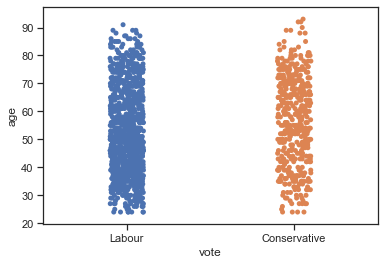

vote vs Blair


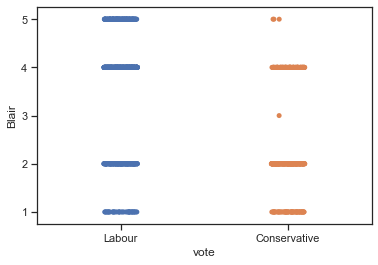

vote vs Hague


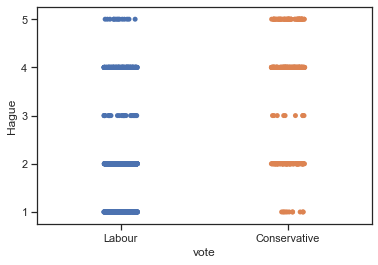

vote vs economic.cond.national


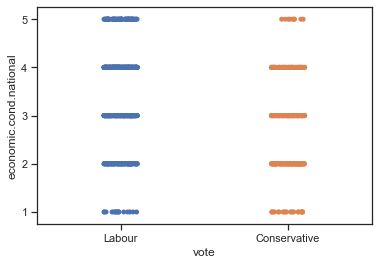

vote vs economic.cond.household


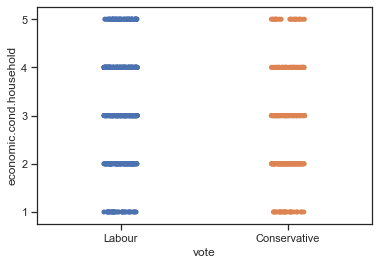

vote vs Europe


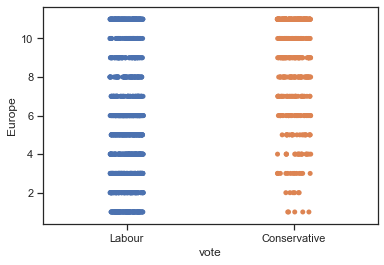

vote vs political.knowledge


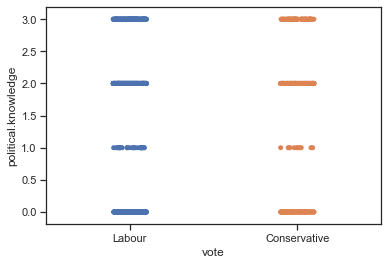

In [33]:
cat=['age','Blair','Hague','economic.cond.national','economic.cond.household','Europe','political.knowledge']
for i in range(len(cat)):
    ax = sns.stripplot(df['vote'],df[cat[i]],jitter=True)
    # giving title to the plot 
    plt.title(print('vote'+' '+ 'vs'+' '+ cat[i]))
    
    # function to show plot 
    plt.show()

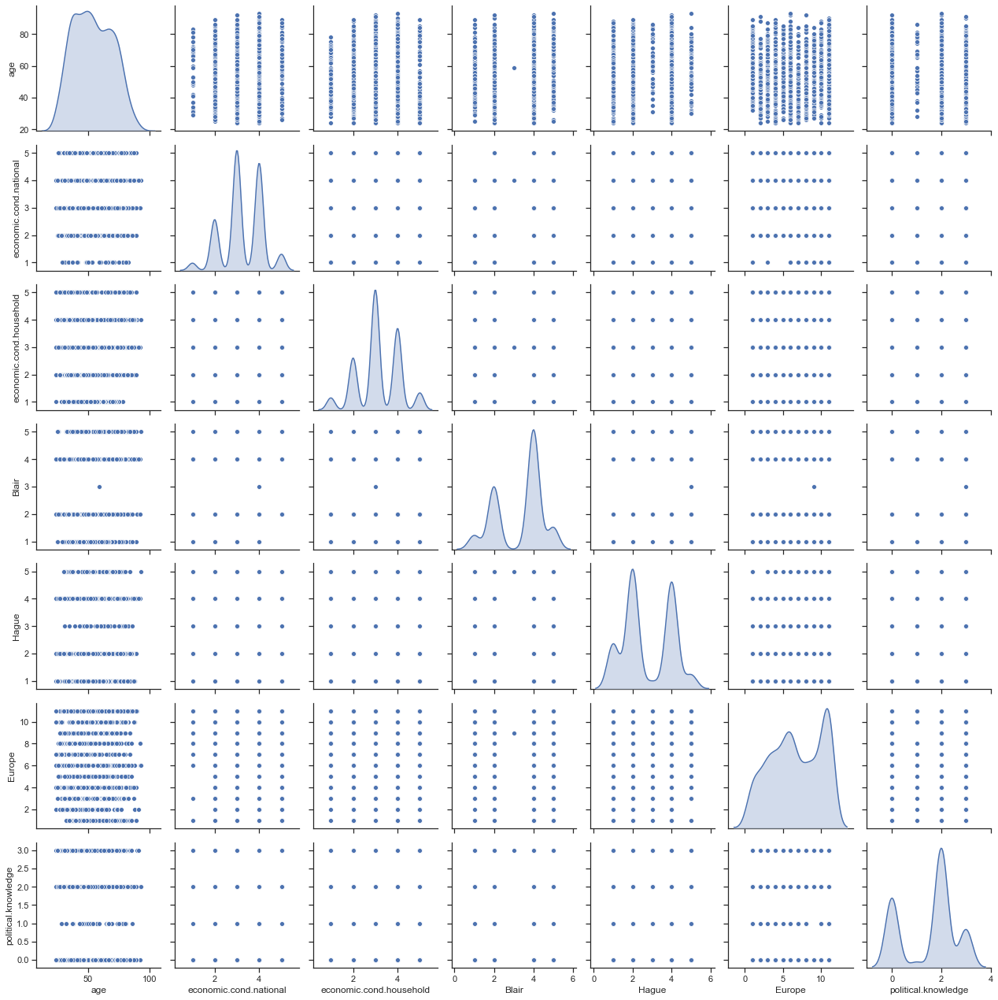

In [34]:
sns.pairplot(df,diag_kind='kde')

In [35]:
df.corr()

,age,economic.cond.national,economic.cond.household,Blair,Hague,Europe,political.knowledge
age,1.000000,0.018567,-0.041587,0.030218,0.034626,0.068880,-0.048490
economic.cond.national,0.018567,1.000000,0.346303,0.326878,-0.199766,-0.209429,-0.023624
economic.cond.household,-0.041587,0.346303,1.000000,0.215273,-0.101956,-0.114885,-0.037810
Blair,0.030218,0.326878,0.215273,1.000000,-0.243210,-0.296162,-0.020917
Hague,0.034626,-0.199766,-0.101956,-0.243210,1.000000,0.287350,-0.030354
Europe,0.068880,-0.209429,-0.114885,-0.296162,0.287350,1.000000,-0.152364
political.knowledge,-0.048490,-0.023624,-0.037810,-0.020917,-0.030354,-0.152364,1.000000


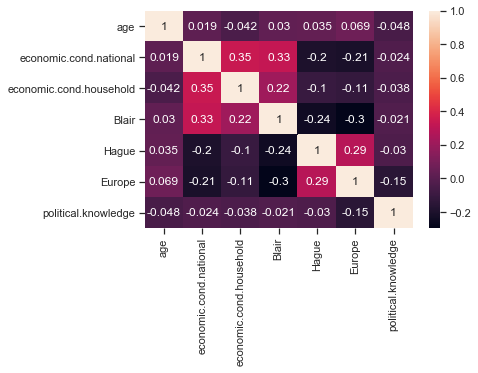

In [36]:
sns.heatmap(df.corr(),annot=True)

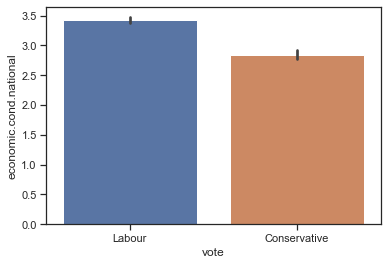

In [37]:
sns.barplot(x="vote", 
y="economic.cond.national", 

data=df)

In [38]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1525 entries, 0 to 1524
Data columns (total 9 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   vote                     1525 non-null   object
 1   age                      1525 non-null   int64 
 2   economic.cond.national   1525 non-null   int64 
 3   economic.cond.household  1525 non-null   int64 
 4   Blair                    1525 non-null   int64 
 5   Hague                    1525 non-null   int64 
 6   Europe                   1525 non-null   int64 
 7   political.knowledge      1525 non-null   int64 
 8   gender                   1525 non-null   object
dtypes: int64(7), object(2)
memory usage: 107.4+ KB


In [39]:
df.columns

Index(['vote', 'age', 'economic.cond.national', 'economic.cond.household',
       'Blair', 'Hague', 'Europe', 'political.knowledge', 'gender'],
      dtype='object')

votevscat[i]


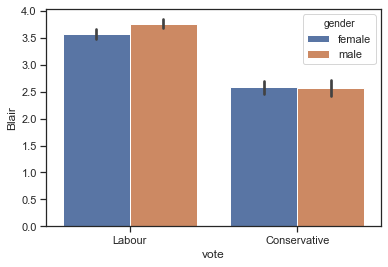

votevscat[i]


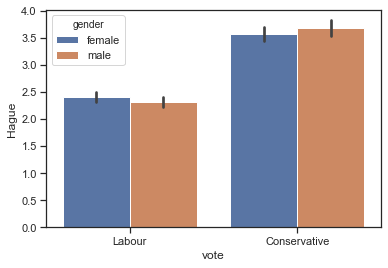

votevscat[i]


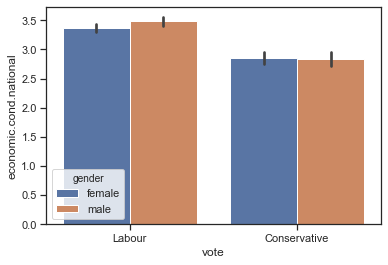

votevscat[i]


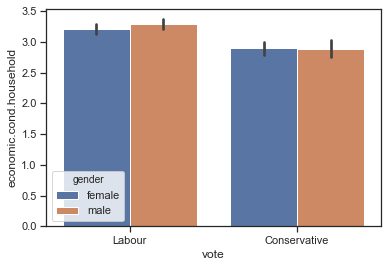

votevscat[i]


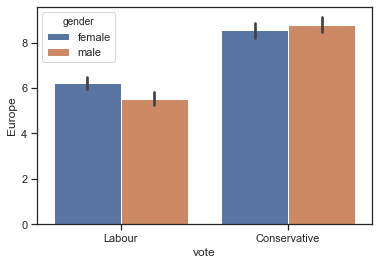

votevscat[i]


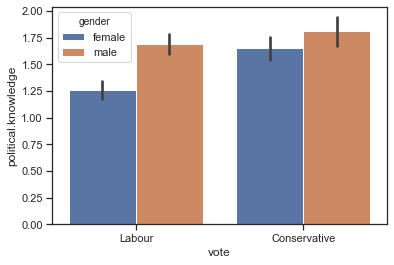

In [40]:
cat=['Blair','Hague','economic.cond.national','economic.cond.household','Europe','political.knowledge']
for i in range(len(cat)):
    
    
    
    ax = sns.barplot(df['vote'],df[cat[i]],hue=df['gender']); 

    # giving labels to x-axis and y-axis 
    ax.set(xlabel ='vote', ylabel =cat[i]) 

    # giving title to the plot 
    plt.title(print('vote'+''+ 'vs'+ ''+cat[i])); 

    # function to show plot 
    plt.show()

count plot of vote


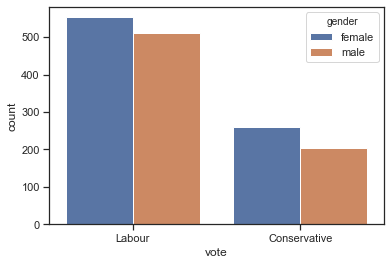

count plot of gender


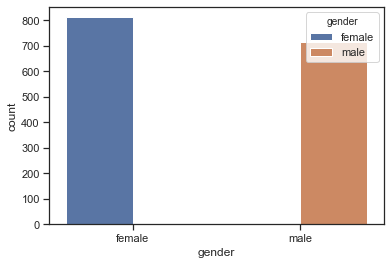

count plot of Blair


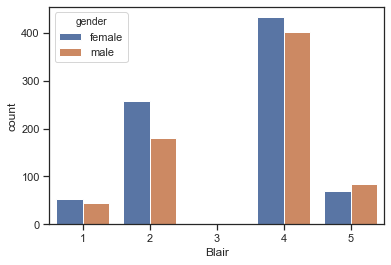

count plot of Hague


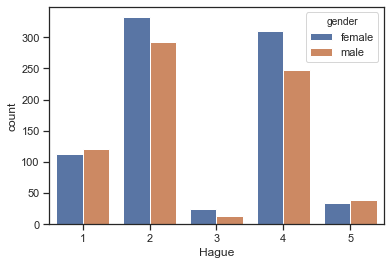

count plot of economic.cond.national


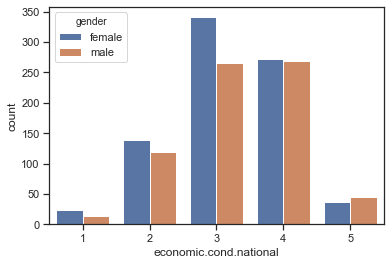

count plot of economic.cond.household


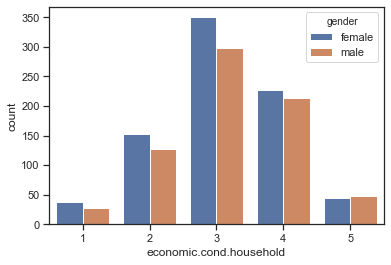

count plot of Europe


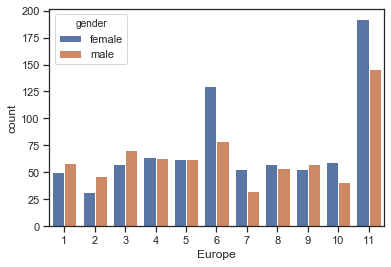

count plot of political.knowledge


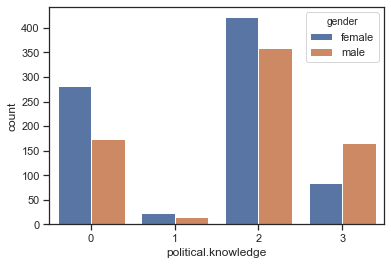

In [42]:
cat=['vote','gender','Blair','Hague','economic.cond.national','economic.cond.household','Europe','political.knowledge']
for i in range(len(cat)):
    ax =sns.countplot(x=cat[i],hue='gender',
    data=df)
    
    
     
    # giving labels to x-axis and y-axis 
    

    # giving title to the plot 
    plt.title(print('count plot of'+' ' +cat[i])); 

    # function to show plot 
    plt.show()




In [43]:
df.columns

Index(['vote', 'age', 'economic.cond.national', 'economic.cond.household',
       'Blair', 'Hague', 'Europe', 'political.knowledge', 'gender'],
      dtype='object')

In [44]:
df['age']=df['age'].astype('int64')
df['economic.cond.national']=df['economic.cond.national'].astype('int64')
df['economic.cond.household']=df['economic.cond.household'].astype('int64')
df['Blair']=df['Blair'].astype('int64')
df['Hague']=df['Hague'].astype('int64')
df['Europe']=df['Europe'].astype('int64')
df['political.knowledge']=df['political.knowledge'].astype('int64')

In [45]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1525 entries, 0 to 1524
Data columns (total 9 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   vote                     1525 non-null   object
 1   age                      1525 non-null   int64 
 2   economic.cond.national   1525 non-null   int64 
 3   economic.cond.household  1525 non-null   int64 
 4   Blair                    1525 non-null   int64 
 5   Hague                    1525 non-null   int64 
 6   Europe                   1525 non-null   int64 
 7   political.knowledge      1525 non-null   int64 
 8   gender                   1525 non-null   object
dtypes: int64(7), object(2)
memory usage: 107.4+ KB


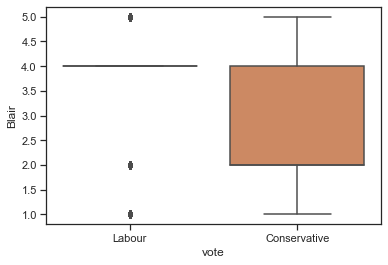

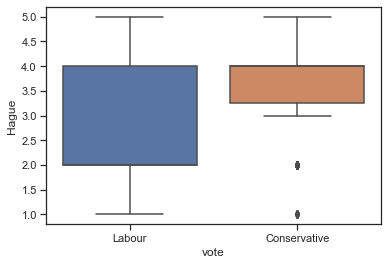

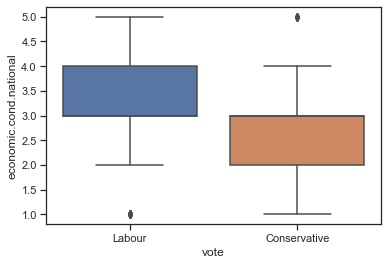

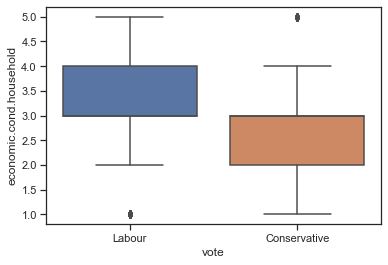

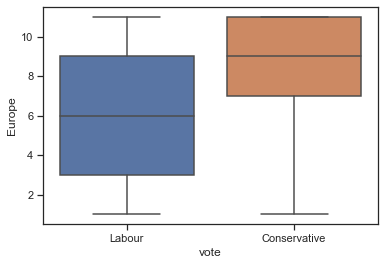

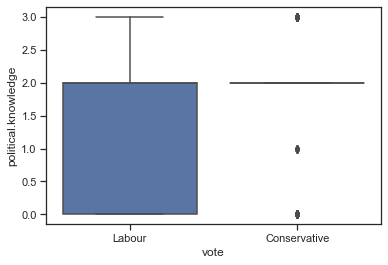

In [47]:
cat=['Blair','Hague','economic.cond.national','economic.cond.household','Europe','political.knowledge']
for i in range(len(cat)):
    sns.boxplot(x="vote", 
    y=cat[i],
    
    data=df)
    plt.show()

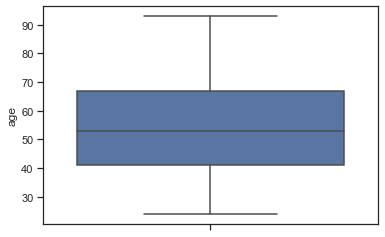

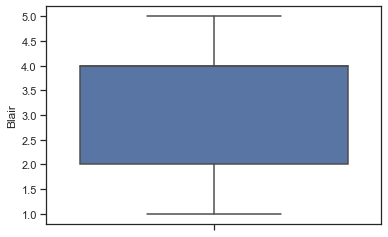

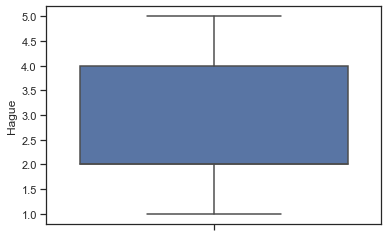

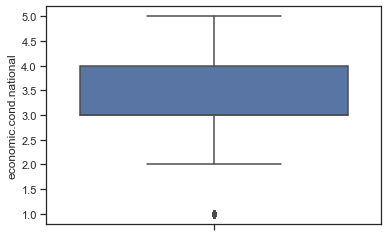

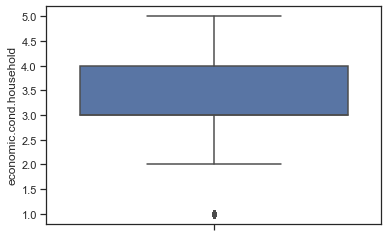

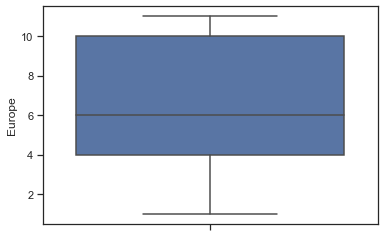

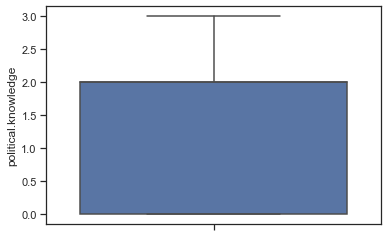

In [48]:
cat=['age','Blair','Hague','economic.cond.national','economic.cond.household','Europe','political.knowledge']
for i in range(len(cat)):
    sns.boxplot(x=cat[i], 
    orient='v',

    data=df)
    plt.show()

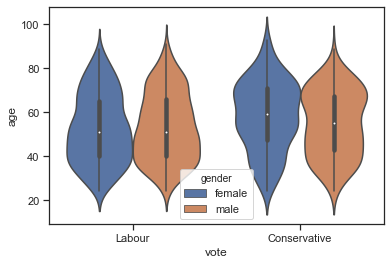

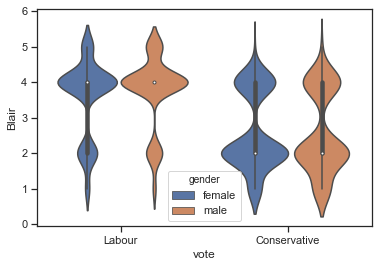

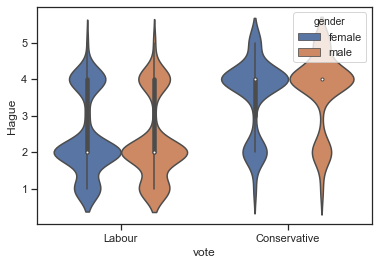

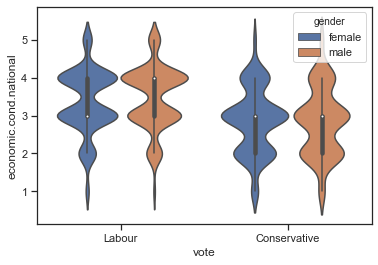

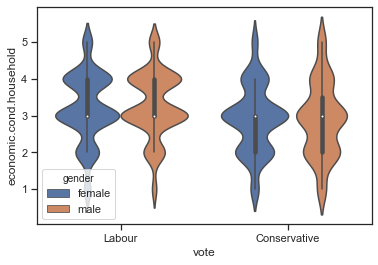

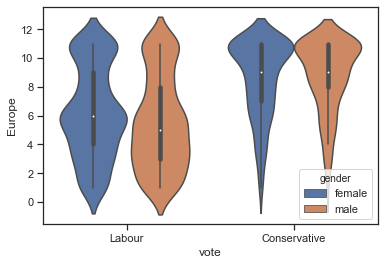

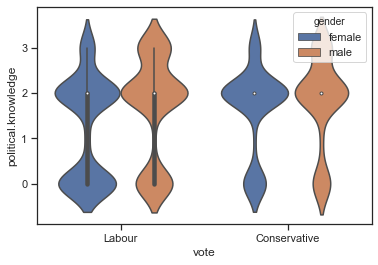

In [49]:
cat=['age','Blair','Hague','economic.cond.national','economic.cond.household','Europe','political.knowledge']
for i in range(len(cat)):
    sns.violinplot(x="vote",
    y=cat[i],
    hue="gender",
    data=df)
    plt.show()
                   

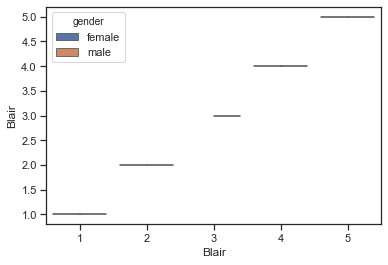

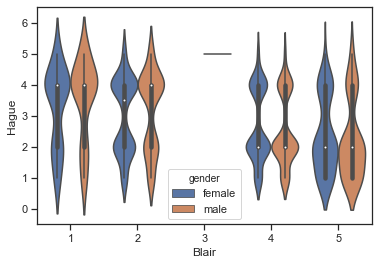

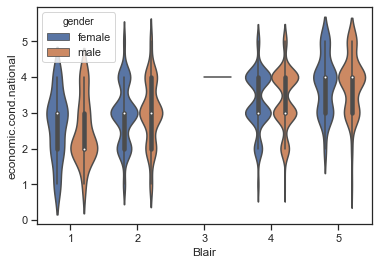

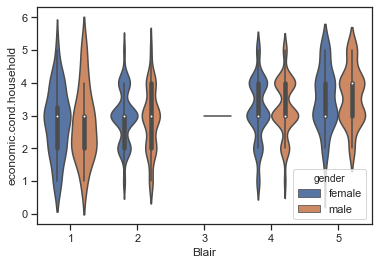

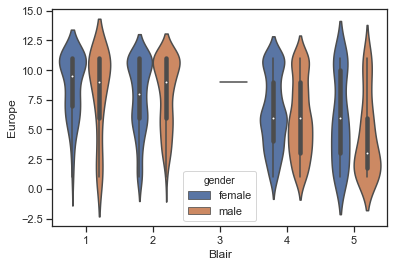

...

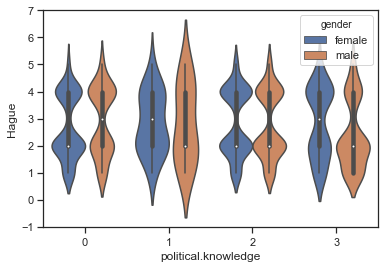

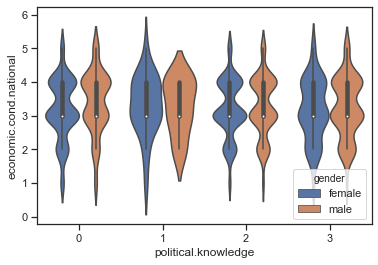

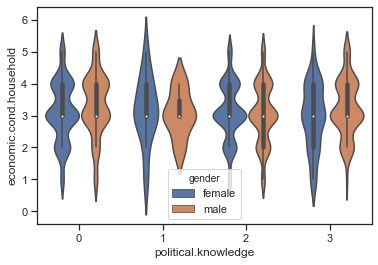

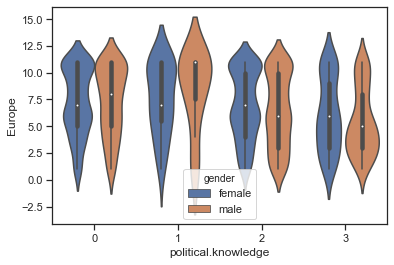

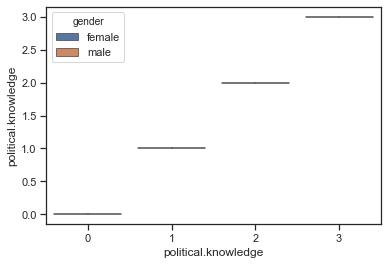

In [51]:
cat=['Blair','Hague','economic.cond.national','economic.cond.household','Europe','political.knowledge']
for i in range(len(cat)):
    
    for j in range(len(cat)):
        sns.violinplot(x=cat[i],
         y=cat[j],
        hue="gender",
        data=df,
        
        )
        plt.show()
        

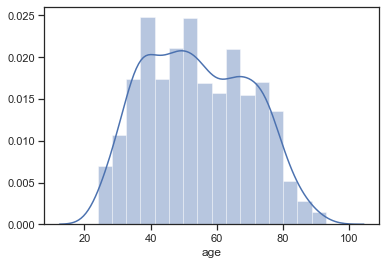

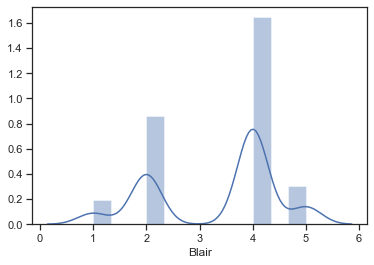

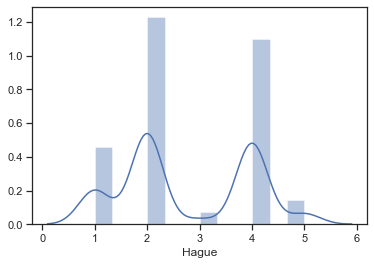

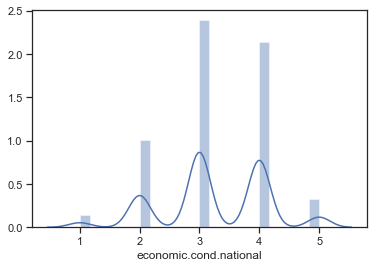

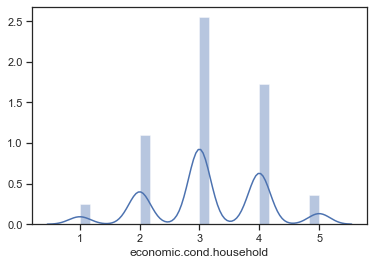

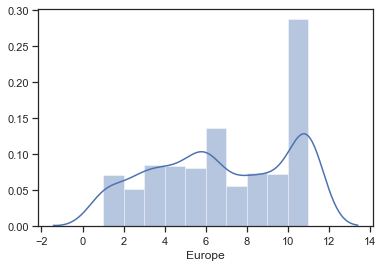

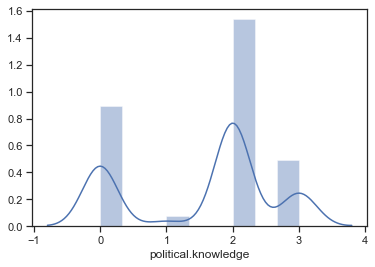

In [52]:
cat=['age','Blair','Hague','economic.cond.national','economic.cond.household','Europe','political.knowledge']
for i in range(len(cat)):
    sns.distplot(df[cat[i]],
    kde=True,
    
    color="b")
    plt.show()

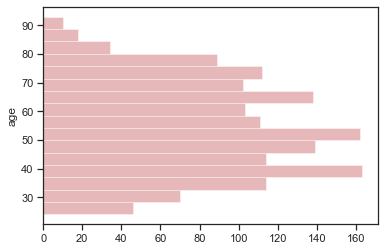

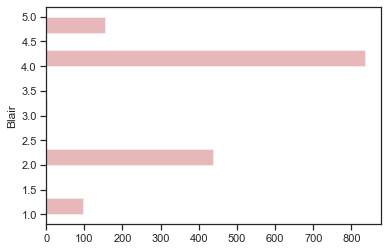

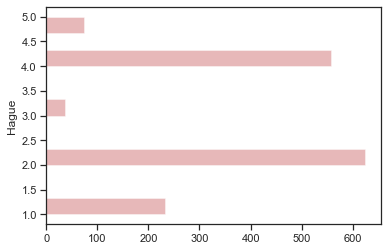

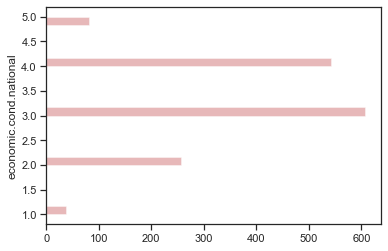

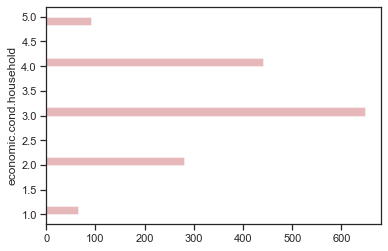

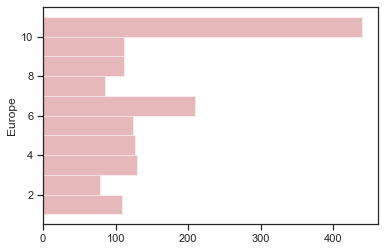

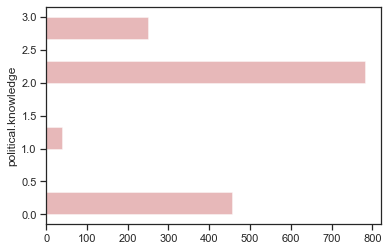

In [53]:

cat=['age','Blair','Hague','economic.cond.national','economic.cond.household','Europe','political.knowledge']
color=["g","b","y"]
for i in range(len(cat)):
    sns.distplot(df[cat[i]],
    kde=False,
    vertical=True,
    label="frequency distribution",
    color=['r'])
    plt.show()

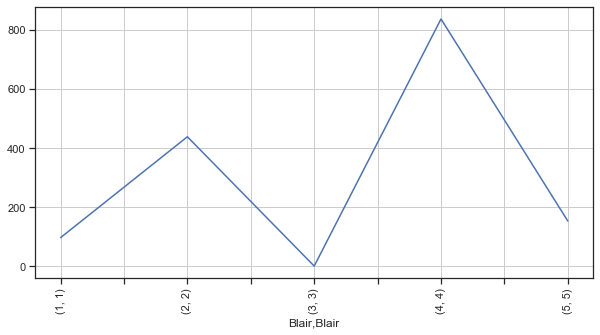

Blair  Blair
1      1         97
2      2        438
3      3          1
4      4        836
5      5        153
Name: Blair, dtype: int64


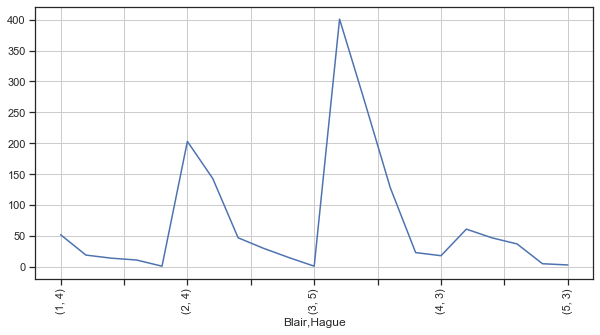

Blair  Hague
1      4         52
       2         19
       5         14
       1         11
       3          1
2      4        203
       2        143
       1         47
       5         30
       3         15
3      5          1
4      2        401
       4        266
       1        128
       5         23
       3         18
5      2         61
       1         47
       4         37
       5          5
       3          3
Name: Hague, dtype: int64


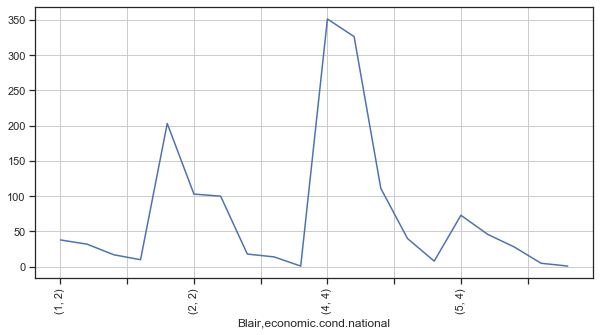

Blair  economic.cond.national
1      2                          38
       3                          32
       4                          17
       1                          10
2      3                         203
       2                         103
       4                         100
       1                          18
       5                          14
3      4                           1
4      4                         351
       3                         326
       2                         111
       5                          40
       1                           8
5      4                          73
       3                          46
       5                          28
       2                           5
       1                           1
Name: economic.cond.national, dtype: int64


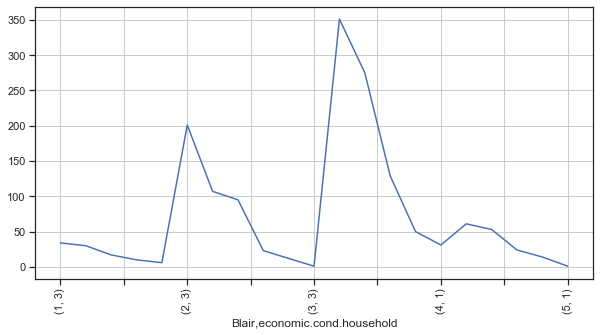

Blair  economic.cond.household
1      3                           34
       2                           30
       4                           17
       1                           10
       5                            6
2      3                          201
       2                          107
       4                           95
       1                           23
       5                           12
3      3                            1
4      3                          351
       4                          275
       2                          129
       5                           50
       1                           31
5      3                           61
       4                           53
       5                           24
       2                           14
       1                            1
Name: economic.cond.household, dtype: int64


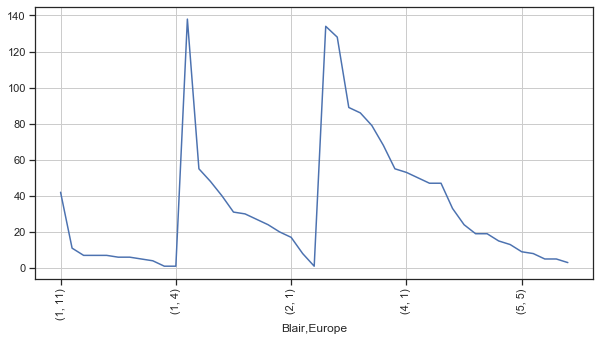

Blair  Europe
1      11         42
       8          11
       6           7
       7           7
       9           7
       1           6
       10          6
       5           5
       3           4
       2           1
       4           1
2      11        138
       6          55
       9          48
       10         40
       5          31
       8          30
       7          27
       4          24
       3          20
       1          17
       2           8
3      9           1
4      11        134
       6         128
       4          89
       3          86
       5          79
       8          68
       2          55
       1          53
       10         50
       7          47
       9          47
5      1          33
       11         24
       3          19
       6          19
       2          15
       4          13
       5           9
       9           8
       7           5
       10          5
       8           3
Name: Europe, dtype: int64


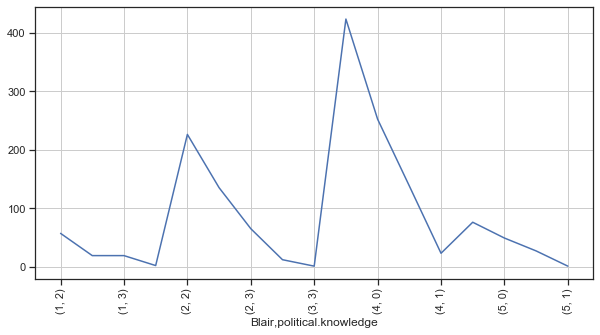

Blair  political.knowledge
1      2                       57
       0                       19
       3                       19
       1                        2
2      2                      226
       0                      135
       3                       65
       1                       12
3      3                        1
4      2                      423
       0                      252
       3                      138
       1                       23
5      2                       76
       0                       49
       3                       27
       1                        1
Name: political.knowledge, dtype: int64


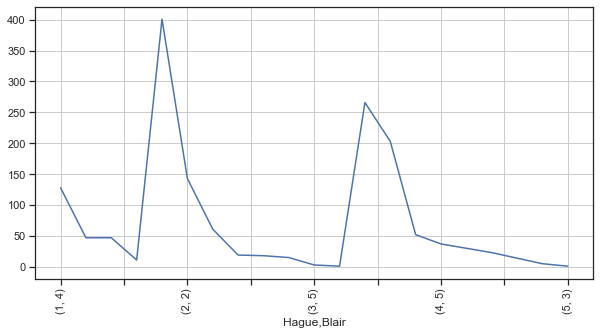

Hague  Blair
1      4        128
       2         47
       5         47
       1         11
2      4        401
       2        143
       5         61
       1         19
3      4         18
       2         15
       5          3
       1          1
4      4        266
       2        203
       1         52
       5         37
5      2         30
       4         23
       1         14
       5          5
       3          1
Name: Blair, dtype: int64


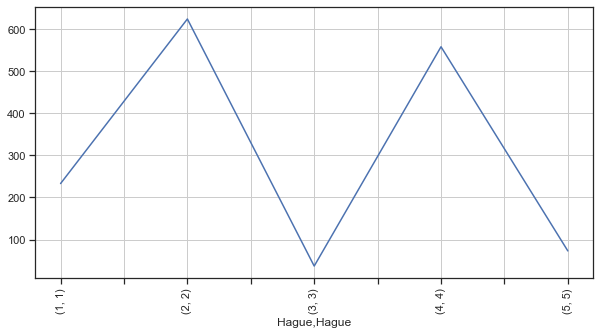

Hague  Hague
1      1        233
2      2        624
3      3         37
4      4        558
5      5         73
Name: Hague, dtype: int64


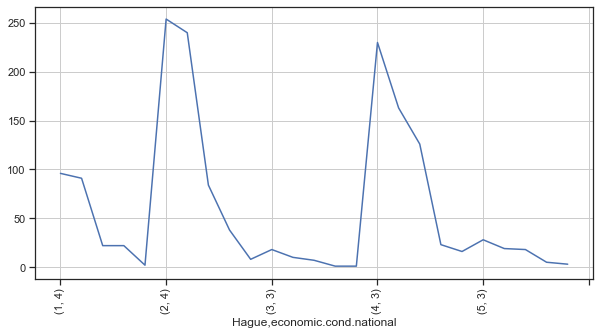

Hague  economic.cond.national
1      4                          96
       3                          91
       2                          22
       5                          22
       1                           2
2      4                         254
       3                         240
       2                          84
       5                          38
       1                           8
3      3                          18
       4                          10
       2                           7
       1                           1
       5                           1
4      3                         230
       4                         163
       2                         126
       1                          23
       5                          16
5      3                          28
       4                          19
       2                          18
       5                           5
       1                           3
Name: economic.cond.national, dtype: int64


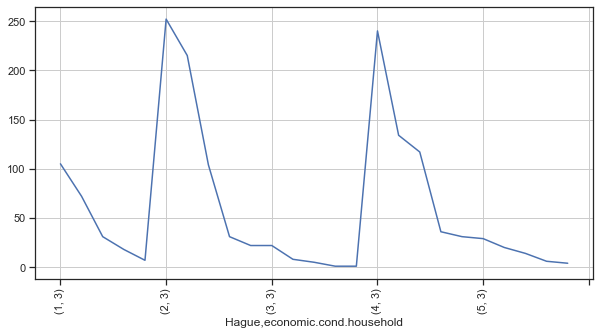

Hague  economic.cond.household
1      3                          105
       4                           72
       2                           31
       5                           18
       1                            7
2      3                          252
       4                          215
       2                          104
       5                           31
       1                           22
3      3                           22
       2                            8
       4                            5
       1                            1
       5                            1
4      3                          240
       4                          134
       2                          117
       5                           36
       1                           31
5      3                           29
       2                           20
       4                           14
       5                            6
       1                            4
Name: economic.cond

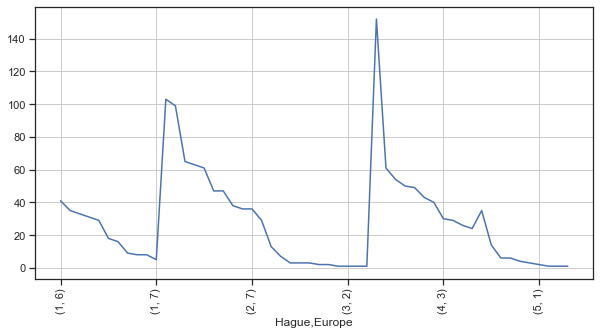

Hague  Europe
1      6          41
       11         35
       1          33
       3          31
       4          29
       2          18
       5          16
       10          9
       8           8
       9           8
       7           5
2      11        103
       6          99
       4          65
       3          63
       5          61
       1          47
       8          47
       9          38
       2          36
       7          36
       10         29
3      11         13
       6           7
       4           3
       5           3
       10          3
       3           2
       9           2
       1           1
       2           1
       7           1
       8           1
4      11        152
       6          61
       10         54
       8          50
       9          49
       5          43
       7          40
       3          30
       4          29
       1          26
       2          24
5      11         35
       9          14
       8           6

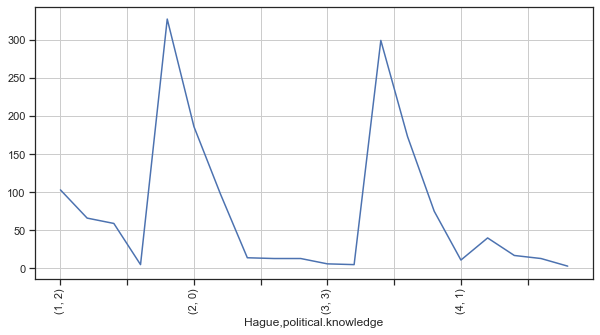

Hague  political.knowledge
1      2                      103
       0                       66
       3                       59
       1                        5
2      2                      327
       0                      186
       3                       97
       1                       14
3      0                       13
       2                       13
       3                        6
       1                        5
4      2                      299
       0                      173
       3                       75
       1                       11
5      2                       40
       0                       17
       3                       13
       1                        3
Name: political.knowledge, dtype: int64


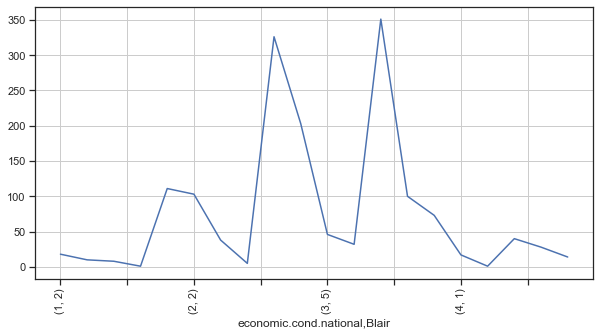

economic.cond.national  Blair
1                       2         18
                        1         10
                        4          8
                        5          1
2                       4        111
                        2        103
                        1         38
                        5          5
3                       4        326
                        2        203
                        5         46
                        1         32
4                       4        351
                        2        100
                        5         73
                        1         17
                        3          1
5                       4         40
                        5         28
                        2         14
Name: Blair, dtype: int64


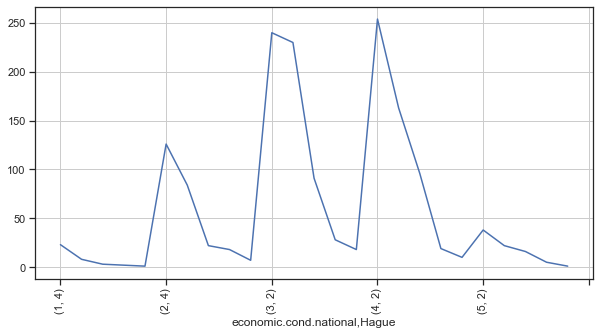

economic.cond.national  Hague
1                       4         23
                        2          8
                        5          3
                        1          2
                        3          1
2                       4        126
                        2         84
                        1         22
                        5         18
                        3          7
3                       2        240
                        4        230
                        1         91
                        5         28
                        3         18
4                       2        254
                        4        163
                        1         96
                        5         19
                        3         10
5                       2         38
                        1         22
                        4         16
                        5          5
                        3          1
Name: Hague, dtype: int64


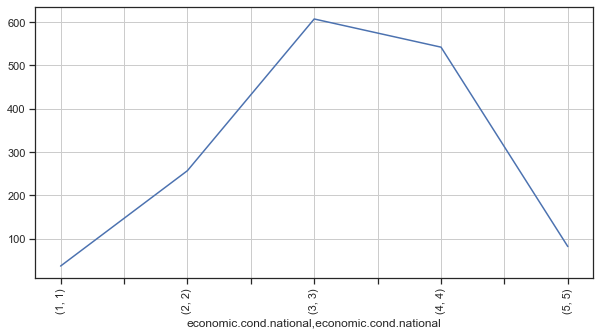

economic.cond.national  economic.cond.national
1                       1                          37
2                       2                         257
3                       3                         607
4                       4                         542
5                       5                          82
Name: economic.cond.national, dtype: int64


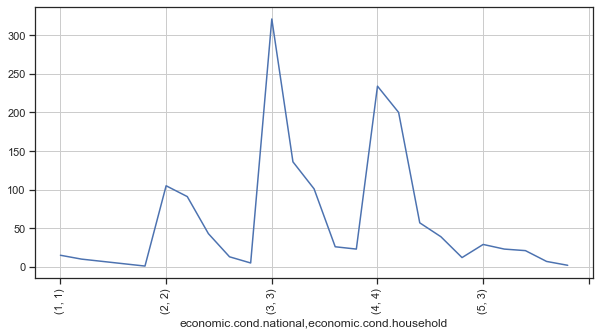

economic.cond.national  economic.cond.household
1                       1                           15
                        2                           10
                        3                            7
                        4                            4
                        5                            1
2                       2                          105
                        3                           91
                        4                           43
                        1                           13
                        5                            5
3                       3                          321
                        4                          136
                        2                          101
                        5                           26
                        1                           23
4                       4                          234
                        3                          200
                 

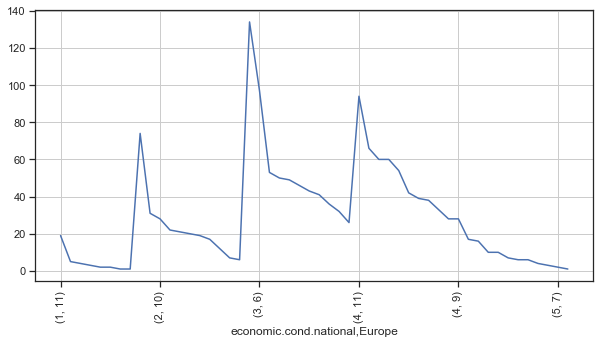

economic.cond.national  Europe
1                       11         19
                        6           5
                        8           4
                        9           3
                        1           2
                        10          2
                        3           1
                        7           1
2                       11         74
                        6          31
                        10         28
                        8          22
                        9          21
                        5          20
                        7          19
                        4          17
                        3          12
                        2           7
                        1           6
3                       11        134
                        6          97
                        9          53
                        3          50
                        8          49
                        4          46
                   

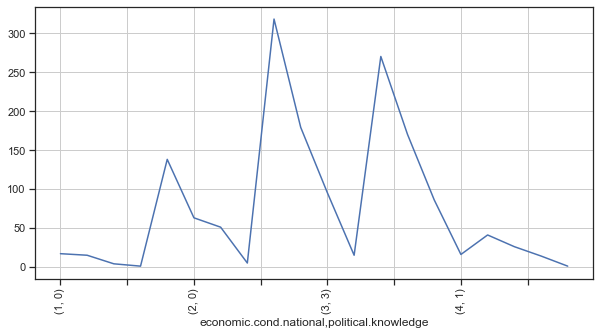

economic.cond.national  political.knowledge
1                       0                       17
                        2                       15
                        3                        4
                        1                        1
2                       2                      138
                        0                       63
                        3                       51
                        1                        5
3                       2                      318
                        0                      179
                        3                       95
                        1                       15
4                       2                      270
                        0                      170
                        3                       86
                        1                       16
5                       2                       41
                        0                       26
                        3             

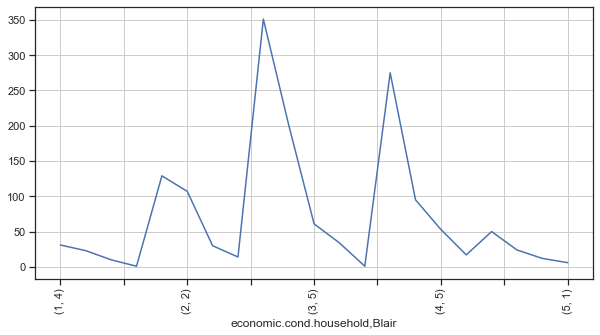

economic.cond.household  Blair
1                        4         31
                         2         23
                         1         10
                         5          1
2                        4        129
                         2        107
                         1         30
                         5         14
3                        4        351
                         2        201
                         5         61
                         1         34
                         3          1
4                        4        275
                         2         95
                         5         53
                         1         17
5                        4         50
                         5         24
                         2         12
                         1          6
Name: Blair, dtype: int64


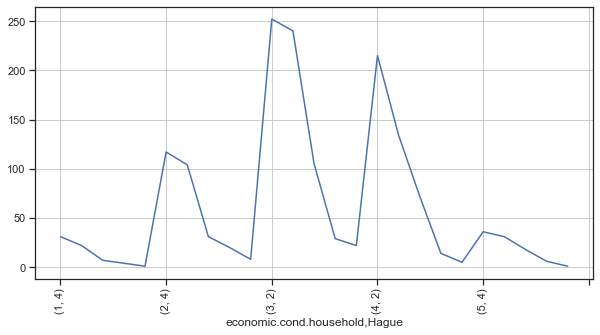

economic.cond.household  Hague
1                        4         31
                         2         22
                         1          7
                         5          4
                         3          1
2                        4        117
                         2        104
                         1         31
                         5         20
                         3          8
3                        2        252
                         4        240
                         1        105
                         5         29
                         3         22
4                        2        215
                         4        134
                         1         72
                         5         14
                         3          5
5                        4         36
                         2         31
                         1         18
                         5          6
                         3          1
Name: Hague, dtype:

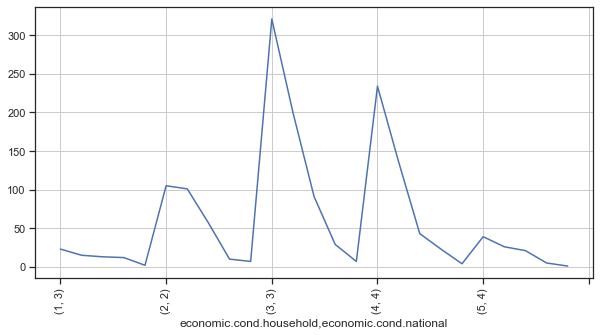

economic.cond.household  economic.cond.national
1                        3                          23
                         1                          15
                         2                          13
                         4                          12
                         5                           2
2                        2                         105
                         3                         101
                         4                          57
                         1                          10
                         5                           7
3                        3                         321
                         4                         200
                         2                          91
                         5                          29
                         1                           7
4                        4                         234
                         3                         136
                 

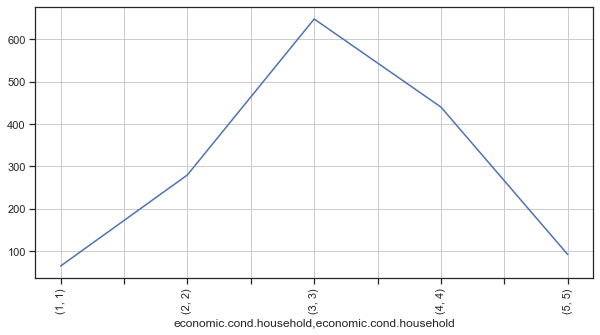

economic.cond.household  economic.cond.household
1                        1                           65
2                        2                          280
3                        3                          648
4                        4                          440
5                        5                           92
Name: economic.cond.household, dtype: int64


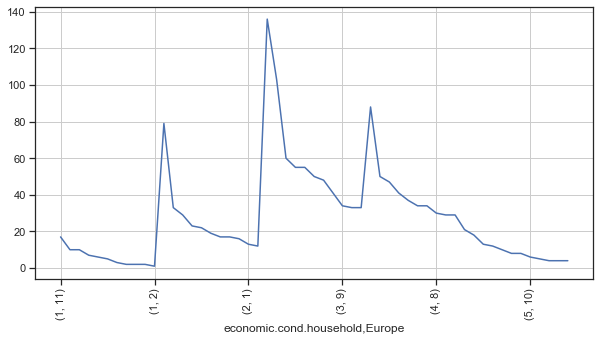

economic.cond.household  Europe
1                        11         17
                         6          10
                         9          10
                         8           7
                         4           6
                         7           5
                         3           3
                         1           2
                         5           2
                         10          2
                         2           1
2                        11         79
                         6          33
                         9          29
                         10         23
                         7          22
                         4          19
                         5          17
                         8          17
                         3          16
                         1          13
                         2          12
3                        11        136
                         6         103
                         5      

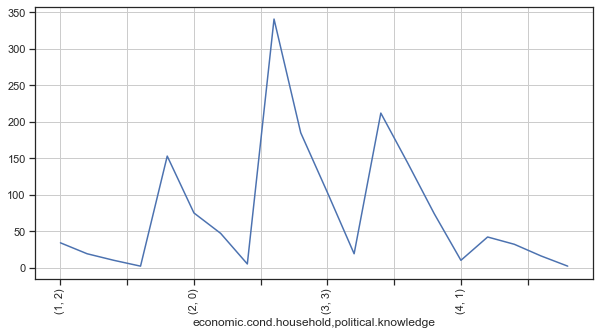

economic.cond.household  political.knowledge
1                        2                       34
                         0                       19
                         3                       10
                         1                        2
2                        2                      153
                         0                       75
                         3                       47
                         1                        5
3                        2                      341
                         0                      185
                         3                      103
                         1                       19
4                        2                      212
                         0                      144
                         3                       74
                         1                       10
5                        2                       42
                         0                       32
                   

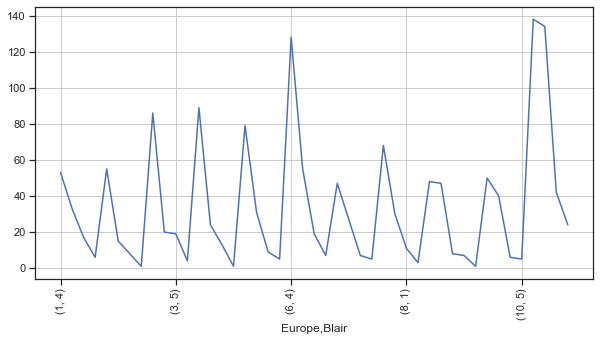

Europe  Blair
1       4         53
        5         33
        2         17
        1          6
2       4         55
        5         15
        2          8
        1          1
3       4         86
        2         20
        5         19
        1          4
4       4         89
        2         24
        5         13
        1          1
5       4         79
        2         31
        5          9
        1          5
6       4        128
        2         55
        5         19
        1          7
7       4         47
        2         27
        1          7
        5          5
8       4         68
        2         30
        1         11
        5          3
9       2         48
        4         47
        5          8
        1          7
        3          1
10      4         50
        2         40
        1          6
        5          5
11      2        138
        4        134
        1         42
        5         24
Name: Blair, dtype: int64


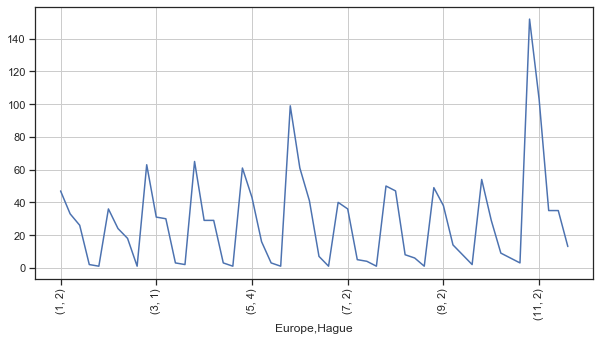

Europe  Hague
1       2         47
        1         33
        4         26
        5          2
        3          1
2       2         36
        4         24
        1         18
        3          1
3       2         63
        1         31
        4         30
        5          3
        3          2
4       2         65
        1         29
        4         29
        3          3
        5          1
5       2         61
        4         43
        1         16
        3          3
        5          1
6       2         99
        4         61
        1         41
        3          7
        5          1
7       4         40
        2         36
        1          5
        5          4
        3          1
8       4         50
        2         47
        1          8
        5          6
        3          1
9       4         49
        2         38
        5         14
        1          8
        3          2
10      4         54
        2         29
        1          9

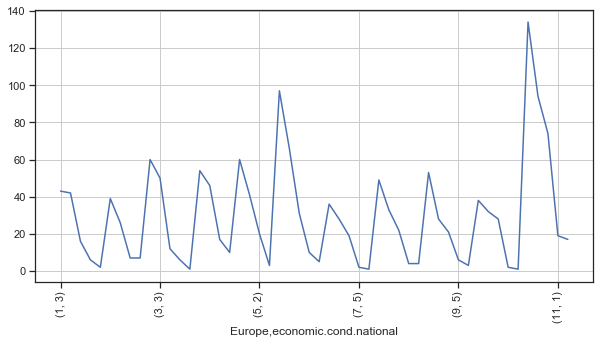

Europe  economic.cond.national
1       3                          43
        4                          42
        5                          16
        2                           6
        1                           2
2       4                          39
        3                          26
        2                           7
        5                           7
3       4                          60
        3                          50
        2                          12
        5                           6
        1                           1
4       4                          54
        3                          46
        2                          17
        5                          10
5       4                          60
        3                          41
        2                          20
        5                           3
6       3                          97
        4                          66
        2                          31
        5          

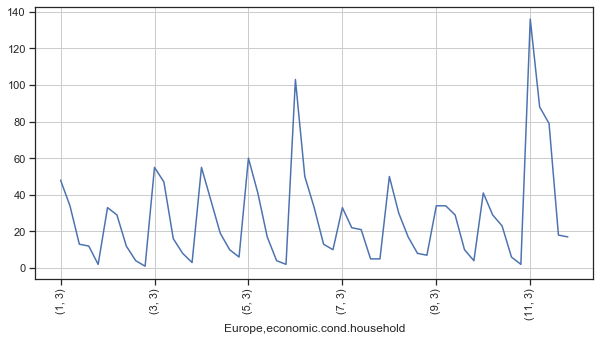

Europe  economic.cond.household
1       3                           48
        4                           34
        2                           13
        5                           12
        1                            2
2       3                           33
        4                           29
        2                           12
        5                            4
        1                            1
3       3                           55
        4                           47
        2                           16
        5                            8
        1                            3
4       3                           55
        4                           37
        2                           19
        5                           10
        1                            6
5       3                           60
        4                           41
        2                           17
        5                            4
        1                       

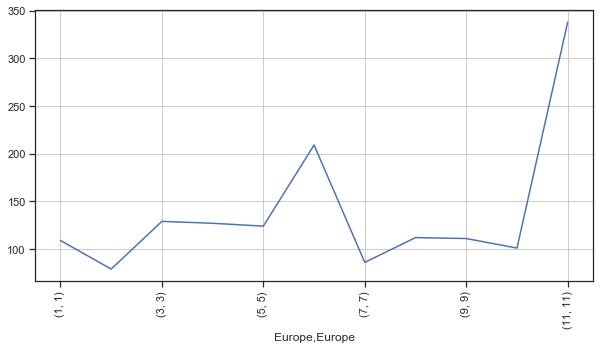

Europe  Europe
1       1         109
2       2          79
3       3         129
4       4         127
5       5         124
6       6         209
7       7          86
8       8         112
9       9         111
10      10        101
11      11        338
Name: Europe, dtype: int64


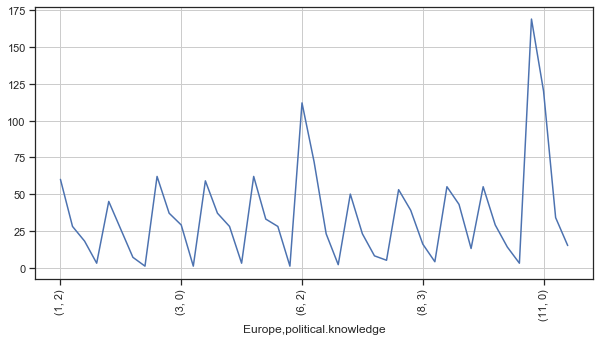

Europe  political.knowledge
1       2                       60
        0                       28
        3                       18
        1                        3
2       2                       45
        3                       26
        0                        7
        1                        1
3       2                       62
        3                       37
        0                       29
        1                        1
4       2                       59
        0                       37
        3                       28
        1                        3
5       2                       62
        3                       33
        0                       28
        1                        1
6       2                      112
        0                       72
        3                       23
        1                        2
7       2                       50
        0                       23
        3                        8
        1                  

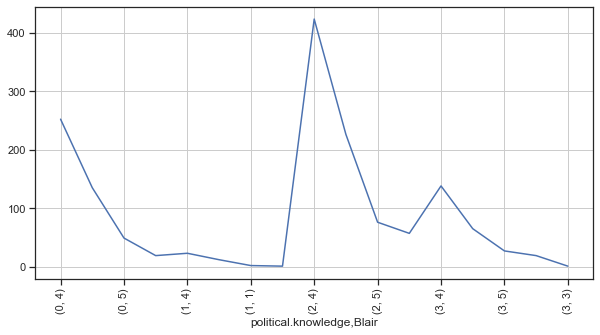

political.knowledge  Blair
0                    4        252
                     2        135
                     5         49
                     1         19
1                    4         23
                     2         12
                     1          2
                     5          1
2                    4        423
                     2        226
                     5         76
                     1         57
3                    4        138
                     2         65
                     5         27
                     1         19
                     3          1
Name: Blair, dtype: int64


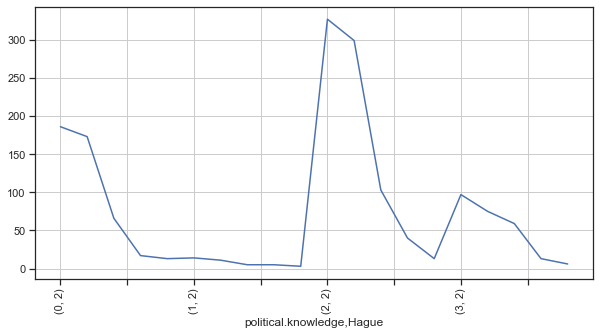

political.knowledge  Hague
0                    2        186
                     4        173
                     1         66
                     5         17
                     3         13
1                    2         14
                     4         11
                     1          5
                     3          5
                     5          3
2                    2        327
                     4        299
                     1        103
                     5         40
                     3         13
3                    2         97
                     4         75
                     1         59
                     5         13
                     3          6
Name: Hague, dtype: int64


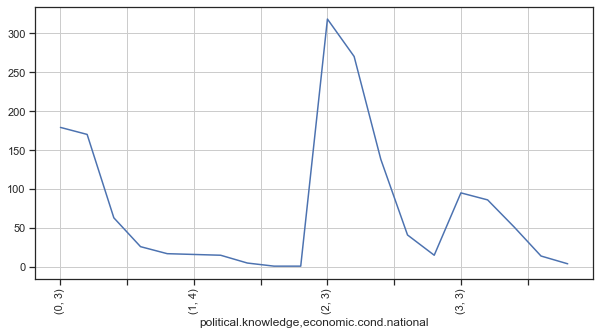

political.knowledge  economic.cond.national
0                    3                         179
                     4                         170
                     2                          63
                     5                          26
                     1                          17
1                    4                          16
                     3                          15
                     2                           5
                     1                           1
                     5                           1
2                    3                         318
                     4                         270
                     2                         138
                     5                          41
                     1                          15
3                    3                          95
                     4                          86
                     2                          51
                     5                

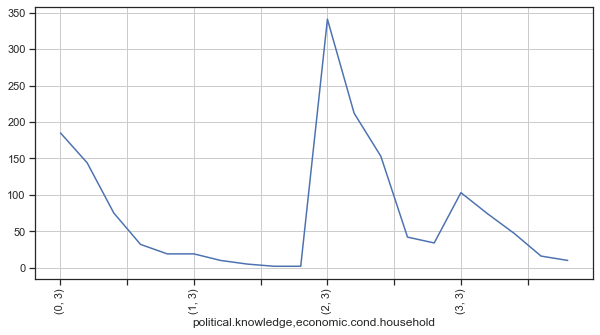

political.knowledge  economic.cond.household
0                    3                          185
                     4                          144
                     2                           75
                     5                           32
                     1                           19
1                    3                           19
                     4                           10
                     2                            5
                     1                            2
                     5                            2
2                    3                          341
                     4                          212
                     2                          153
                     5                           42
                     1                           34
3                    3                          103
                     4                           74
                     2                           47
                   

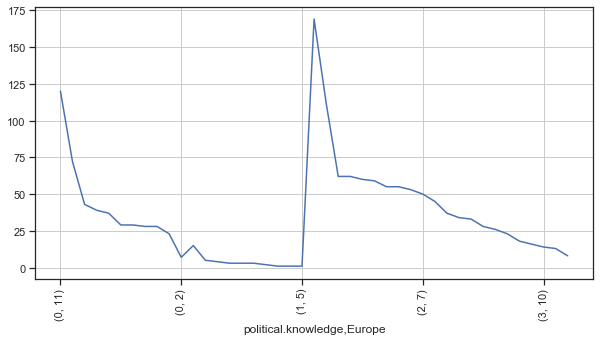

political.knowledge  Europe
0                    11        120
                     6          72
                     9          43
                     8          39
                     4          37
                     3          29
                     10         29
                     1          28
                     5          28
                     7          23
                     2           7
1                    11         15
                     7           5
                     8           4
                     1           3
                     4           3
                     10          3
                     6           2
                     2           1
                     3           1
                     5           1
2                    11        169
                     6         112
                     3          62
                     5          62
                     1          60
                     4          59
                     9     

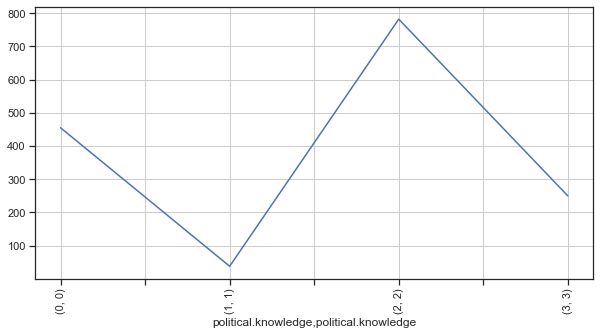

political.knowledge  political.knowledge
0                    0                      455
1                    1                       38
2                    2                      782
3                    3                      250
Name: political.knowledge, dtype: int64


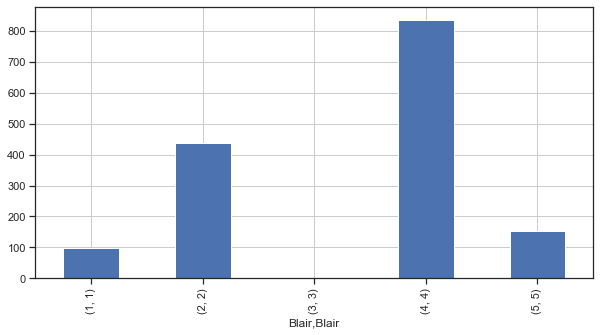

Blair  Blair
1      1         97
2      2        438
3      3          1
4      4        836
5      5        153
Name: Blair, dtype: int64


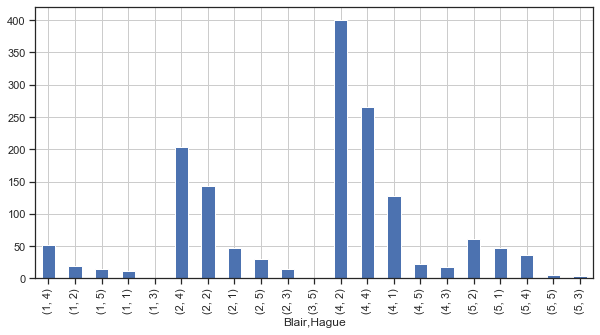

Blair  Hague
1      4         52
       2         19
       5         14
       1         11
       3          1
2      4        203
       2        143
       1         47
       5         30
       3         15
3      5          1
4      2        401
       4        266
       1        128
       5         23
       3         18
5      2         61
       1         47
       4         37
       5          5
       3          3
Name: Hague, dtype: int64


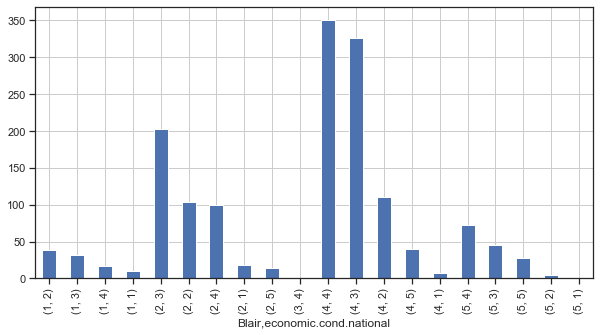

Blair  economic.cond.national
1      2                          38
       3                          32
       4                          17
       1                          10
2      3                         203
       2                         103
       4                         100
       1                          18
       5                          14
3      4                           1
4      4                         351
       3                         326
       2                         111
       5                          40
       1                           8
5      4                          73
       3                          46
       5                          28
       2                           5
       1                           1
Name: economic.cond.national, dtype: int64


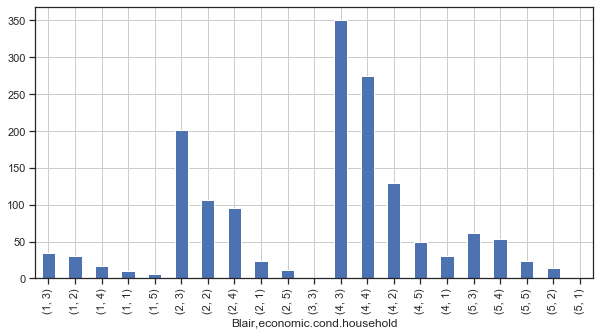

Blair  economic.cond.household
1      3                           34
       2                           30
       4                           17
       1                           10
       5                            6
2      3                          201
       2                          107
       4                           95
       1                           23
       5                           12
3      3                            1
4      3                          351
       4                          275
       2                          129
       5                           50
       1                           31
5      3                           61
       4                           53
       5                           24
       2                           14
       1                            1
Name: economic.cond.household, dtype: int64


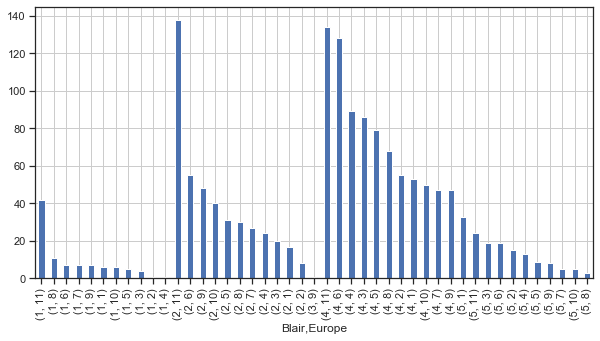

Blair  Europe
1      11         42
       8          11
       6           7
       7           7
       9           7
       1           6
       10          6
       5           5
       3           4
       2           1
       4           1
2      11        138
       6          55
       9          48
       10         40
       5          31
       8          30
       7          27
       4          24
       3          20
       1          17
       2           8
3      9           1
4      11        134
       6         128
       4          89
       3          86
       5          79
       8          68
       2          55
       1          53
       10         50
       7          47
       9          47
5      1          33
       11         24
       3          19
       6          19
       2          15
       4          13
       5           9
       9           8
       7           5
       10          5
       8           3
Name: Europe, dtype: int64


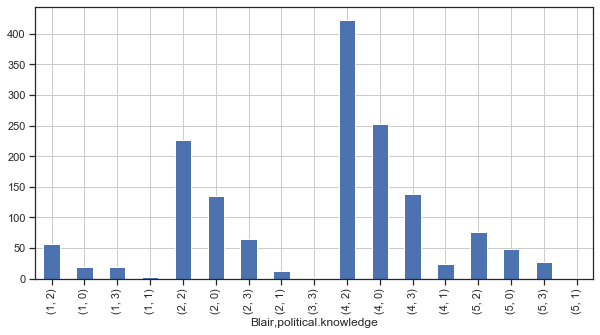

Blair  political.knowledge
1      2                       57
       0                       19
       3                       19
       1                        2
2      2                      226
       0                      135
       3                       65
       1                       12
3      3                        1
4      2                      423
       0                      252
       3                      138
       1                       23
5      2                       76
       0                       49
       3                       27
       1                        1
Name: political.knowledge, dtype: int64


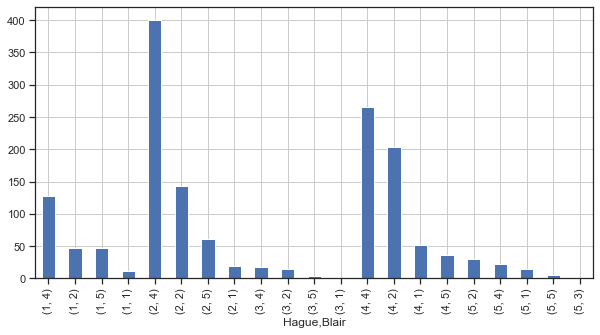

Hague  Blair
1      4        128
       2         47
       5         47
       1         11
2      4        401
       2        143
       5         61
       1         19
3      4         18
       2         15
       5          3
       1          1
4      4        266
       2        203
       1         52
       5         37
5      2         30
       4         23
       1         14
       5          5
       3          1
Name: Blair, dtype: int64


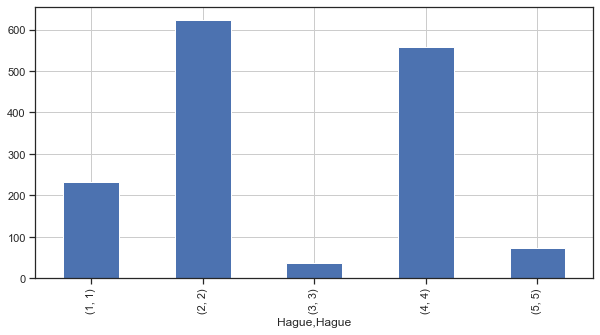

Hague  Hague
1      1        233
2      2        624
3      3         37
4      4        558
5      5         73
Name: Hague, dtype: int64


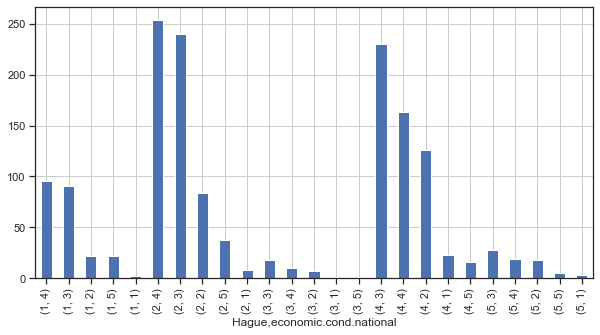

Hague  economic.cond.national
1      4                          96
       3                          91
       2                          22
       5                          22
       1                           2
2      4                         254
       3                         240
       2                          84
       5                          38
       1                           8
3      3                          18
       4                          10
       2                           7
       1                           1
       5                           1
4      3                         230
       4                         163
       2                         126
       1                          23
       5                          16
5      3                          28
       4                          19
       2                          18
       5                           5
       1                           3
Name: economic.cond.national, dtype: int64


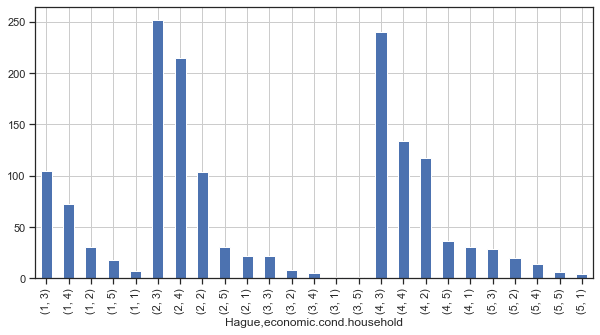

Hague  economic.cond.household
1      3                          105
       4                           72
       2                           31
       5                           18
       1                            7
2      3                          252
       4                          215
       2                          104
       5                           31
       1                           22
3      3                           22
       2                            8
       4                            5
       1                            1
       5                            1
4      3                          240
       4                          134
       2                          117
       5                           36
       1                           31
5      3                           29
       2                           20
       4                           14
       5                            6
       1                            4
Name: economic.cond

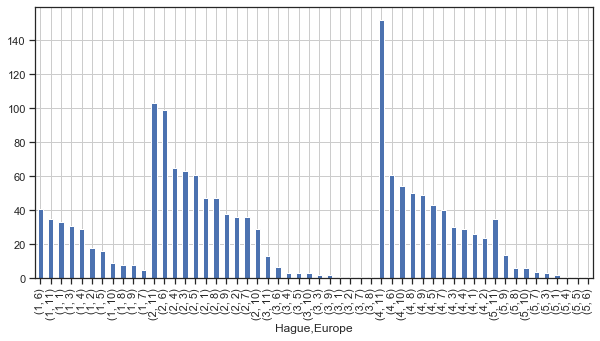

Hague  Europe
1      6          41
       11         35
       1          33
       3          31
       4          29
       2          18
       5          16
       10          9
       8           8
       9           8
       7           5
2      11        103
       6          99
       4          65
       3          63
       5          61
       1          47
       8          47
       9          38
       2          36
       7          36
       10         29
3      11         13
       6           7
       4           3
       5           3
       10          3
       3           2
       9           2
       1           1
       2           1
       7           1
       8           1
4      11        152
       6          61
       10         54
       8          50
       9          49
       5          43
       7          40
       3          30
       4          29
       1          26
       2          24
5      11         35
       9          14
       8           6

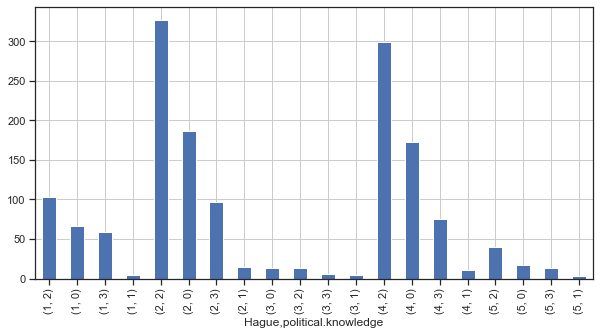

Hague  political.knowledge
1      2                      103
       0                       66
       3                       59
       1                        5
2      2                      327
       0                      186
       3                       97
       1                       14
3      0                       13
       2                       13
       3                        6
       1                        5
4      2                      299
       0                      173
       3                       75
       1                       11
5      2                       40
       0                       17
       3                       13
       1                        3
Name: political.knowledge, dtype: int64


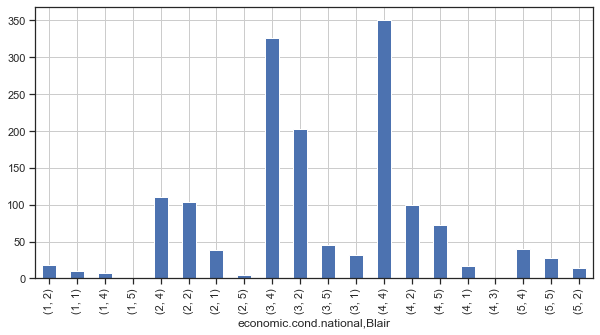

economic.cond.national  Blair
1                       2         18
                        1         10
                        4          8
                        5          1
2                       4        111
                        2        103
                        1         38
                        5          5
3                       4        326
                        2        203
                        5         46
                        1         32
4                       4        351
                        2        100
                        5         73
                        1         17
                        3          1
5                       4         40
                        5         28
                        2         14
Name: Blair, dtype: int64


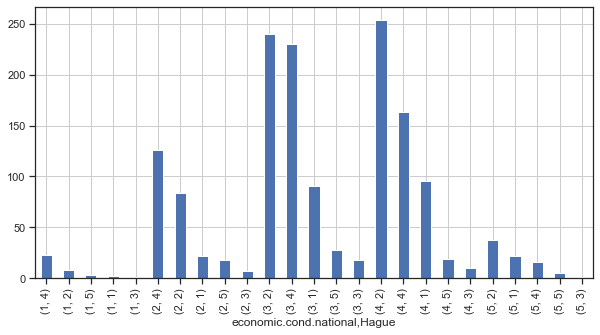

economic.cond.national  Hague
1                       4         23
                        2          8
                        5          3
                        1          2
                        3          1
2                       4        126
                        2         84
                        1         22
                        5         18
                        3          7
3                       2        240
                        4        230
                        1         91
                        5         28
                        3         18
4                       2        254
                        4        163
                        1         96
                        5         19
                        3         10
5                       2         38
                        1         22
                        4         16
                        5          5
                        3          1
Name: Hague, dtype: int64


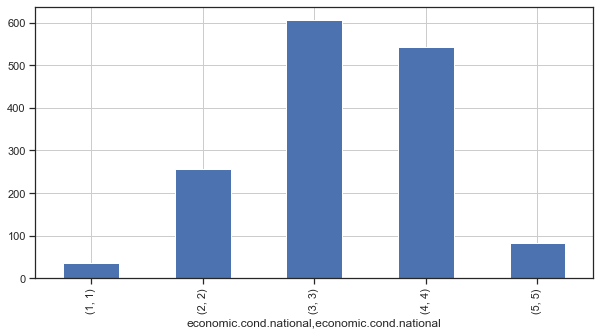

economic.cond.national  economic.cond.national
1                       1                          37
2                       2                         257
3                       3                         607
4                       4                         542
5                       5                          82
Name: economic.cond.national, dtype: int64


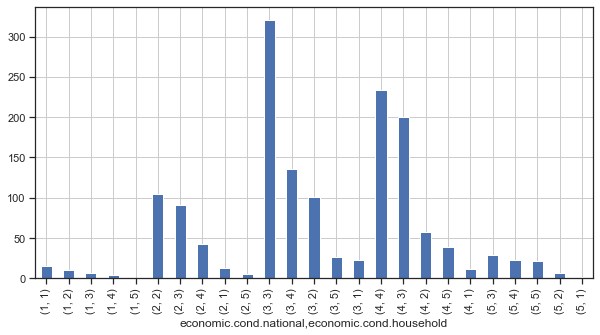

economic.cond.national  economic.cond.household
1                       1                           15
                        2                           10
                        3                            7
                        4                            4
                        5                            1
2                       2                          105
                        3                           91
                        4                           43
                        1                           13
                        5                            5
3                       3                          321
                        4                          136
                        2                          101
                        5                           26
                        1                           23
4                       4                          234
                        3                          200
                 

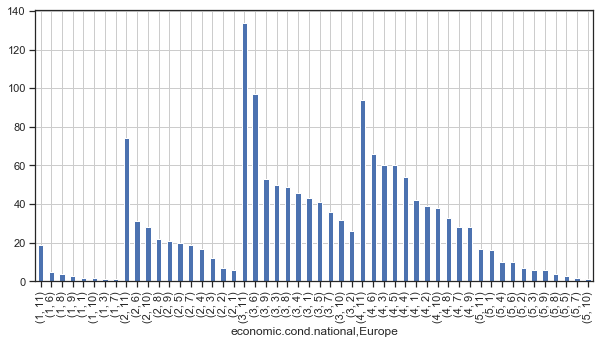

economic.cond.national  Europe
1                       11         19
                        6           5
                        8           4
                        9           3
                        1           2
                        10          2
                        3           1
                        7           1
2                       11         74
                        6          31
                        10         28
                        8          22
                        9          21
                        5          20
                        7          19
                        4          17
                        3          12
                        2           7
                        1           6
3                       11        134
                        6          97
                        9          53
                        3          50
                        8          49
                        4          46
                   

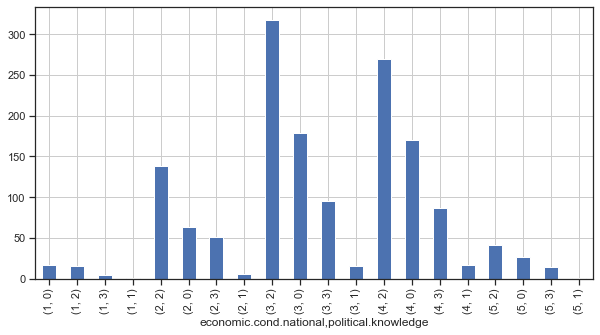

economic.cond.national  political.knowledge
1                       0                       17
                        2                       15
                        3                        4
                        1                        1
2                       2                      138
                        0                       63
                        3                       51
                        1                        5
3                       2                      318
                        0                      179
                        3                       95
                        1                       15
4                       2                      270
                        0                      170
                        3                       86
                        1                       16
5                       2                       41
                        0                       26
                        3             

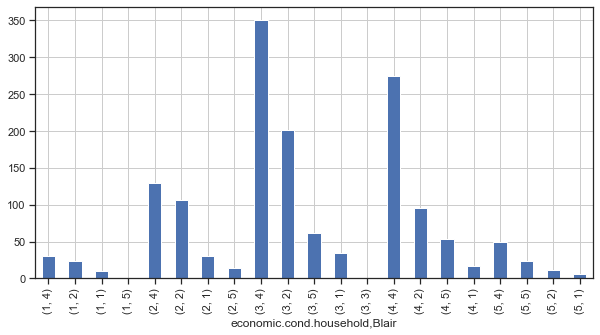

economic.cond.household  Blair
1                        4         31
                         2         23
                         1         10
                         5          1
2                        4        129
                         2        107
                         1         30
                         5         14
3                        4        351
                         2        201
                         5         61
                         1         34
                         3          1
4                        4        275
                         2         95
                         5         53
                         1         17
5                        4         50
                         5         24
                         2         12
                         1          6
Name: Blair, dtype: int64


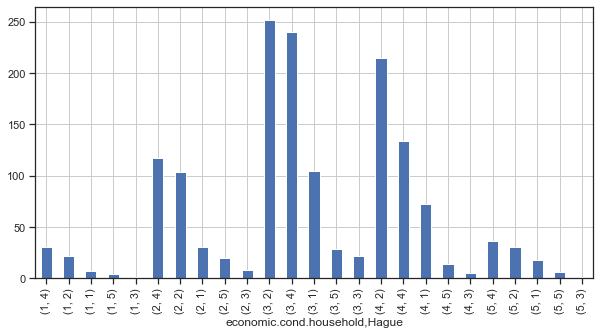

economic.cond.household  Hague
1                        4         31
                         2         22
                         1          7
                         5          4
                         3          1
2                        4        117
                         2        104
                         1         31
                         5         20
                         3          8
3                        2        252
                         4        240
                         1        105
                         5         29
                         3         22
4                        2        215
                         4        134
                         1         72
                         5         14
                         3          5
5                        4         36
                         2         31
                         1         18
                         5          6
                         3          1
Name: Hague, dtype:

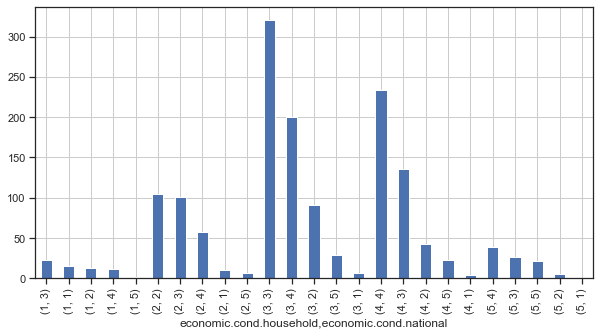

economic.cond.household  economic.cond.national
1                        3                          23
                         1                          15
                         2                          13
                         4                          12
                         5                           2
2                        2                         105
                         3                         101
                         4                          57
                         1                          10
                         5                           7
3                        3                         321
                         4                         200
                         2                          91
                         5                          29
                         1                           7
4                        4                         234
                         3                         136
                 

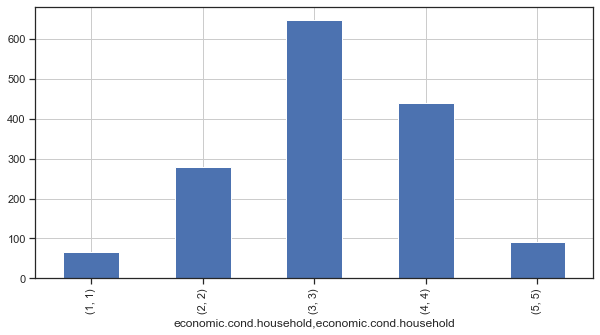

economic.cond.household  economic.cond.household
1                        1                           65
2                        2                          280
3                        3                          648
4                        4                          440
5                        5                           92
Name: economic.cond.household, dtype: int64


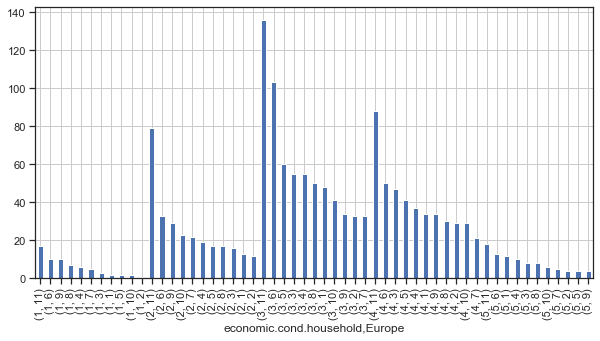

economic.cond.household  Europe
1                        11         17
                         6          10
                         9          10
                         8           7
                         4           6
                         7           5
                         3           3
                         1           2
                         5           2
                         10          2
                         2           1
2                        11         79
                         6          33
                         9          29
                         10         23
                         7          22
                         4          19
                         5          17
                         8          17
                         3          16
                         1          13
                         2          12
3                        11        136
                         6         103
                         5      

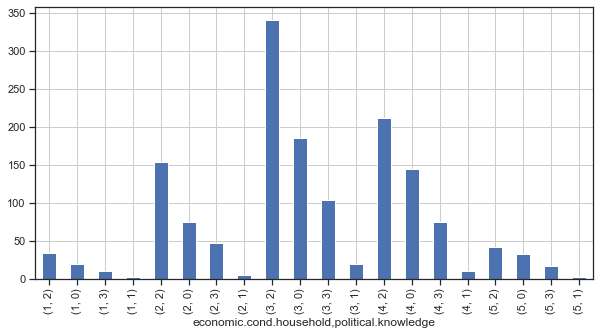

economic.cond.household  political.knowledge
1                        2                       34
                         0                       19
                         3                       10
                         1                        2
2                        2                      153
                         0                       75
                         3                       47
                         1                        5
3                        2                      341
                         0                      185
                         3                      103
                         1                       19
4                        2                      212
                         0                      144
                         3                       74
                         1                       10
5                        2                       42
                         0                       32
                   

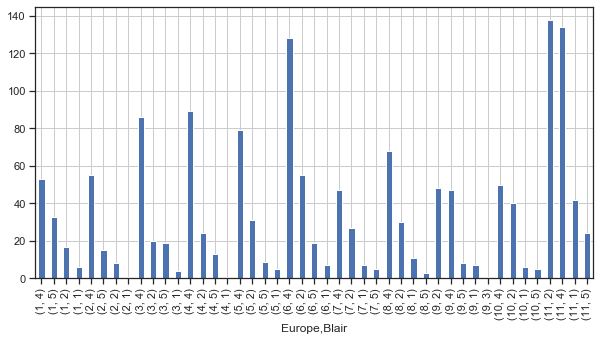

Europe  Blair
1       4         53
        5         33
        2         17
        1          6
2       4         55
        5         15
        2          8
        1          1
3       4         86
        2         20
        5         19
        1          4
4       4         89
        2         24
        5         13
        1          1
5       4         79
        2         31
        5          9
        1          5
6       4        128
        2         55
        5         19
        1          7
7       4         47
        2         27
        1          7
        5          5
8       4         68
        2         30
        1         11
        5          3
9       2         48
        4         47
        5          8
        1          7
        3          1
10      4         50
        2         40
        1          6
        5          5
11      2        138
        4        134
        1         42
        5         24
Name: Blair, dtype: int64


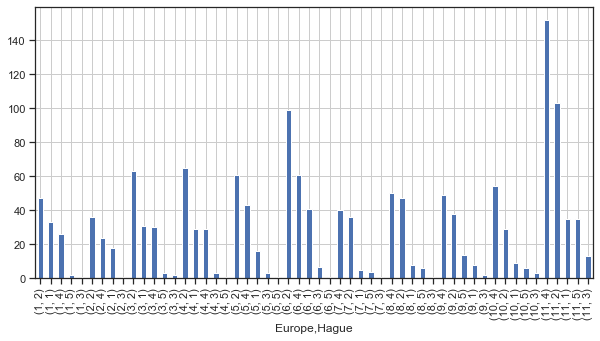

Europe  Hague
1       2         47
        1         33
        4         26
        5          2
        3          1
2       2         36
        4         24
        1         18
        3          1
3       2         63
        1         31
        4         30
        5          3
        3          2
4       2         65
        1         29
        4         29
        3          3
        5          1
5       2         61
        4         43
        1         16
        3          3
        5          1
6       2         99
        4         61
        1         41
        3          7
        5          1
7       4         40
        2         36
        1          5
        5          4
        3          1
8       4         50
        2         47
        1          8
        5          6
        3          1
9       4         49
        2         38
        5         14
        1          8
        3          2
10      4         54
        2         29
        1          9

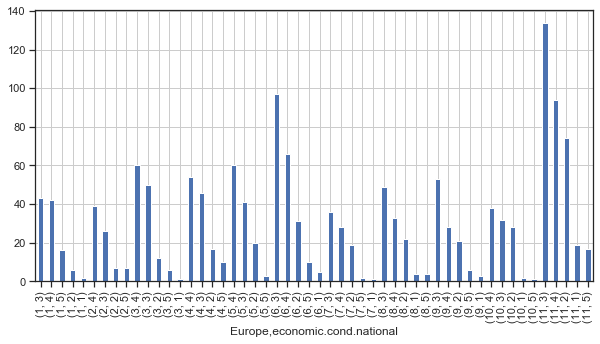

Europe  economic.cond.national
1       3                          43
        4                          42
        5                          16
        2                           6
        1                           2
2       4                          39
        3                          26
        2                           7
        5                           7
3       4                          60
        3                          50
        2                          12
        5                           6
        1                           1
4       4                          54
        3                          46
        2                          17
        5                          10
5       4                          60
        3                          41
        2                          20
        5                           3
6       3                          97
        4                          66
        2                          31
        5          

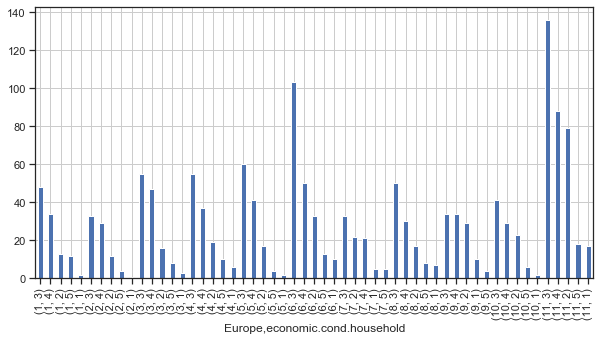

Europe  economic.cond.household
1       3                           48
        4                           34
        2                           13
        5                           12
        1                            2
2       3                           33
        4                           29
        2                           12
        5                            4
        1                            1
3       3                           55
        4                           47
        2                           16
        5                            8
        1                            3
4       3                           55
        4                           37
        2                           19
        5                           10
        1                            6
5       3                           60
        4                           41
        2                           17
        5                            4
        1                       

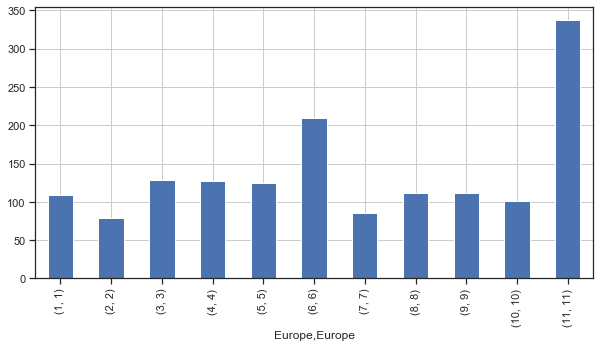

Europe  Europe
1       1         109
2       2          79
3       3         129
4       4         127
5       5         124
6       6         209
7       7          86
8       8         112
9       9         111
10      10        101
11      11        338
Name: Europe, dtype: int64


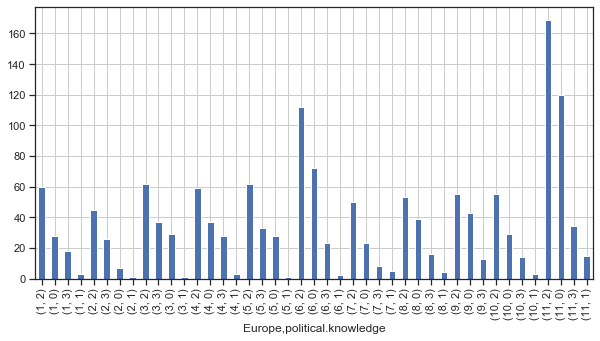

Europe  political.knowledge
1       2                       60
        0                       28
        3                       18
        1                        3
2       2                       45
        3                       26
        0                        7
        1                        1
3       2                       62
        3                       37
        0                       29
        1                        1
4       2                       59
        0                       37
        3                       28
        1                        3
5       2                       62
        3                       33
        0                       28
        1                        1
6       2                      112
        0                       72
        3                       23
        1                        2
7       2                       50
        0                       23
        3                        8
        1                  

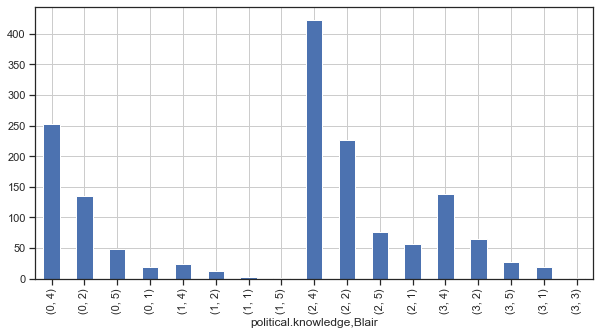

political.knowledge  Blair
0                    4        252
                     2        135
                     5         49
                     1         19
1                    4         23
                     2         12
                     1          2
                     5          1
2                    4        423
                     2        226
                     5         76
                     1         57
3                    4        138
                     2         65
                     5         27
                     1         19
                     3          1
Name: Blair, dtype: int64


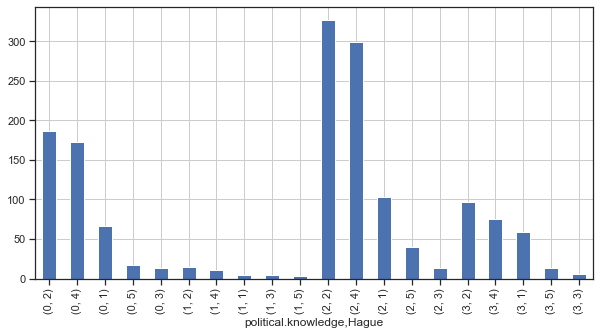

political.knowledge  Hague
0                    2        186
                     4        173
                     1         66
                     5         17
                     3         13
1                    2         14
                     4         11
                     1          5
                     3          5
                     5          3
2                    2        327
                     4        299
                     1        103
                     5         40
                     3         13
3                    2         97
                     4         75
                     1         59
                     5         13
                     3          6
Name: Hague, dtype: int64


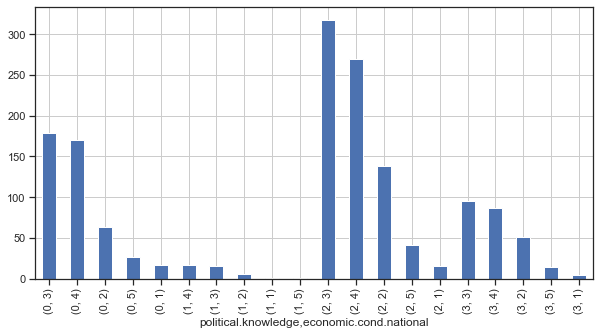

political.knowledge  economic.cond.national
0                    3                         179
                     4                         170
                     2                          63
                     5                          26
                     1                          17
1                    4                          16
                     3                          15
                     2                           5
                     1                           1
                     5                           1
2                    3                         318
                     4                         270
                     2                         138
                     5                          41
                     1                          15
3                    3                          95
                     4                          86
                     2                          51
                     5                

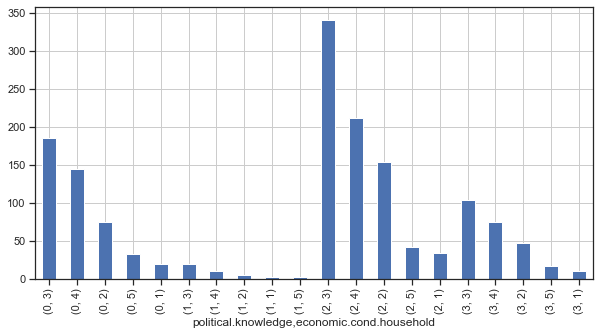

political.knowledge  economic.cond.household
0                    3                          185
                     4                          144
                     2                           75
                     5                           32
                     1                           19
1                    3                           19
                     4                           10
                     2                            5
                     1                            2
                     5                            2
2                    3                          341
                     4                          212
                     2                          153
                     5                           42
                     1                           34
3                    3                          103
                     4                           74
                     2                           47
                   

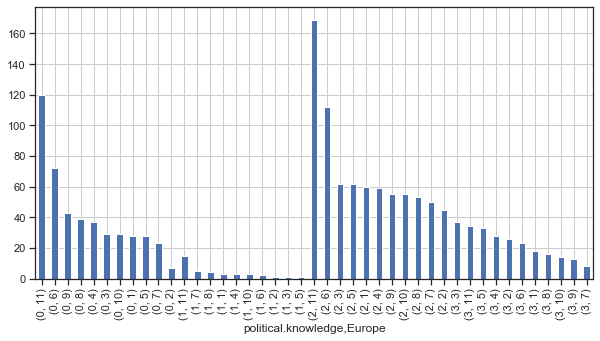

political.knowledge  Europe
0                    11        120
                     6          72
                     9          43
                     8          39
                     4          37
                     3          29
                     10         29
                     1          28
                     5          28
                     7          23
                     2           7
1                    11         15
                     7           5
                     8           4
                     1           3
                     4           3
                     10          3
                     6           2
                     2           1
                     3           1
                     5           1
2                    11        169
                     6         112
                     3          62
                     5          62
                     1          60
                     4          59
                     9     

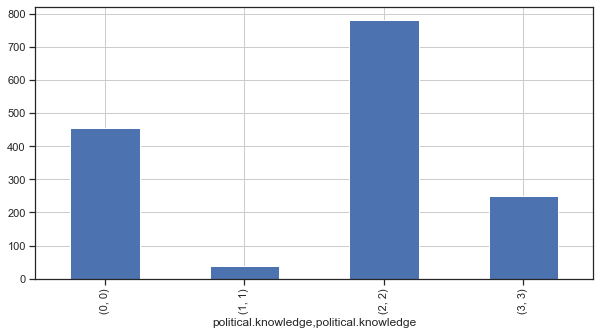

political.knowledge  political.knowledge
0                    0                      455
1                    1                       38
2                    2                      782
3                    3                      250
Name: political.knowledge, dtype: int64


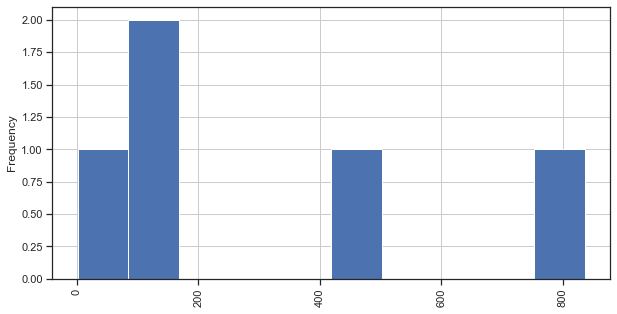

Blair  Blair
1      1         97
2      2        438
3      3          1
4      4        836
5      5        153
Name: Blair, dtype: int64


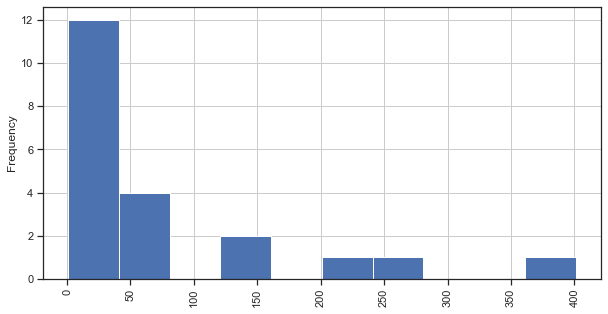

Blair  Hague
1      4         52
       2         19
       5         14
       1         11
       3          1
2      4        203
       2        143
       1         47
       5         30
       3         15
3      5          1
4      2        401
       4        266
       1        128
       5         23
       3         18
5      2         61
       1         47
       4         37
       5          5
       3          3
Name: Hague, dtype: int64


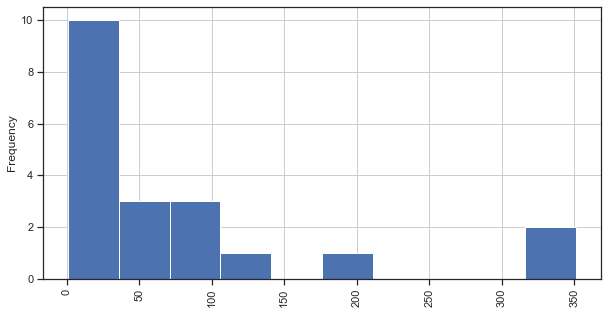

Blair  economic.cond.national
1      2                          38
       3                          32
       4                          17
       1                          10
2      3                         203
       2                         103
       4                         100
       1                          18
       5                          14
3      4                           1
4      4                         351
       3                         326
       2                         111
       5                          40
       1                           8
5      4                          73
       3                          46
       5                          28
       2                           5
       1                           1
Name: economic.cond.national, dtype: int64


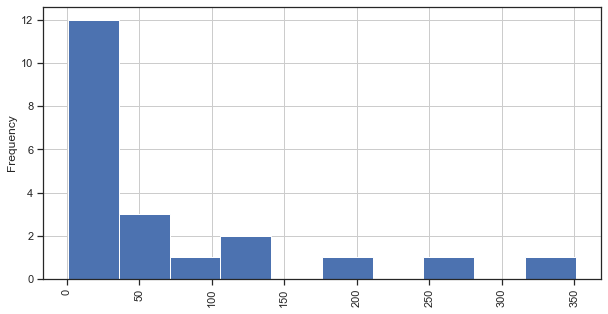

Blair  economic.cond.household
1      3                           34
       2                           30
       4                           17
       1                           10
       5                            6
2      3                          201
       2                          107
       4                           95
       1                           23
       5                           12
3      3                            1
4      3                          351
       4                          275
       2                          129
       5                           50
       1                           31
5      3                           61
       4                           53
       5                           24
       2                           14
       1                            1
Name: economic.cond.household, dtype: int64


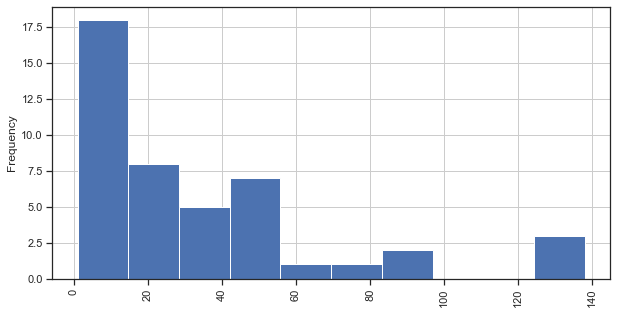

Blair  Europe
1      11         42
       8          11
       6           7
       7           7
       9           7
       1           6
       10          6
       5           5
       3           4
       2           1
       4           1
2      11        138
       6          55
       9          48
       10         40
       5          31
       8          30
       7          27
       4          24
       3          20
       1          17
       2           8
3      9           1
4      11        134
       6         128
       4          89
       3          86
       5          79
       8          68
       2          55
       1          53
       10         50
       7          47
       9          47
5      1          33
       11         24
       3          19
       6          19
       2          15
       4          13
       5           9
       9           8
       7           5
       10          5
       8           3
Name: Europe, dtype: int64


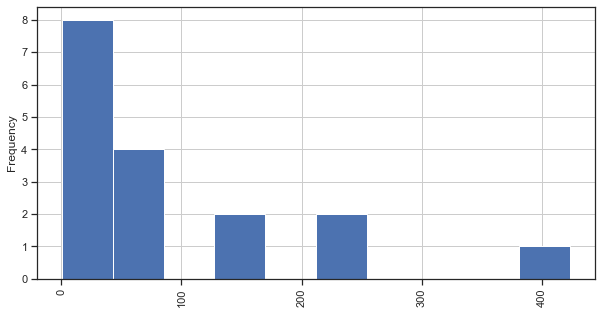

Blair  political.knowledge
1      2                       57
       0                       19
       3                       19
       1                        2
2      2                      226
       0                      135
       3                       65
       1                       12
3      3                        1
4      2                      423
       0                      252
       3                      138
       1                       23
5      2                       76
       0                       49
       3                       27
       1                        1
Name: political.knowledge, dtype: int64


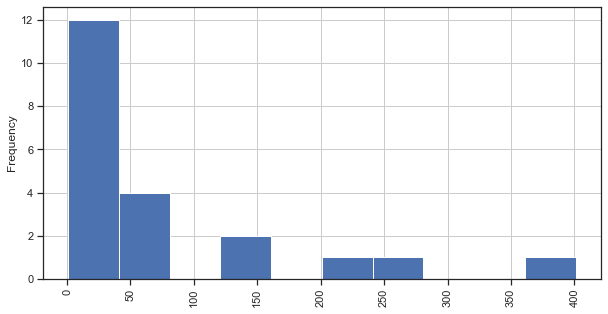

Hague  Blair
1      4        128
       2         47
       5         47
       1         11
2      4        401
       2        143
       5         61
       1         19
3      4         18
       2         15
       5          3
       1          1
4      4        266
       2        203
       1         52
       5         37
5      2         30
       4         23
       1         14
       5          5
       3          1
Name: Blair, dtype: int64


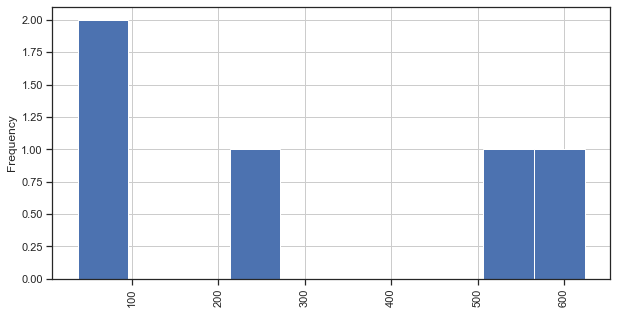

Hague  Hague
1      1        233
2      2        624
3      3         37
4      4        558
5      5         73
Name: Hague, dtype: int64


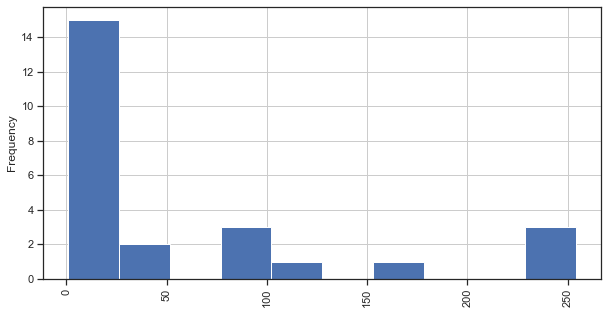

Hague  economic.cond.national
1      4                          96
       3                          91
       2                          22
       5                          22
       1                           2
2      4                         254
       3                         240
       2                          84
       5                          38
       1                           8
3      3                          18
       4                          10
       2                           7
       1                           1
       5                           1
4      3                         230
       4                         163
       2                         126
       1                          23
       5                          16
5      3                          28
       4                          19
       2                          18
       5                           5
       1                           3
Name: economic.cond.national, dtype: int64


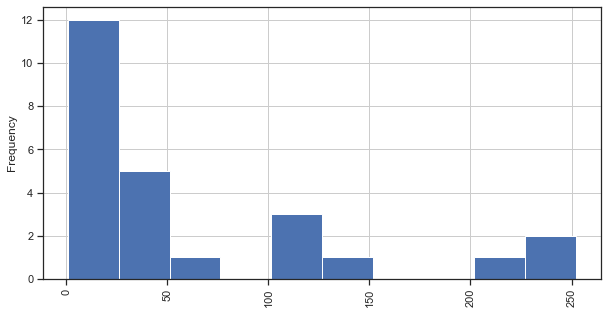

Hague  economic.cond.household
1      3                          105
       4                           72
       2                           31
       5                           18
       1                            7
2      3                          252
       4                          215
       2                          104
       5                           31
       1                           22
3      3                           22
       2                            8
       4                            5
       1                            1
       5                            1
4      3                          240
       4                          134
       2                          117
       5                           36
       1                           31
5      3                           29
       2                           20
       4                           14
       5                            6
       1                            4
Name: economic.cond

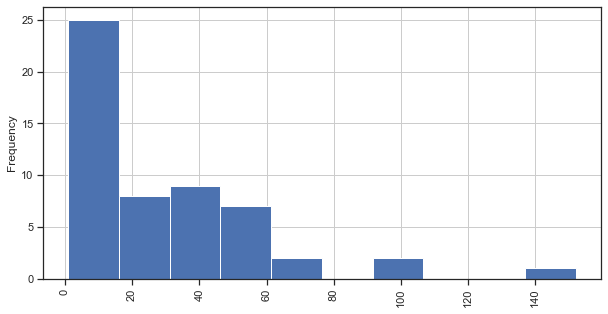

Hague  Europe
1      6          41
       11         35
       1          33
       3          31
       4          29
       2          18
       5          16
       10          9
       8           8
       9           8
       7           5
2      11        103
       6          99
       4          65
       3          63
       5          61
       1          47
       8          47
       9          38
       2          36
       7          36
       10         29
3      11         13
       6           7
       4           3
       5           3
       10          3
       3           2
       9           2
       1           1
       2           1
       7           1
       8           1
4      11        152
       6          61
       10         54
       8          50
       9          49
       5          43
       7          40
       3          30
       4          29
       1          26
       2          24
5      11         35
       9          14
       8           6

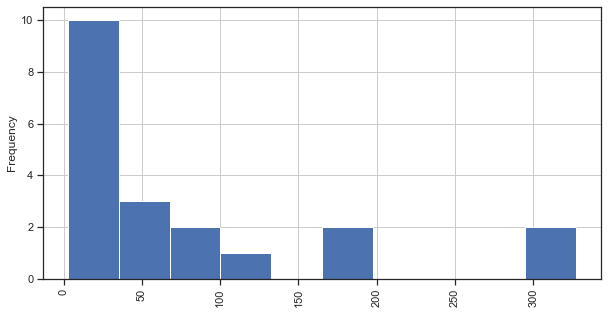

Hague  political.knowledge
1      2                      103
       0                       66
       3                       59
       1                        5
2      2                      327
       0                      186
       3                       97
       1                       14
3      0                       13
       2                       13
       3                        6
       1                        5
4      2                      299
       0                      173
       3                       75
       1                       11
5      2                       40
       0                       17
       3                       13
       1                        3
Name: political.knowledge, dtype: int64


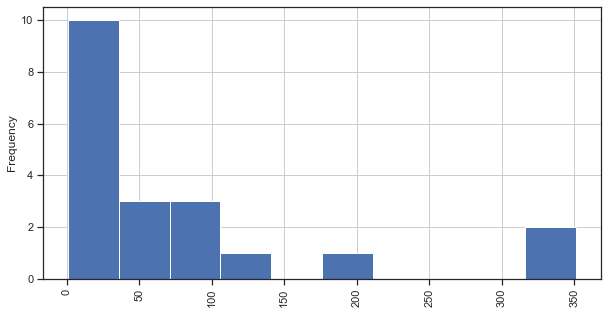

economic.cond.national  Blair
1                       2         18
                        1         10
                        4          8
                        5          1
2                       4        111
                        2        103
                        1         38
                        5          5
3                       4        326
                        2        203
                        5         46
                        1         32
4                       4        351
                        2        100
                        5         73
                        1         17
                        3          1
5                       4         40
                        5         28
                        2         14
Name: Blair, dtype: int64


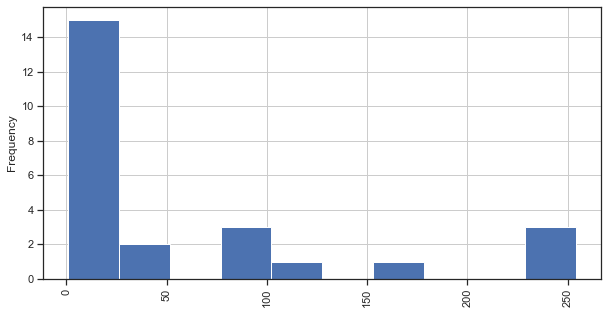

economic.cond.national  Hague
1                       4         23
                        2          8
                        5          3
                        1          2
                        3          1
2                       4        126
                        2         84
                        1         22
                        5         18
                        3          7
3                       2        240
                        4        230
                        1         91
                        5         28
                        3         18
4                       2        254
                        4        163
                        1         96
                        5         19
                        3         10
5                       2         38
                        1         22
                        4         16
                        5          5
                        3          1
Name: Hague, dtype: int64


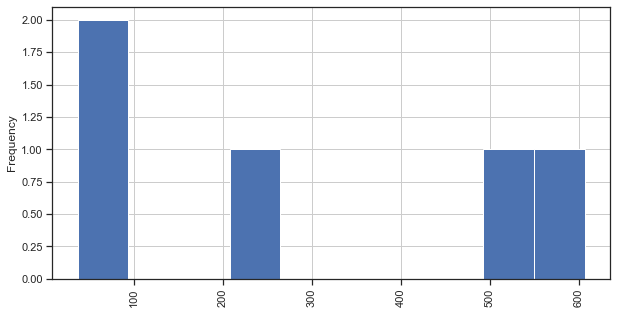

economic.cond.national  economic.cond.national
1                       1                          37
2                       2                         257
3                       3                         607
4                       4                         542
5                       5                          82
Name: economic.cond.national, dtype: int64


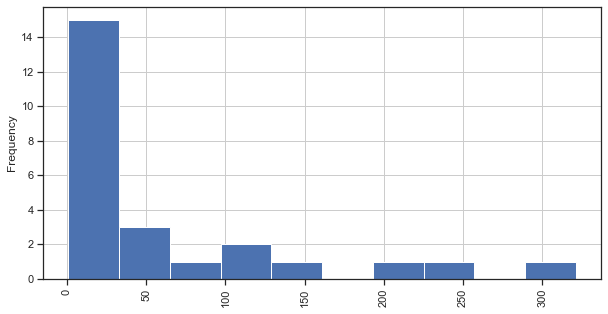

economic.cond.national  economic.cond.household
1                       1                           15
                        2                           10
                        3                            7
                        4                            4
                        5                            1
2                       2                          105
                        3                           91
                        4                           43
                        1                           13
                        5                            5
3                       3                          321
                        4                          136
                        2                          101
                        5                           26
                        1                           23
4                       4                          234
                        3                          200
                 

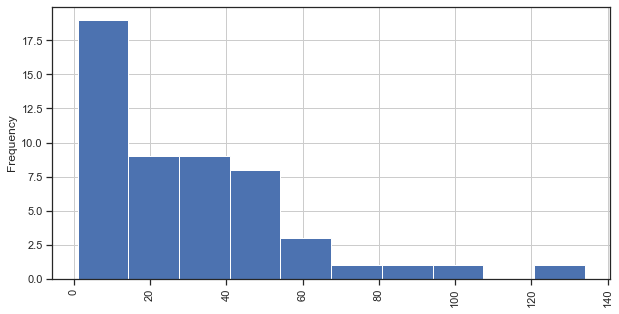

economic.cond.national  Europe
1                       11         19
                        6           5
                        8           4
                        9           3
                        1           2
                        10          2
                        3           1
                        7           1
2                       11         74
                        6          31
                        10         28
                        8          22
                        9          21
                        5          20
                        7          19
                        4          17
                        3          12
                        2           7
                        1           6
3                       11        134
                        6          97
                        9          53
                        3          50
                        8          49
                        4          46
                   

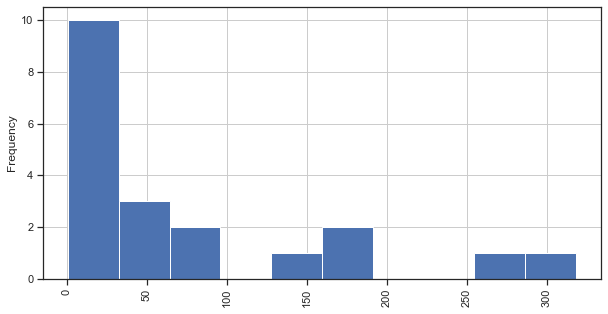

economic.cond.national  political.knowledge
1                       0                       17
                        2                       15
                        3                        4
                        1                        1
2                       2                      138
                        0                       63
                        3                       51
                        1                        5
3                       2                      318
                        0                      179
                        3                       95
                        1                       15
4                       2                      270
                        0                      170
                        3                       86
                        1                       16
5                       2                       41
                        0                       26
                        3             

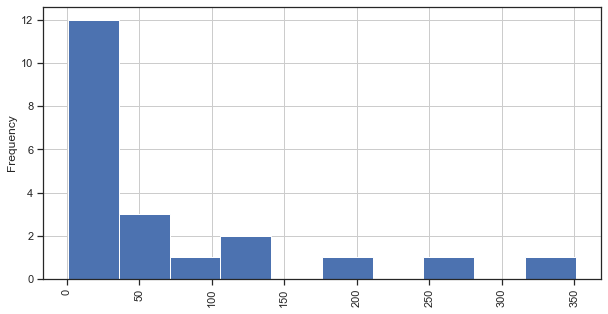

economic.cond.household  Blair
1                        4         31
                         2         23
                         1         10
                         5          1
2                        4        129
                         2        107
                         1         30
                         5         14
3                        4        351
                         2        201
                         5         61
                         1         34
                         3          1
4                        4        275
                         2         95
                         5         53
                         1         17
5                        4         50
                         5         24
                         2         12
                         1          6
Name: Blair, dtype: int64


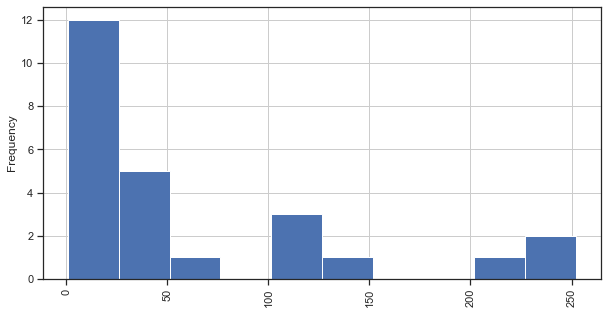

economic.cond.household  Hague
1                        4         31
                         2         22
                         1          7
                         5          4
                         3          1
2                        4        117
                         2        104
                         1         31
                         5         20
                         3          8
3                        2        252
                         4        240
                         1        105
                         5         29
                         3         22
4                        2        215
                         4        134
                         1         72
                         5         14
                         3          5
5                        4         36
                         2         31
                         1         18
                         5          6
                         3          1
Name: Hague, dtype:

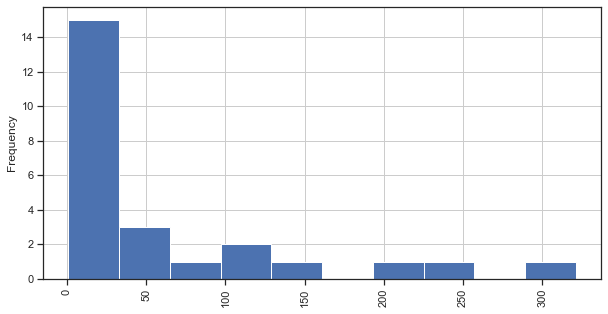

economic.cond.household  economic.cond.national
1                        3                          23
                         1                          15
                         2                          13
                         4                          12
                         5                           2
2                        2                         105
                         3                         101
                         4                          57
                         1                          10
                         5                           7
3                        3                         321
                         4                         200
                         2                          91
                         5                          29
                         1                           7
4                        4                         234
                         3                         136
                 

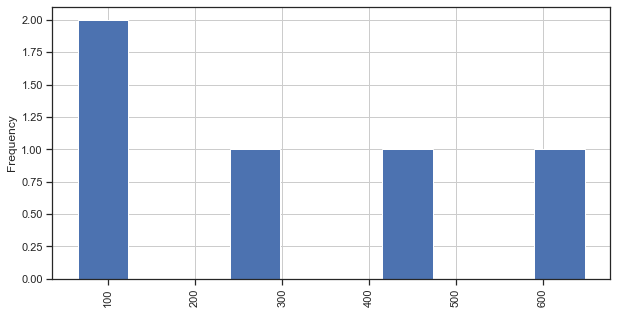

economic.cond.household  economic.cond.household
1                        1                           65
2                        2                          280
3                        3                          648
4                        4                          440
5                        5                           92
Name: economic.cond.household, dtype: int64


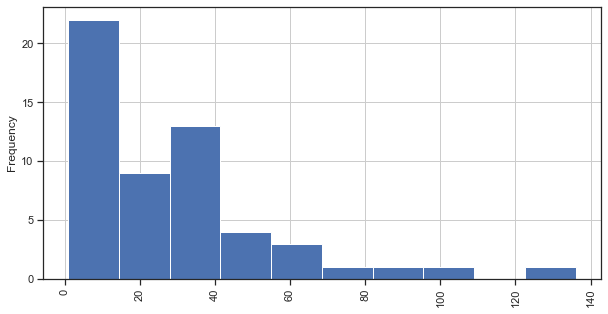

economic.cond.household  Europe
1                        11         17
                         6          10
                         9          10
                         8           7
                         4           6
                         7           5
                         3           3
                         1           2
                         5           2
                         10          2
                         2           1
2                        11         79
                         6          33
                         9          29
                         10         23
                         7          22
                         4          19
                         5          17
                         8          17
                         3          16
                         1          13
                         2          12
3                        11        136
                         6         103
                         5      

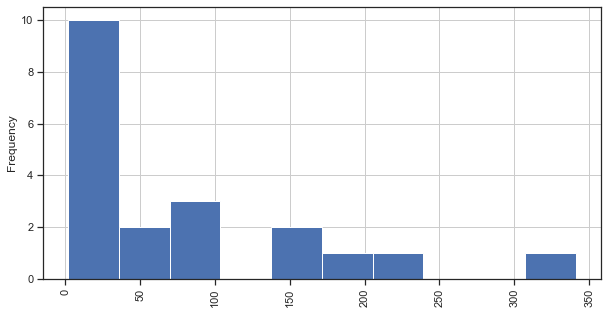

economic.cond.household  political.knowledge
1                        2                       34
                         0                       19
                         3                       10
                         1                        2
2                        2                      153
                         0                       75
                         3                       47
                         1                        5
3                        2                      341
                         0                      185
                         3                      103
                         1                       19
4                        2                      212
                         0                      144
                         3                       74
                         1                       10
5                        2                       42
                         0                       32
                   

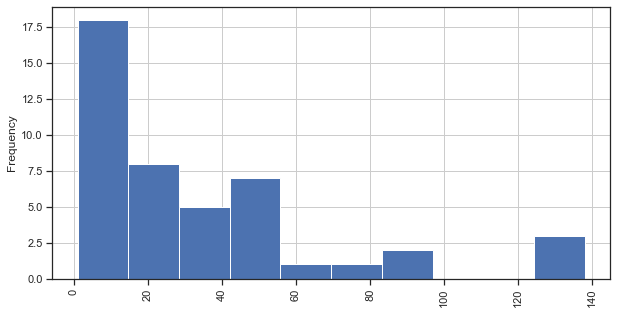

Europe  Blair
1       4         53
        5         33
        2         17
        1          6
2       4         55
        5         15
        2          8
        1          1
3       4         86
        2         20
        5         19
        1          4
4       4         89
        2         24
        5         13
        1          1
5       4         79
        2         31
        5          9
        1          5
6       4        128
        2         55
        5         19
        1          7
7       4         47
        2         27
        1          7
        5          5
8       4         68
        2         30
        1         11
        5          3
9       2         48
        4         47
        5          8
        1          7
        3          1
10      4         50
        2         40
        1          6
        5          5
11      2        138
        4        134
        1         42
        5         24
Name: Blair, dtype: int64


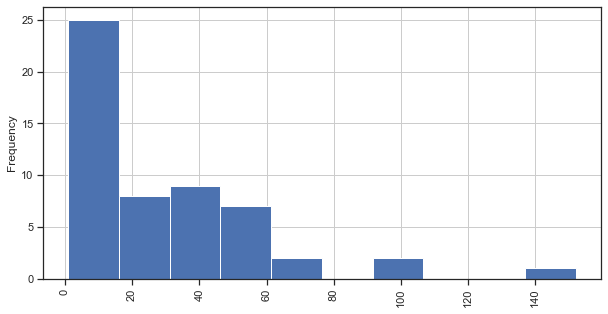

Europe  Hague
1       2         47
        1         33
        4         26
        5          2
        3          1
2       2         36
        4         24
        1         18
        3          1
3       2         63
        1         31
        4         30
        5          3
        3          2
4       2         65
        1         29
        4         29
        3          3
        5          1
5       2         61
        4         43
        1         16
        3          3
        5          1
6       2         99
        4         61
        1         41
        3          7
        5          1
7       4         40
        2         36
        1          5
        5          4
        3          1
8       4         50
        2         47
        1          8
        5          6
        3          1
9       4         49
        2         38
        5         14
        1          8
        3          2
10      4         54
        2         29
        1          9

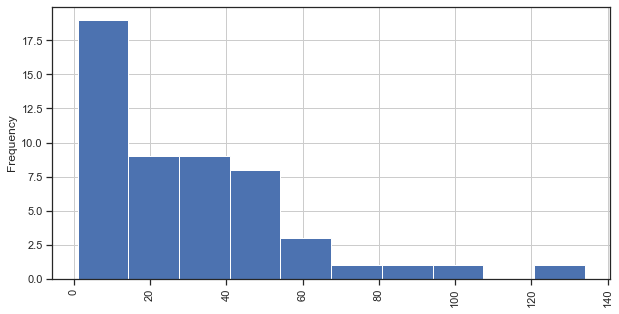

Europe  economic.cond.national
1       3                          43
        4                          42
        5                          16
        2                           6
        1                           2
2       4                          39
        3                          26
        2                           7
        5                           7
3       4                          60
        3                          50
        2                          12
        5                           6
        1                           1
4       4                          54
        3                          46
        2                          17
        5                          10
5       4                          60
        3                          41
        2                          20
        5                           3
6       3                          97
        4                          66
        2                          31
        5          

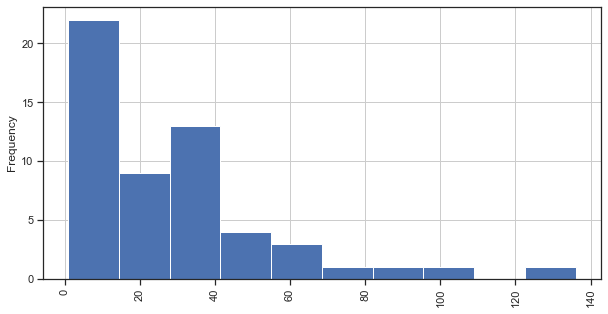

Europe  economic.cond.household
1       3                           48
        4                           34
        2                           13
        5                           12
        1                            2
2       3                           33
        4                           29
        2                           12
        5                            4
        1                            1
3       3                           55
        4                           47
        2                           16
        5                            8
        1                            3
4       3                           55
        4                           37
        2                           19
        5                           10
        1                            6
5       3                           60
        4                           41
        2                           17
        5                            4
        1                       

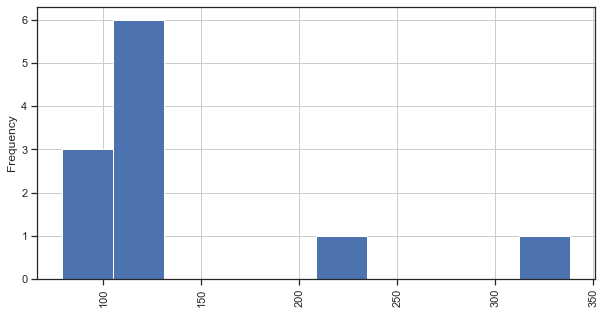

Europe  Europe
1       1         109
2       2          79
3       3         129
4       4         127
5       5         124
6       6         209
7       7          86
8       8         112
9       9         111
10      10        101
11      11        338
Name: Europe, dtype: int64


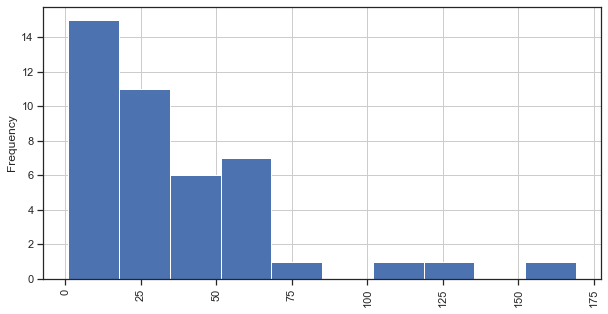

Europe  political.knowledge
1       2                       60
        0                       28
        3                       18
        1                        3
2       2                       45
        3                       26
        0                        7
        1                        1
3       2                       62
        3                       37
        0                       29
        1                        1
4       2                       59
        0                       37
        3                       28
        1                        3
5       2                       62
        3                       33
        0                       28
        1                        1
6       2                      112
        0                       72
        3                       23
        1                        2
7       2                       50
        0                       23
        3                        8
        1                  

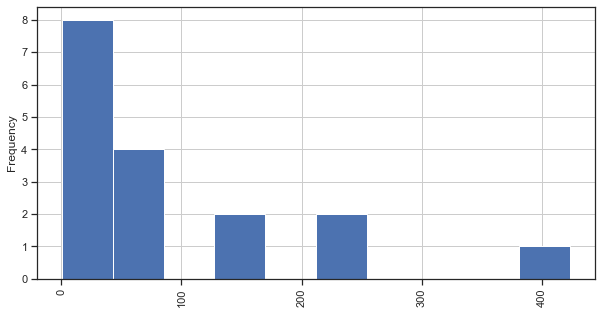

political.knowledge  Blair
0                    4        252
                     2        135
                     5         49
                     1         19
1                    4         23
                     2         12
                     1          2
                     5          1
2                    4        423
                     2        226
                     5         76
                     1         57
3                    4        138
                     2         65
                     5         27
                     1         19
                     3          1
Name: Blair, dtype: int64


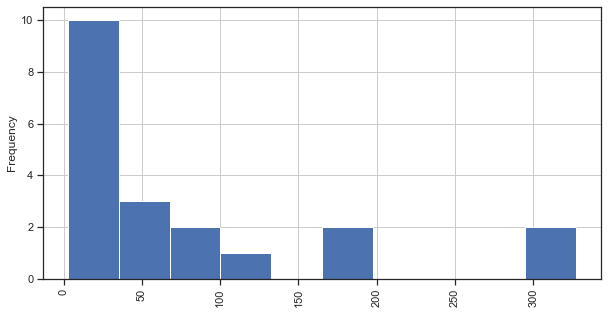

political.knowledge  Hague
0                    2        186
                     4        173
                     1         66
                     5         17
                     3         13
1                    2         14
                     4         11
                     1          5
                     3          5
                     5          3
2                    2        327
                     4        299
                     1        103
                     5         40
                     3         13
3                    2         97
                     4         75
                     1         59
                     5         13
                     3          6
Name: Hague, dtype: int64


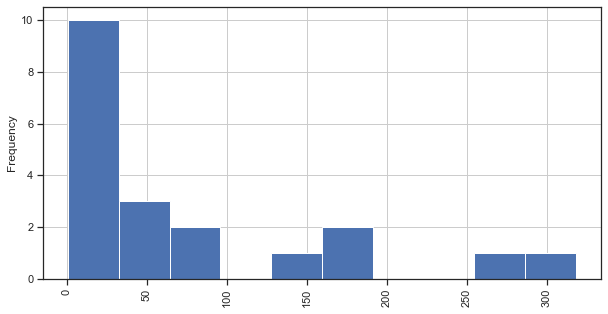

political.knowledge  economic.cond.national
0                    3                         179
                     4                         170
                     2                          63
                     5                          26
                     1                          17
1                    4                          16
                     3                          15
                     2                           5
                     1                           1
                     5                           1
2                    3                         318
                     4                         270
                     2                         138
                     5                          41
                     1                          15
3                    3                          95
                     4                          86
                     2                          51
                     5                

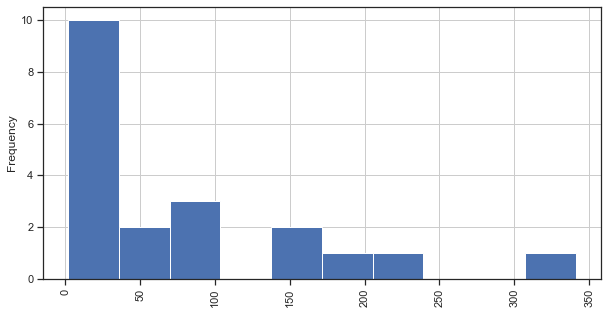

political.knowledge  economic.cond.household
0                    3                          185
                     4                          144
                     2                           75
                     5                           32
                     1                           19
1                    3                           19
                     4                           10
                     2                            5
                     1                            2
                     5                            2
2                    3                          341
                     4                          212
                     2                          153
                     5                           42
                     1                           34
3                    3                          103
                     4                           74
                     2                           47
                   

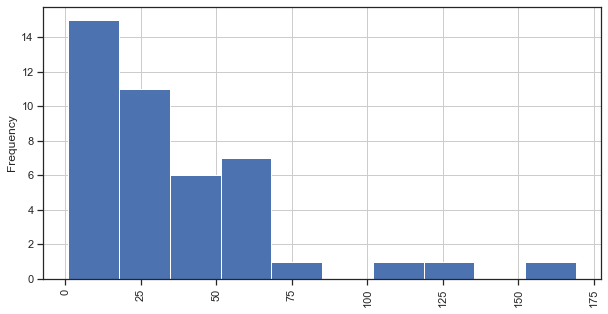

political.knowledge  Europe
0                    11        120
                     6          72
                     9          43
                     8          39
                     4          37
                     3          29
                     10         29
                     1          28
                     5          28
                     7          23
                     2           7
1                    11         15
                     7           5
                     8           4
                     1           3
                     4           3
                     10          3
                     6           2
                     2           1
                     3           1
                     5           1
2                    11        169
                     6         112
                     3          62
                     5          62
                     1          60
                     4          59
                     9     

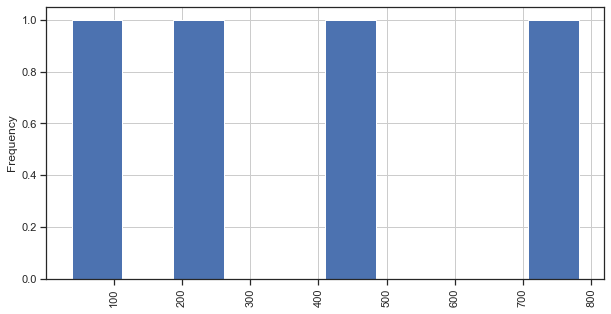

political.knowledge  political.knowledge
0                    0                      455
1                    1                       38
2                    2                      782
3                    3                      250
Name: political.knowledge, dtype: int64


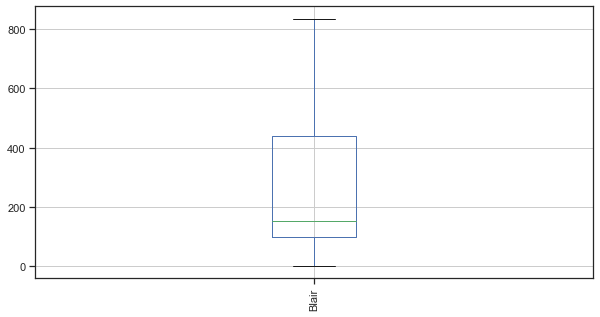

Blair  Blair
1      1         97
2      2        438
3      3          1
4      4        836
5      5        153
Name: Blair, dtype: int64


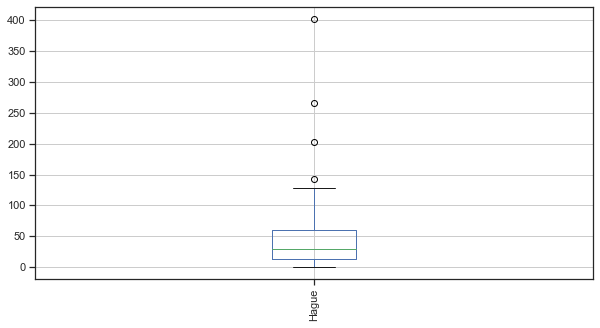

Blair  Hague
1      4         52
       2         19
       5         14
       1         11
       3          1
2      4        203
       2        143
       1         47
       5         30
       3         15
3      5          1
4      2        401
       4        266
       1        128
       5         23
       3         18
5      2         61
       1         47
       4         37
       5          5
       3          3
Name: Hague, dtype: int64


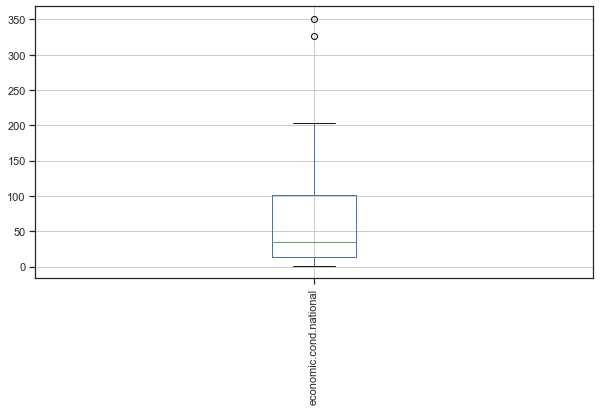

Blair  economic.cond.national
1      2                          38
       3                          32
       4                          17
       1                          10
2      3                         203
       2                         103
       4                         100
       1                          18
       5                          14
3      4                           1
4      4                         351
       3                         326
       2                         111
       5                          40
       1                           8
5      4                          73
       3                          46
       5                          28
       2                           5
       1                           1
Name: economic.cond.national, dtype: int64


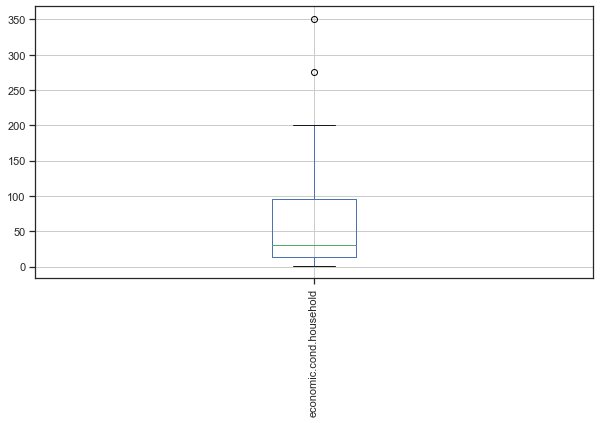

Blair  economic.cond.household
1      3                           34
       2                           30
       4                           17
       1                           10
       5                            6
2      3                          201
       2                          107
       4                           95
       1                           23
       5                           12
3      3                            1
4      3                          351
       4                          275
       2                          129
       5                           50
       1                           31
5      3                           61
       4                           53
       5                           24
       2                           14
       1                            1
Name: economic.cond.household, dtype: int64


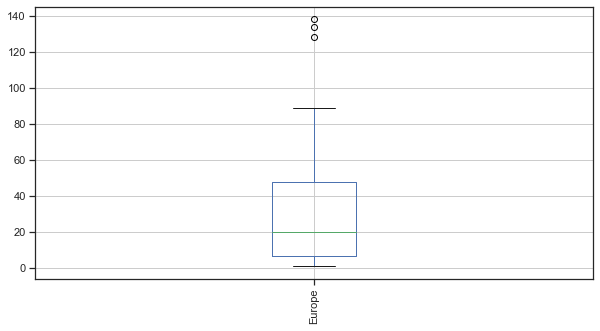

Blair  Europe
1      11         42
       8          11
       6           7
       7           7
       9           7
       1           6
       10          6
       5           5
       3           4
       2           1
       4           1
2      11        138
       6          55
       9          48
       10         40
       5          31
       8          30
       7          27
       4          24
       3          20
       1          17
       2           8
3      9           1
4      11        134
       6         128
       4          89
       3          86
       5          79
       8          68
       2          55
       1          53
       10         50
       7          47
       9          47
5      1          33
       11         24
       3          19
       6          19
       2          15
       4          13
       5           9
       9           8
       7           5
       10          5
       8           3
Name: Europe, dtype: int64


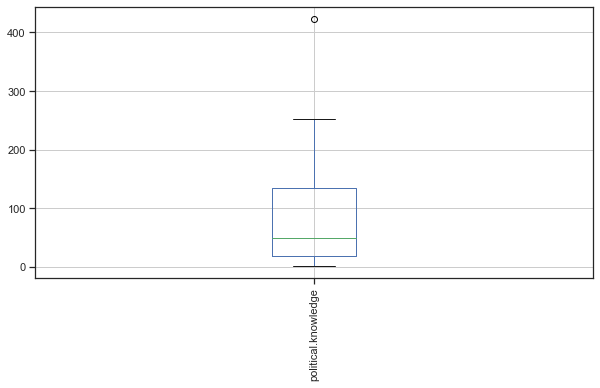

Blair  political.knowledge
1      2                       57
       0                       19
       3                       19
       1                        2
2      2                      226
       0                      135
       3                       65
       1                       12
3      3                        1
4      2                      423
       0                      252
       3                      138
       1                       23
5      2                       76
       0                       49
       3                       27
       1                        1
Name: political.knowledge, dtype: int64


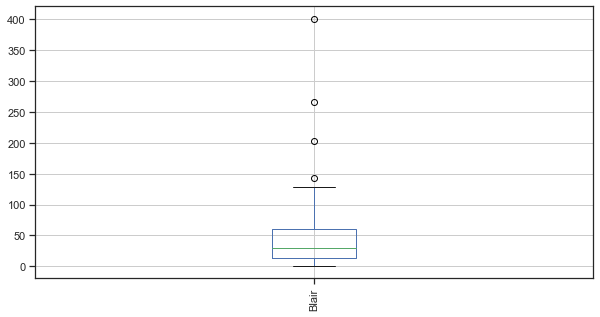

Hague  Blair
1      4        128
       2         47
       5         47
       1         11
2      4        401
       2        143
       5         61
       1         19
3      4         18
       2         15
       5          3
       1          1
4      4        266
       2        203
       1         52
       5         37
5      2         30
       4         23
       1         14
       5          5
       3          1
Name: Blair, dtype: int64


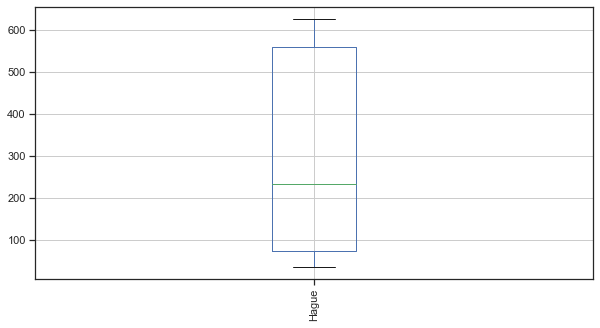

Hague  Hague
1      1        233
2      2        624
3      3         37
4      4        558
5      5         73
Name: Hague, dtype: int64


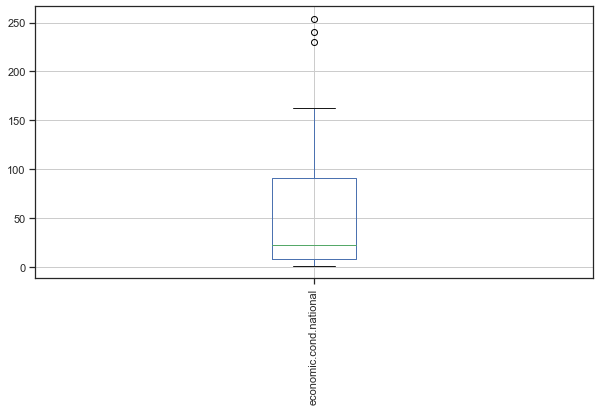

Hague  economic.cond.national
1      4                          96
       3                          91
       2                          22
       5                          22
       1                           2
2      4                         254
       3                         240
       2                          84
       5                          38
       1                           8
3      3                          18
       4                          10
       2                           7
       1                           1
       5                           1
4      3                         230
       4                         163
       2                         126
       1                          23
       5                          16
5      3                          28
       4                          19
       2                          18
       5                           5
       1                           3
Name: economic.cond.national, dtype: int64


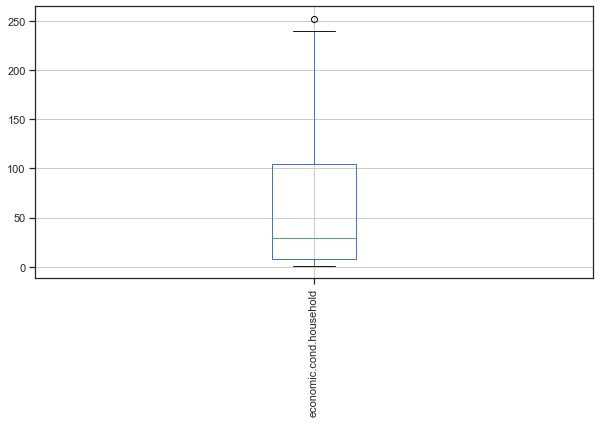

Hague  economic.cond.household
1      3                          105
       4                           72
       2                           31
       5                           18
       1                            7
2      3                          252
       4                          215
       2                          104
       5                           31
       1                           22
3      3                           22
       2                            8
       4                            5
       1                            1
       5                            1
4      3                          240
       4                          134
       2                          117
       5                           36
       1                           31
5      3                           29
       2                           20
       4                           14
       5                            6
       1                            4
Name: economic.cond

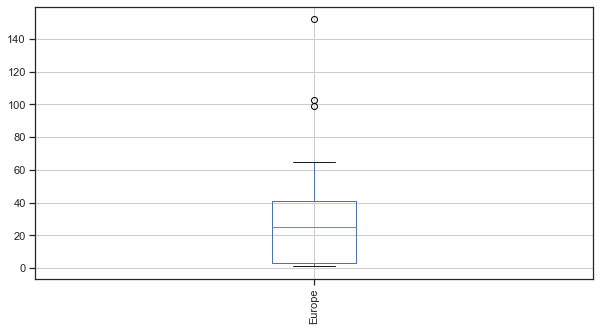

Hague  Europe
1      6          41
       11         35
       1          33
       3          31
       4          29
       2          18
       5          16
       10          9
       8           8
       9           8
       7           5
2      11        103
       6          99
       4          65
       3          63
       5          61
       1          47
       8          47
       9          38
       2          36
       7          36
       10         29
3      11         13
       6           7
       4           3
       5           3
       10          3
       3           2
       9           2
       1           1
       2           1
       7           1
       8           1
4      11        152
       6          61
       10         54
       8          50
       9          49
       5          43
       7          40
       3          30
       4          29
       1          26
       2          24
5      11         35
       9          14
       8           6

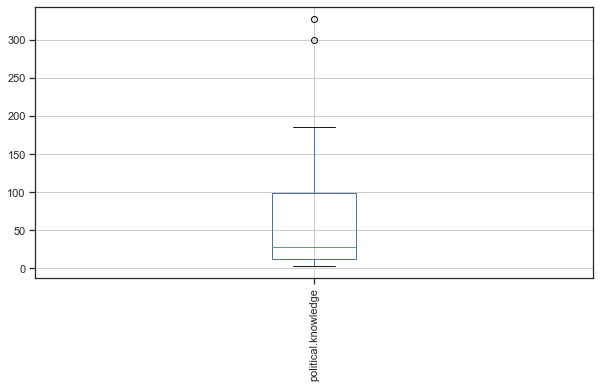

Hague  political.knowledge
1      2                      103
       0                       66
       3                       59
       1                        5
2      2                      327
       0                      186
       3                       97
       1                       14
3      0                       13
       2                       13
       3                        6
       1                        5
4      2                      299
       0                      173
       3                       75
       1                       11
5      2                       40
       0                       17
       3                       13
       1                        3
Name: political.knowledge, dtype: int64


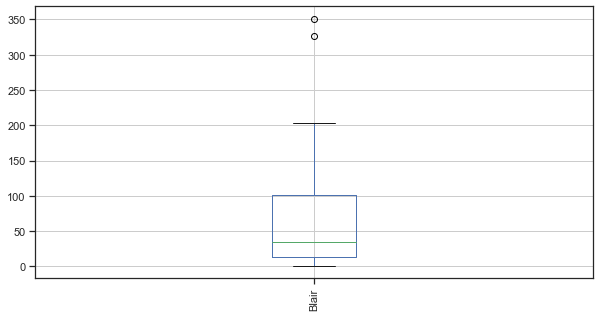

economic.cond.national  Blair
1                       2         18
                        1         10
                        4          8
                        5          1
2                       4        111
                        2        103
                        1         38
                        5          5
3                       4        326
                        2        203
                        5         46
                        1         32
4                       4        351
                        2        100
                        5         73
                        1         17
                        3          1
5                       4         40
                        5         28
                        2         14
Name: Blair, dtype: int64


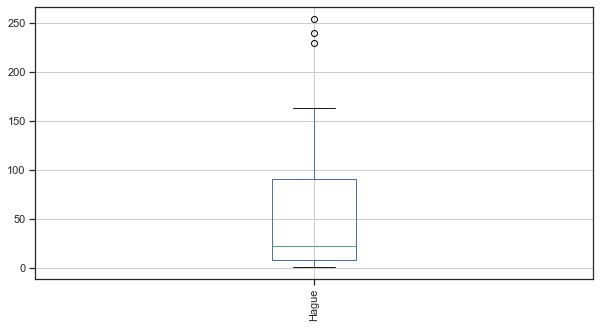

economic.cond.national  Hague
1                       4         23
                        2          8
                        5          3
                        1          2
                        3          1
2                       4        126
                        2         84
                        1         22
                        5         18
                        3          7
3                       2        240
                        4        230
                        1         91
                        5         28
                        3         18
4                       2        254
                        4        163
                        1         96
                        5         19
                        3         10
5                       2         38
                        1         22
                        4         16
                        5          5
                        3          1
Name: Hague, dtype: int64


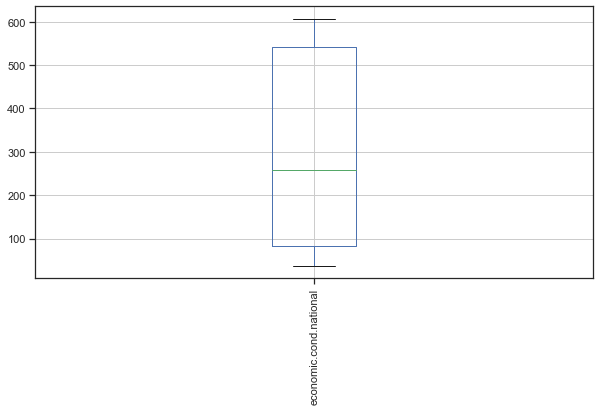

economic.cond.national  economic.cond.national
1                       1                          37
2                       2                         257
3                       3                         607
4                       4                         542
5                       5                          82
Name: economic.cond.national, dtype: int64


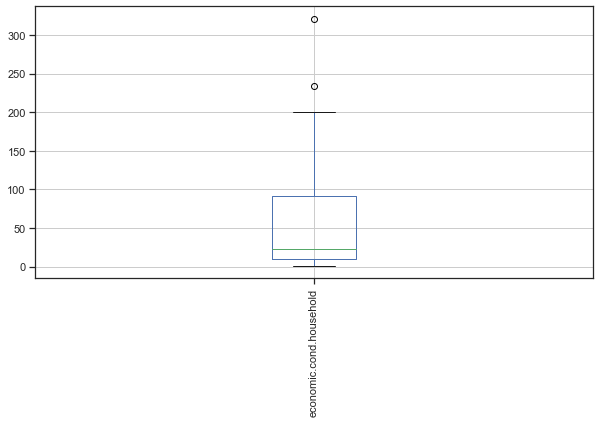

economic.cond.national  economic.cond.household
1                       1                           15
                        2                           10
                        3                            7
                        4                            4
                        5                            1
2                       2                          105
                        3                           91
                        4                           43
                        1                           13
                        5                            5
3                       3                          321
                        4                          136
                        2                          101
                        5                           26
                        1                           23
4                       4                          234
                        3                          200
                 

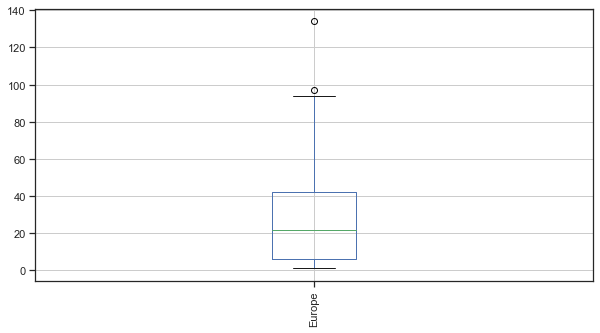

economic.cond.national  Europe
1                       11         19
                        6           5
                        8           4
                        9           3
                        1           2
                        10          2
                        3           1
                        7           1
2                       11         74
                        6          31
                        10         28
                        8          22
                        9          21
                        5          20
                        7          19
                        4          17
                        3          12
                        2           7
                        1           6
3                       11        134
                        6          97
                        9          53
                        3          50
                        8          49
                        4          46
                   

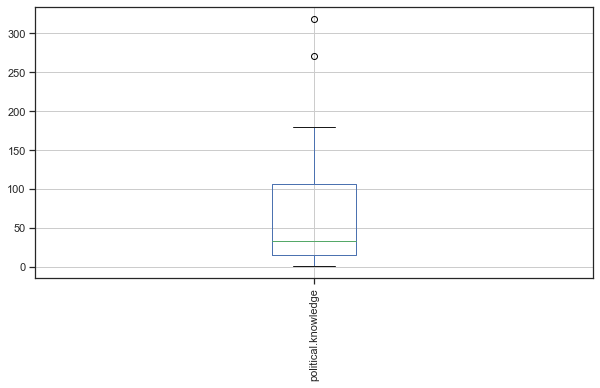

economic.cond.national  political.knowledge
1                       0                       17
                        2                       15
                        3                        4
                        1                        1
2                       2                      138
                        0                       63
                        3                       51
                        1                        5
3                       2                      318
                        0                      179
                        3                       95
                        1                       15
4                       2                      270
                        0                      170
                        3                       86
                        1                       16
5                       2                       41
                        0                       26
                        3             

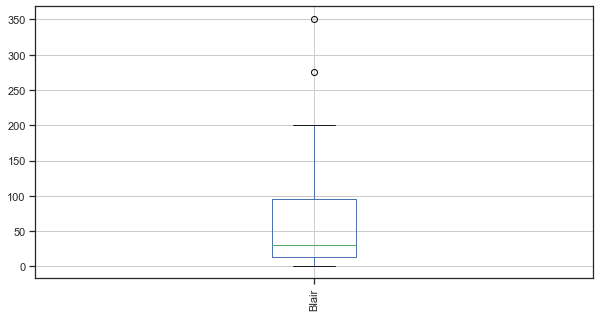

economic.cond.household  Blair
1                        4         31
                         2         23
                         1         10
                         5          1
2                        4        129
                         2        107
                         1         30
                         5         14
3                        4        351
                         2        201
                         5         61
                         1         34
                         3          1
4                        4        275
                         2         95
                         5         53
                         1         17
5                        4         50
                         5         24
                         2         12
                         1          6
Name: Blair, dtype: int64


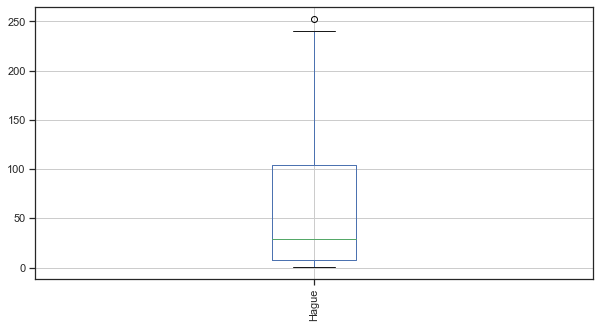

economic.cond.household  Hague
1                        4         31
                         2         22
                         1          7
                         5          4
                         3          1
2                        4        117
                         2        104
                         1         31
                         5         20
                         3          8
3                        2        252
                         4        240
                         1        105
                         5         29
                         3         22
4                        2        215
                         4        134
                         1         72
                         5         14
                         3          5
5                        4         36
                         2         31
                         1         18
                         5          6
                         3          1
Name: Hague, dtype:

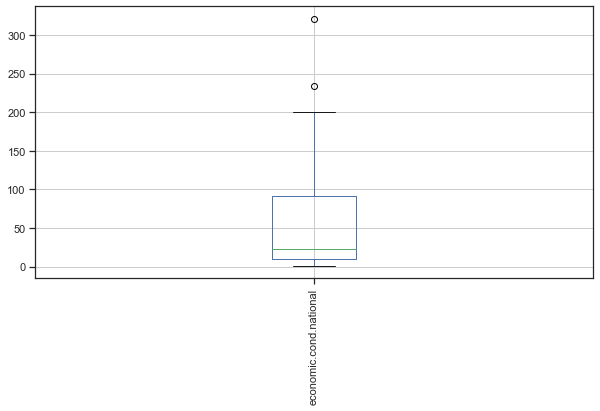

economic.cond.household  economic.cond.national
1                        3                          23
                         1                          15
                         2                          13
                         4                          12
                         5                           2
2                        2                         105
                         3                         101
                         4                          57
                         1                          10
                         5                           7
3                        3                         321
                         4                         200
                         2                          91
                         5                          29
                         1                           7
4                        4                         234
                         3                         136
                 

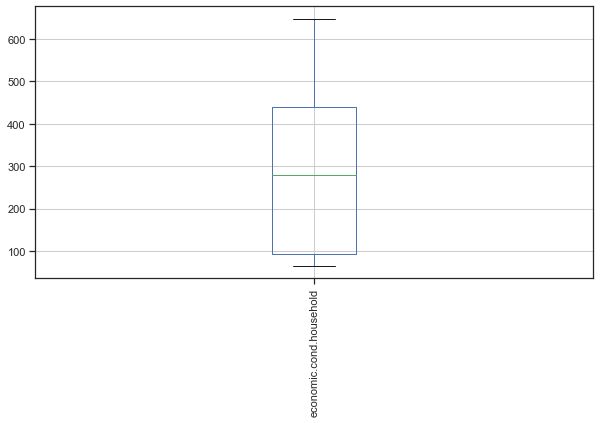

economic.cond.household  economic.cond.household
1                        1                           65
2                        2                          280
3                        3                          648
4                        4                          440
5                        5                           92
Name: economic.cond.household, dtype: int64


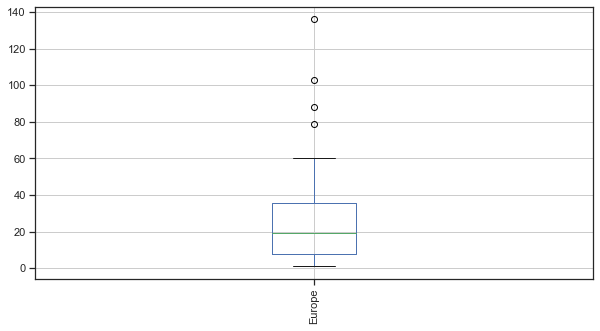

economic.cond.household  Europe
1                        11         17
                         6          10
                         9          10
                         8           7
                         4           6
                         7           5
                         3           3
                         1           2
                         5           2
                         10          2
                         2           1
2                        11         79
                         6          33
                         9          29
                         10         23
                         7          22
                         4          19
                         5          17
                         8          17
                         3          16
                         1          13
                         2          12
3                        11        136
                         6         103
                         5      

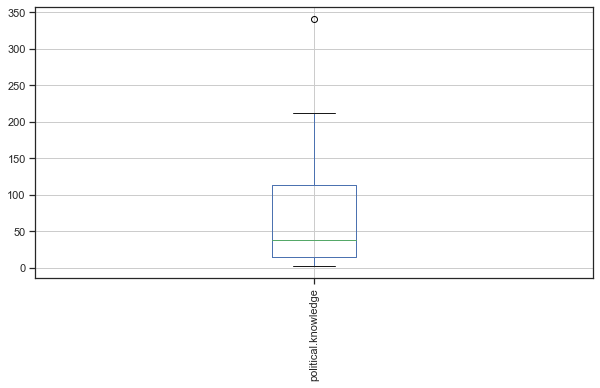

economic.cond.household  political.knowledge
1                        2                       34
                         0                       19
                         3                       10
                         1                        2
2                        2                      153
                         0                       75
                         3                       47
                         1                        5
3                        2                      341
                         0                      185
                         3                      103
                         1                       19
4                        2                      212
                         0                      144
                         3                       74
                         1                       10
5                        2                       42
                         0                       32
                   

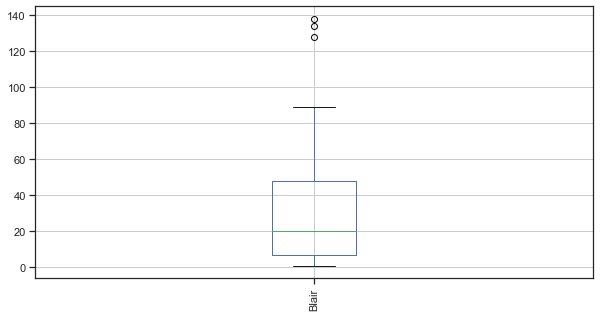

Europe  Blair
1       4         53
        5         33
        2         17
        1          6
2       4         55
        5         15
        2          8
        1          1
3       4         86
        2         20
        5         19
        1          4
4       4         89
        2         24
        5         13
        1          1
5       4         79
        2         31
        5          9
        1          5
6       4        128
        2         55
        5         19
        1          7
7       4         47
        2         27
        1          7
        5          5
8       4         68
        2         30
        1         11
        5          3
9       2         48
        4         47
        5          8
        1          7
        3          1
10      4         50
        2         40
        1          6
        5          5
11      2        138
        4        134
        1         42
        5         24
Name: Blair, dtype: int64


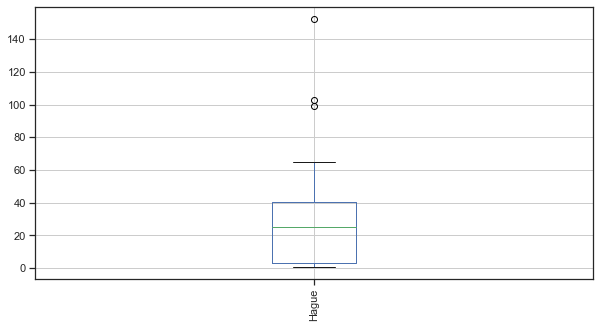

Europe  Hague
1       2         47
        1         33
        4         26
        5          2
        3          1
2       2         36
        4         24
        1         18
        3          1
3       2         63
        1         31
        4         30
        5          3
        3          2
4       2         65
        1         29
        4         29
        3          3
        5          1
5       2         61
        4         43
        1         16
        3          3
        5          1
6       2         99
        4         61
        1         41
        3          7
        5          1
7       4         40
        2         36
        1          5
        5          4
        3          1
8       4         50
        2         47
        1          8
        5          6
        3          1
9       4         49
        2         38
        5         14
        1          8
        3          2
10      4         54
        2         29
        1          9

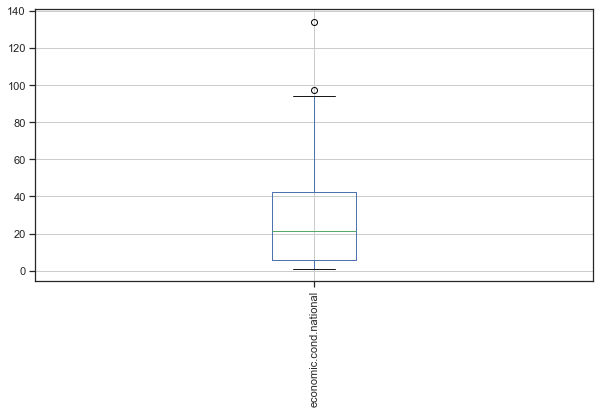

Europe  economic.cond.national
1       3                          43
        4                          42
        5                          16
        2                           6
        1                           2
2       4                          39
        3                          26
        2                           7
        5                           7
3       4                          60
        3                          50
        2                          12
        5                           6
        1                           1
4       4                          54
        3                          46
        2                          17
        5                          10
5       4                          60
        3                          41
        2                          20
        5                           3
6       3                          97
        4                          66
        2                          31
        5          

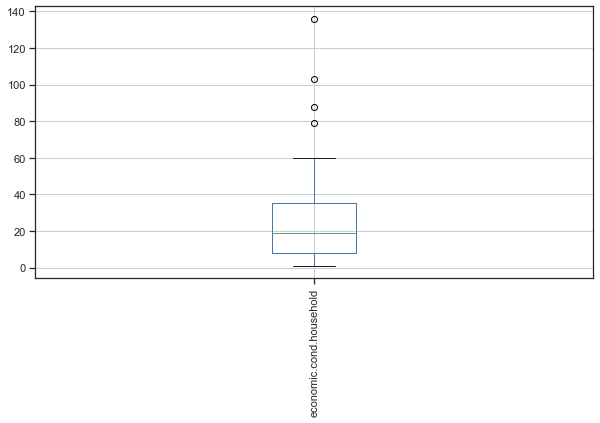

Europe  economic.cond.household
1       3                           48
        4                           34
        2                           13
        5                           12
        1                            2
2       3                           33
        4                           29
        2                           12
        5                            4
        1                            1
3       3                           55
        4                           47
        2                           16
        5                            8
        1                            3
4       3                           55
        4                           37
        2                           19
        5                           10
        1                            6
5       3                           60
        4                           41
        2                           17
        5                            4
        1                       

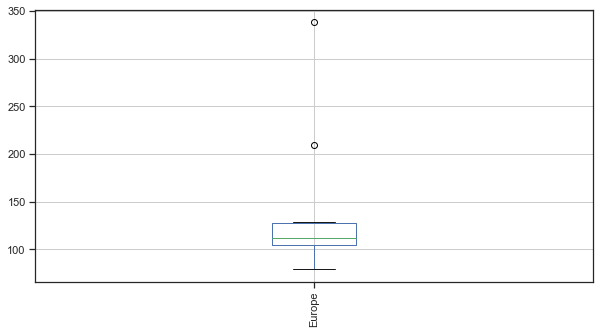

Europe  Europe
1       1         109
2       2          79
3       3         129
4       4         127
5       5         124
6       6         209
7       7          86
8       8         112
9       9         111
10      10        101
11      11        338
Name: Europe, dtype: int64


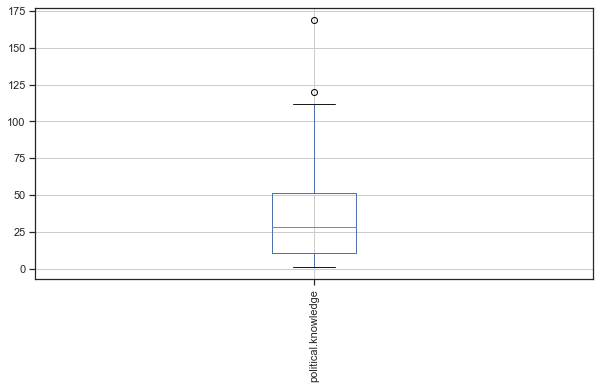

Europe  political.knowledge
1       2                       60
        0                       28
        3                       18
        1                        3
2       2                       45
        3                       26
        0                        7
        1                        1
3       2                       62
        3                       37
        0                       29
        1                        1
4       2                       59
        0                       37
        3                       28
        1                        3
5       2                       62
        3                       33
        0                       28
        1                        1
6       2                      112
        0                       72
        3                       23
        1                        2
7       2                       50
        0                       23
        3                        8
        1                  

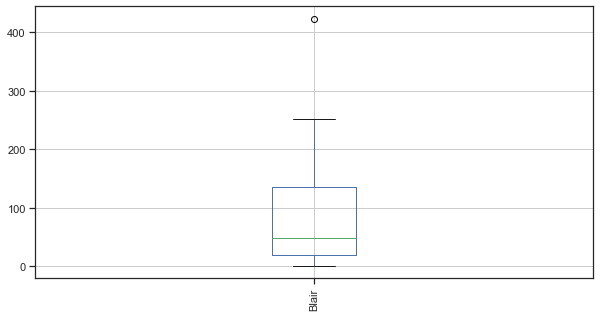

political.knowledge  Blair
0                    4        252
                     2        135
                     5         49
                     1         19
1                    4         23
                     2         12
                     1          2
                     5          1
2                    4        423
                     2        226
                     5         76
                     1         57
3                    4        138
                     2         65
                     5         27
                     1         19
                     3          1
Name: Blair, dtype: int64


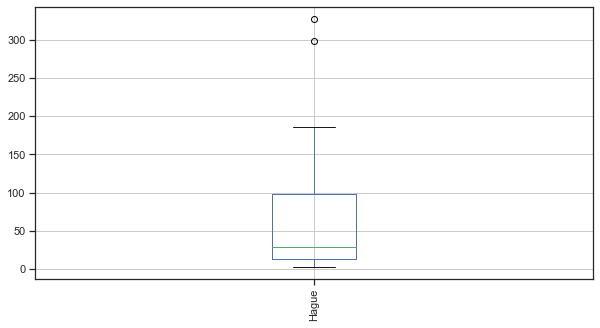

political.knowledge  Hague
0                    2        186
                     4        173
                     1         66
                     5         17
                     3         13
1                    2         14
                     4         11
                     1          5
                     3          5
                     5          3
2                    2        327
                     4        299
                     1        103
                     5         40
                     3         13
3                    2         97
                     4         75
                     1         59
                     5         13
                     3          6
Name: Hague, dtype: int64


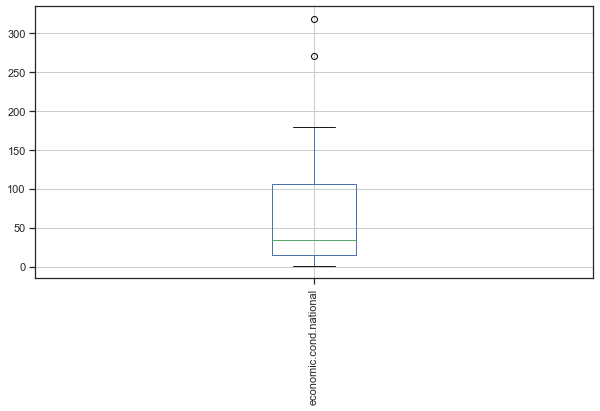

political.knowledge  economic.cond.national
0                    3                         179
                     4                         170
                     2                          63
                     5                          26
                     1                          17
1                    4                          16
                     3                          15
                     2                           5
                     1                           1
                     5                           1
2                    3                         318
                     4                         270
                     2                         138
                     5                          41
                     1                          15
3                    3                          95
                     4                          86
                     2                          51
                     5                

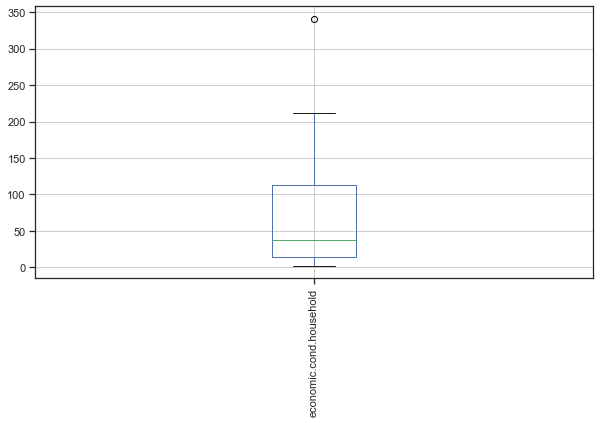

political.knowledge  economic.cond.household
0                    3                          185
                     4                          144
                     2                           75
                     5                           32
                     1                           19
1                    3                           19
                     4                           10
                     2                            5
                     1                            2
                     5                            2
2                    3                          341
                     4                          212
                     2                          153
                     5                           42
                     1                           34
3                    3                          103
                     4                           74
                     2                           47
                   

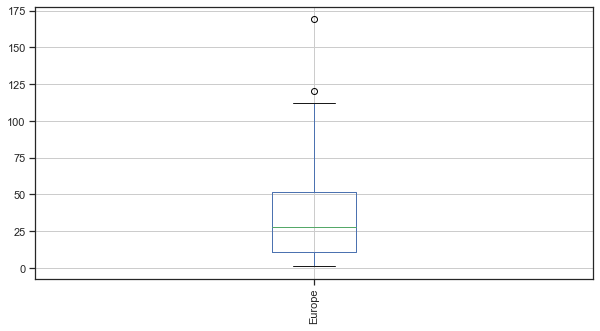

political.knowledge  Europe
0                    11        120
                     6          72
                     9          43
                     8          39
                     4          37
                     3          29
                     10         29
                     1          28
                     5          28
                     7          23
                     2           7
1                    11         15
                     7           5
                     8           4
                     1           3
                     4           3
                     10          3
                     6           2
                     2           1
                     3           1
                     5           1
2                    11        169
                     6         112
                     3          62
                     5          62
                     1          60
                     4          59
                     9     

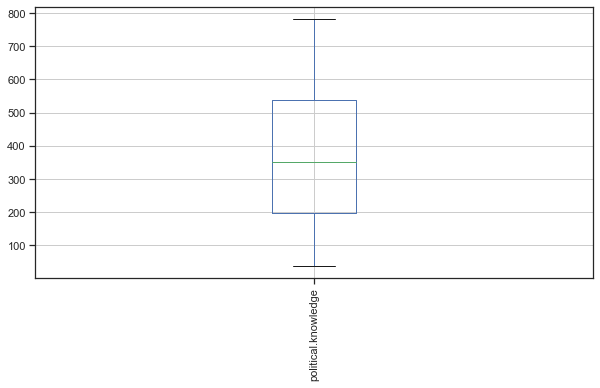

political.knowledge  political.knowledge
0                    0                      455
1                    1                       38
2                    2                      782
3                    3                      250
Name: political.knowledge, dtype: int64


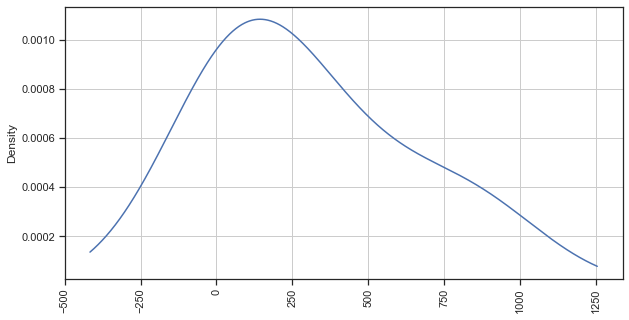

Blair  Blair
1      1         97
2      2        438
3      3          1
4      4        836
5      5        153
Name: Blair, dtype: int64


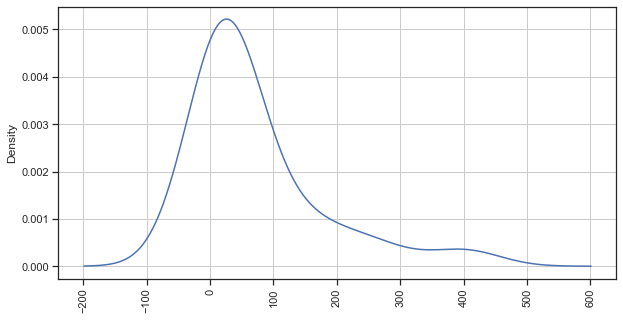

Blair  Hague
1      4         52
       2         19
       5         14
       1         11
       3          1
2      4        203
       2        143
       1         47
       5         30
       3         15
3      5          1
4      2        401
       4        266
       1        128
       5         23
       3         18
5      2         61
       1         47
       4         37
       5          5
       3          3
Name: Hague, dtype: int64


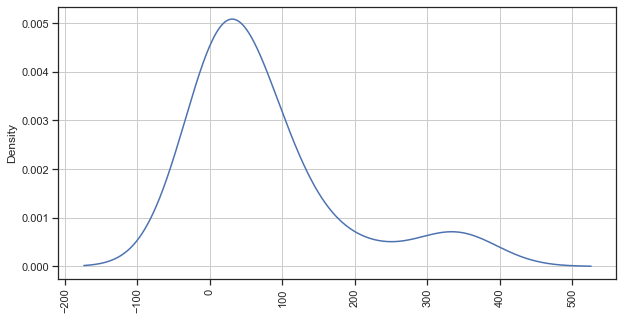

Blair  economic.cond.national
1      2                          38
       3                          32
       4                          17
       1                          10
2      3                         203
       2                         103
       4                         100
       1                          18
       5                          14
3      4                           1
4      4                         351
       3                         326
       2                         111
       5                          40
       1                           8
5      4                          73
       3                          46
       5                          28
       2                           5
       1                           1
Name: economic.cond.national, dtype: int64


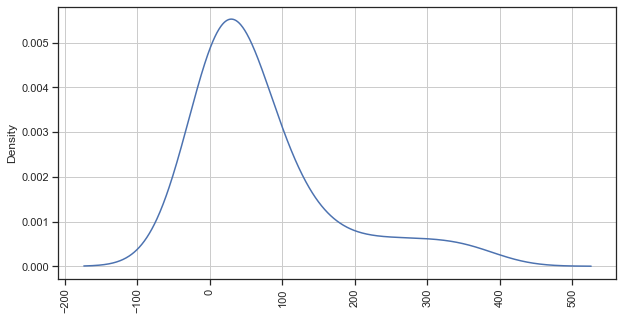

Blair  economic.cond.household
1      3                           34
       2                           30
       4                           17
       1                           10
       5                            6
2      3                          201
       2                          107
       4                           95
       1                           23
       5                           12
3      3                            1
4      3                          351
       4                          275
       2                          129
       5                           50
       1                           31
5      3                           61
       4                           53
       5                           24
       2                           14
       1                            1
Name: economic.cond.household, dtype: int64


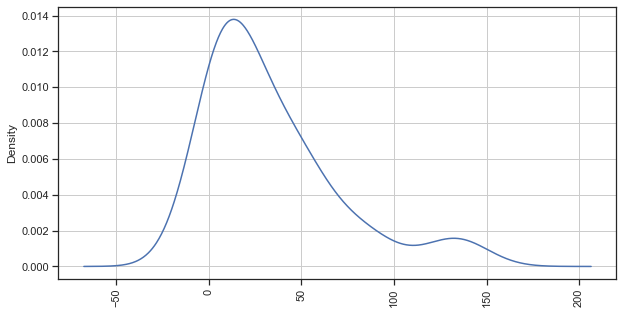

Blair  Europe
1      11         42
       8          11
       6           7
       7           7
       9           7
       1           6
       10          6
       5           5
       3           4
       2           1
       4           1
2      11        138
       6          55
       9          48
       10         40
       5          31
       8          30
       7          27
       4          24
       3          20
       1          17
       2           8
3      9           1
4      11        134
       6         128
       4          89
       3          86
       5          79
       8          68
       2          55
       1          53
       10         50
       7          47
       9          47
5      1          33
       11         24
       3          19
       6          19
       2          15
       4          13
       5           9
       9           8
       7           5
       10          5
       8           3
Name: Europe, dtype: int64


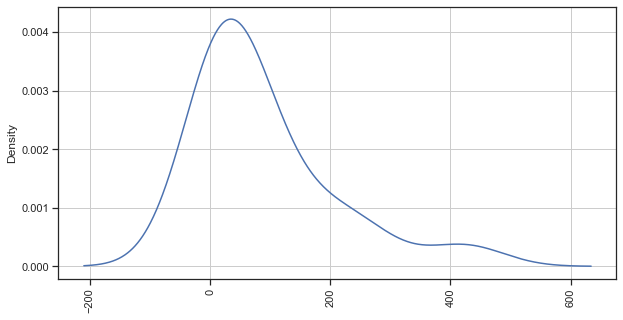

Blair  political.knowledge
1      2                       57
       0                       19
       3                       19
       1                        2
2      2                      226
       0                      135
       3                       65
       1                       12
3      3                        1
4      2                      423
       0                      252
       3                      138
       1                       23
5      2                       76
       0                       49
       3                       27
       1                        1
Name: political.knowledge, dtype: int64


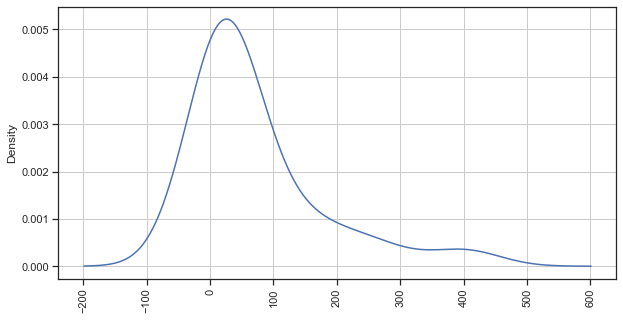

Hague  Blair
1      4        128
       2         47
       5         47
       1         11
2      4        401
       2        143
       5         61
       1         19
3      4         18
       2         15
       5          3
       1          1
4      4        266
       2        203
       1         52
       5         37
5      2         30
       4         23
       1         14
       5          5
       3          1
Name: Blair, dtype: int64


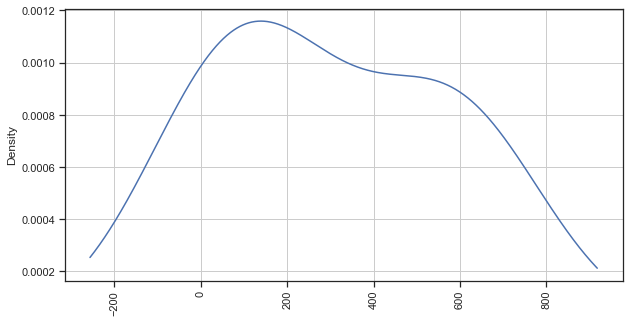

Hague  Hague
1      1        233
2      2        624
3      3         37
4      4        558
5      5         73
Name: Hague, dtype: int64


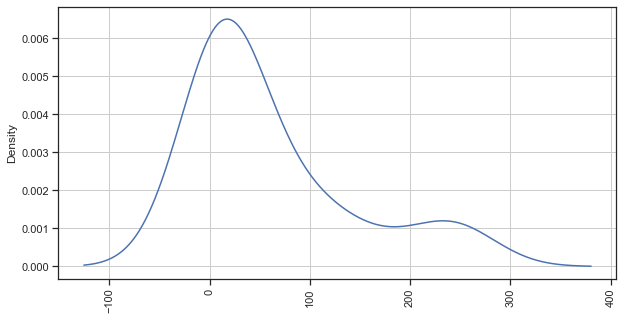

Hague  economic.cond.national
1      4                          96
       3                          91
       2                          22
       5                          22
       1                           2
2      4                         254
       3                         240
       2                          84
       5                          38
       1                           8
3      3                          18
       4                          10
       2                           7
       1                           1
       5                           1
4      3                         230
       4                         163
       2                         126
       1                          23
       5                          16
5      3                          28
       4                          19
       2                          18
       5                           5
       1                           3
Name: economic.cond.national, dtype: int64


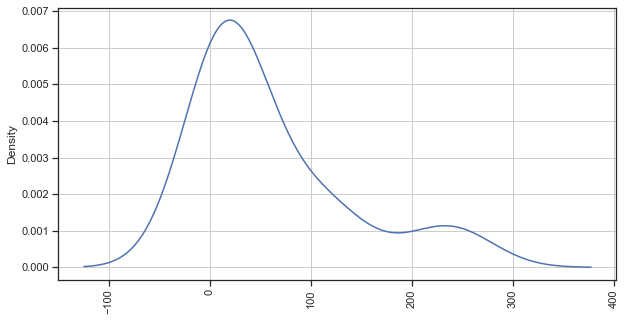

Hague  economic.cond.household
1      3                          105
       4                           72
       2                           31
       5                           18
       1                            7
2      3                          252
       4                          215
       2                          104
       5                           31
       1                           22
3      3                           22
       2                            8
       4                            5
       1                            1
       5                            1
4      3                          240
       4                          134
       2                          117
       5                           36
       1                           31
5      3                           29
       2                           20
       4                           14
       5                            6
       1                            4
Name: economic.cond

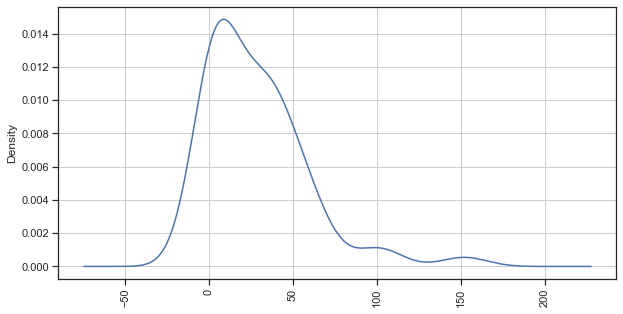

Hague  Europe
1      6          41
       11         35
       1          33
       3          31
       4          29
       2          18
       5          16
       10          9
       8           8
       9           8
       7           5
2      11        103
       6          99
       4          65
       3          63
       5          61
       1          47
       8          47
       9          38
       2          36
       7          36
       10         29
3      11         13
       6           7
       4           3
       5           3
       10          3
       3           2
       9           2
       1           1
       2           1
       7           1
       8           1
4      11        152
       6          61
       10         54
       8          50
       9          49
       5          43
       7          40
       3          30
       4          29
       1          26
       2          24
5      11         35
       9          14
       8           6

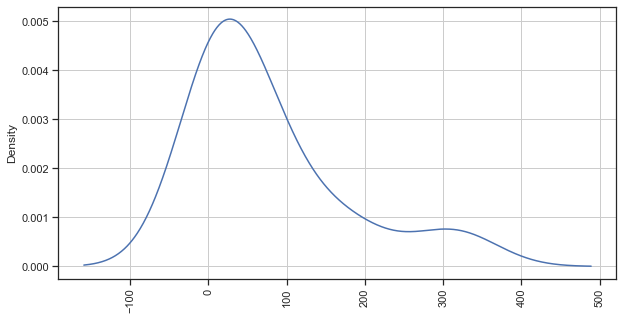

Hague  political.knowledge
1      2                      103
       0                       66
       3                       59
       1                        5
2      2                      327
       0                      186
       3                       97
       1                       14
3      0                       13
       2                       13
       3                        6
       1                        5
4      2                      299
       0                      173
       3                       75
       1                       11
5      2                       40
       0                       17
       3                       13
       1                        3
Name: political.knowledge, dtype: int64


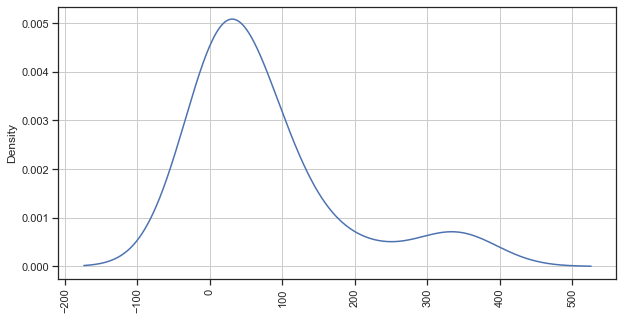

economic.cond.national  Blair
1                       2         18
                        1         10
                        4          8
                        5          1
2                       4        111
                        2        103
                        1         38
                        5          5
3                       4        326
                        2        203
                        5         46
                        1         32
4                       4        351
                        2        100
                        5         73
                        1         17
                        3          1
5                       4         40
                        5         28
                        2         14
Name: Blair, dtype: int64


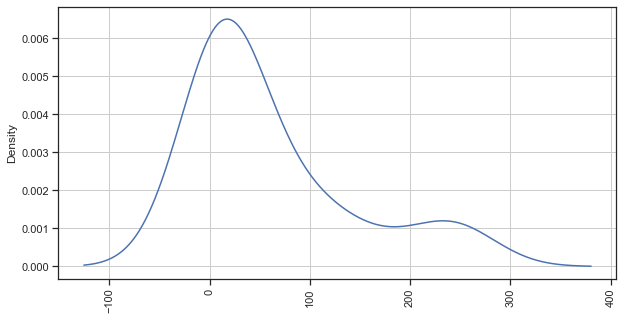

economic.cond.national  Hague
1                       4         23
                        2          8
                        5          3
                        1          2
                        3          1
2                       4        126
                        2         84
                        1         22
                        5         18
                        3          7
3                       2        240
                        4        230
                        1         91
                        5         28
                        3         18
4                       2        254
                        4        163
                        1         96
                        5         19
                        3         10
5                       2         38
                        1         22
                        4         16
                        5          5
                        3          1
Name: Hague, dtype: int64


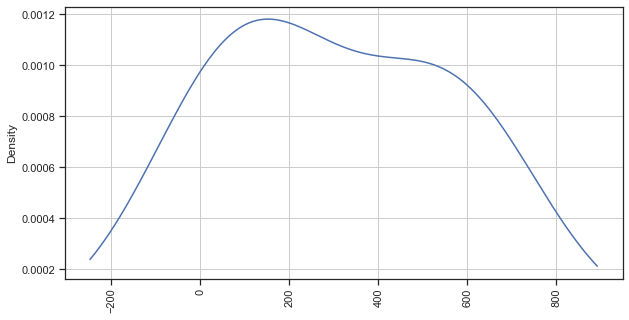

economic.cond.national  economic.cond.national
1                       1                          37
2                       2                         257
3                       3                         607
4                       4                         542
5                       5                          82
Name: economic.cond.national, dtype: int64


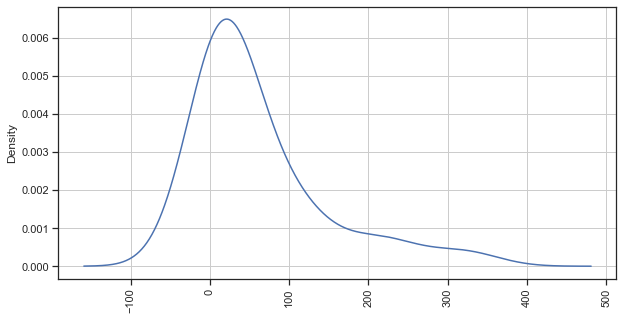

economic.cond.national  economic.cond.household
1                       1                           15
                        2                           10
                        3                            7
                        4                            4
                        5                            1
2                       2                          105
                        3                           91
                        4                           43
                        1                           13
                        5                            5
3                       3                          321
                        4                          136
                        2                          101
                        5                           26
                        1                           23
4                       4                          234
                        3                          200
                 

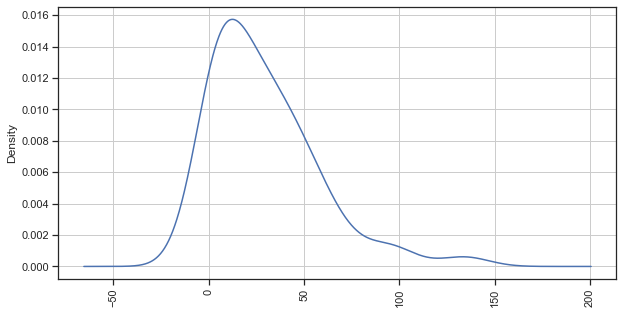

economic.cond.national  Europe
1                       11         19
                        6           5
                        8           4
                        9           3
                        1           2
                        10          2
                        3           1
                        7           1
2                       11         74
                        6          31
                        10         28
                        8          22
                        9          21
                        5          20
                        7          19
                        4          17
                        3          12
                        2           7
                        1           6
3                       11        134
                        6          97
                        9          53
                        3          50
                        8          49
                        4          46
                   

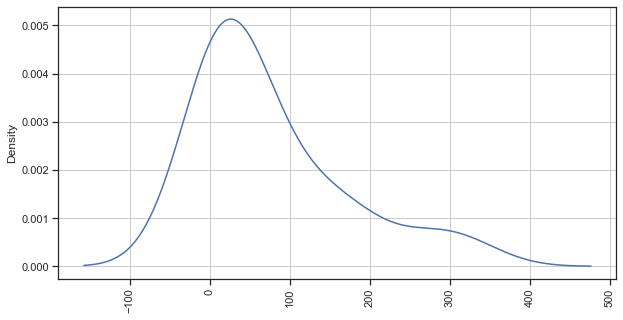

economic.cond.national  political.knowledge
1                       0                       17
                        2                       15
                        3                        4
                        1                        1
2                       2                      138
                        0                       63
                        3                       51
                        1                        5
3                       2                      318
                        0                      179
                        3                       95
                        1                       15
4                       2                      270
                        0                      170
                        3                       86
                        1                       16
5                       2                       41
                        0                       26
                        3             

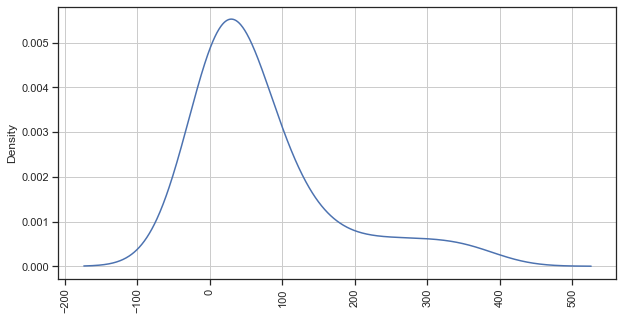

economic.cond.household  Blair
1                        4         31
                         2         23
                         1         10
                         5          1
2                        4        129
                         2        107
                         1         30
                         5         14
3                        4        351
                         2        201
                         5         61
                         1         34
                         3          1
4                        4        275
                         2         95
                         5         53
                         1         17
5                        4         50
                         5         24
                         2         12
                         1          6
Name: Blair, dtype: int64


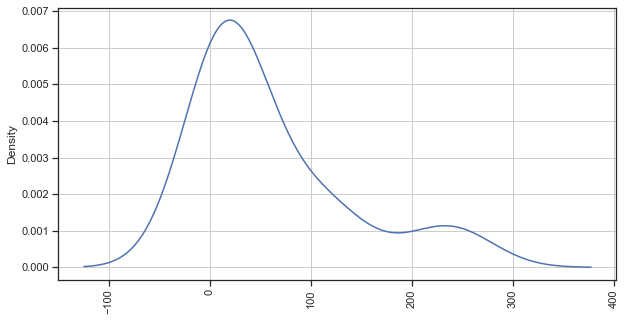

economic.cond.household  Hague
1                        4         31
                         2         22
                         1          7
                         5          4
                         3          1
2                        4        117
                         2        104
                         1         31
                         5         20
                         3          8
3                        2        252
                         4        240
                         1        105
                         5         29
                         3         22
4                        2        215
                         4        134
                         1         72
                         5         14
                         3          5
5                        4         36
                         2         31
                         1         18
                         5          6
                         3          1
Name: Hague, dtype:

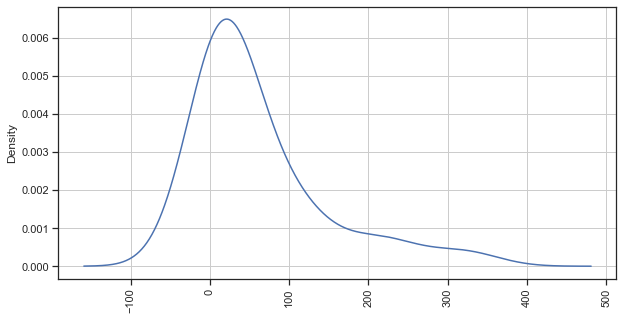

economic.cond.household  economic.cond.national
1                        3                          23
                         1                          15
                         2                          13
                         4                          12
                         5                           2
2                        2                         105
                         3                         101
                         4                          57
                         1                          10
                         5                           7
3                        3                         321
                         4                         200
                         2                          91
                         5                          29
                         1                           7
4                        4                         234
                         3                         136
                 

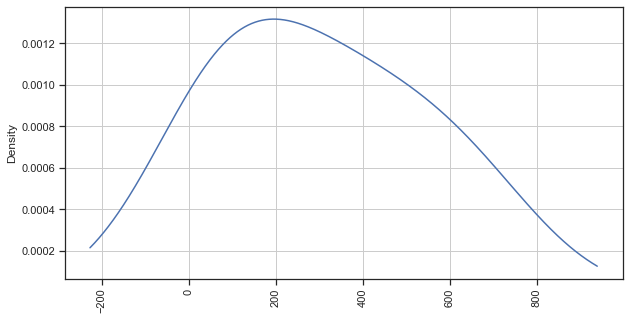

economic.cond.household  economic.cond.household
1                        1                           65
2                        2                          280
3                        3                          648
4                        4                          440
5                        5                           92
Name: economic.cond.household, dtype: int64


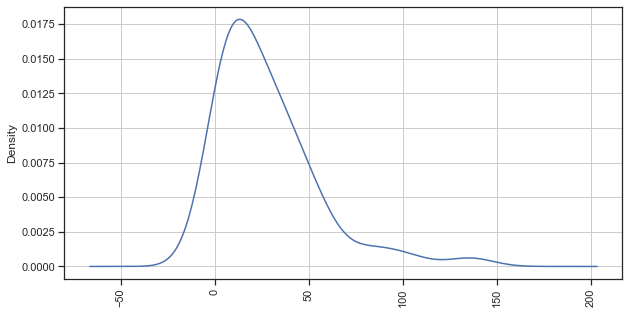

economic.cond.household  Europe
1                        11         17
                         6          10
                         9          10
                         8           7
                         4           6
                         7           5
                         3           3
                         1           2
                         5           2
                         10          2
                         2           1
2                        11         79
                         6          33
                         9          29
                         10         23
                         7          22
                         4          19
                         5          17
                         8          17
                         3          16
                         1          13
                         2          12
3                        11        136
                         6         103
                         5      

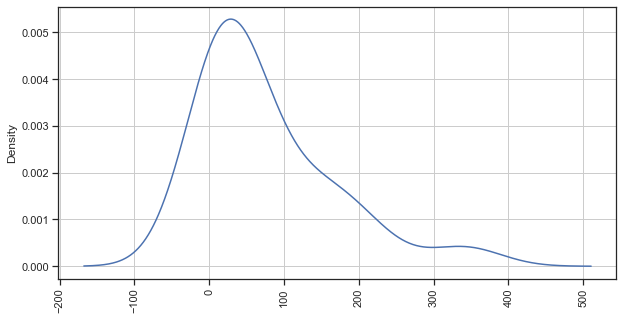

economic.cond.household  political.knowledge
1                        2                       34
                         0                       19
                         3                       10
                         1                        2
2                        2                      153
                         0                       75
                         3                       47
                         1                        5
3                        2                      341
                         0                      185
                         3                      103
                         1                       19
4                        2                      212
                         0                      144
                         3                       74
                         1                       10
5                        2                       42
                         0                       32
                   

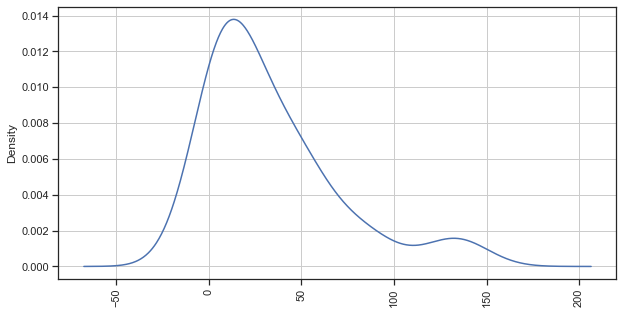

Europe  Blair
1       4         53
        5         33
        2         17
        1          6
2       4         55
        5         15
        2          8
        1          1
3       4         86
        2         20
        5         19
        1          4
4       4         89
        2         24
        5         13
        1          1
5       4         79
        2         31
        5          9
        1          5
6       4        128
        2         55
        5         19
        1          7
7       4         47
        2         27
        1          7
        5          5
8       4         68
        2         30
        1         11
        5          3
9       2         48
        4         47
        5          8
        1          7
        3          1
10      4         50
        2         40
        1          6
        5          5
11      2        138
        4        134
        1         42
        5         24
Name: Blair, dtype: int64


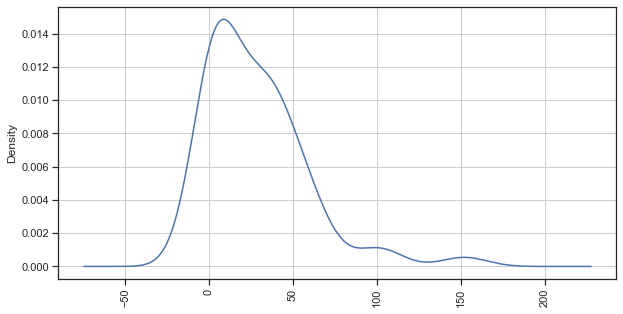

Europe  Hague
1       2         47
        1         33
        4         26
        5          2
        3          1
2       2         36
        4         24
        1         18
        3          1
3       2         63
        1         31
        4         30
        5          3
        3          2
4       2         65
        1         29
        4         29
        3          3
        5          1
5       2         61
        4         43
        1         16
        3          3
        5          1
6       2         99
        4         61
        1         41
        3          7
        5          1
7       4         40
        2         36
        1          5
        5          4
        3          1
8       4         50
        2         47
        1          8
        5          6
        3          1
9       4         49
        2         38
        5         14
        1          8
        3          2
10      4         54
        2         29
        1          9

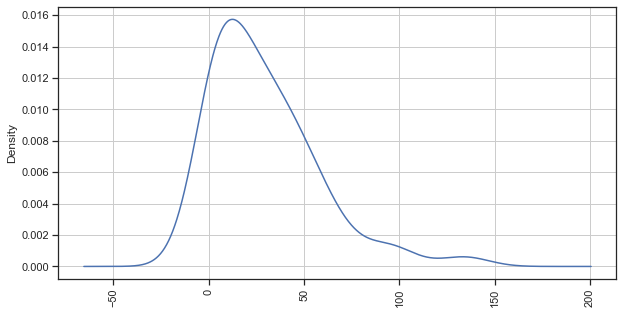

Europe  economic.cond.national
1       3                          43
        4                          42
        5                          16
        2                           6
        1                           2
2       4                          39
        3                          26
        2                           7
        5                           7
3       4                          60
        3                          50
        2                          12
        5                           6
        1                           1
4       4                          54
        3                          46
        2                          17
        5                          10
5       4                          60
        3                          41
        2                          20
        5                           3
6       3                          97
        4                          66
        2                          31
        5          

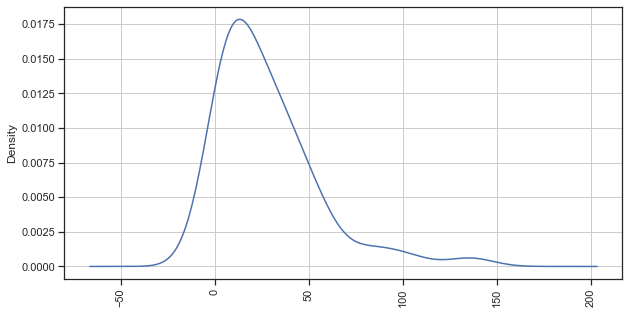

Europe  economic.cond.household
1       3                           48
        4                           34
        2                           13
        5                           12
        1                            2
2       3                           33
        4                           29
        2                           12
        5                            4
        1                            1
3       3                           55
        4                           47
        2                           16
        5                            8
        1                            3
4       3                           55
        4                           37
        2                           19
        5                           10
        1                            6
5       3                           60
        4                           41
        2                           17
        5                            4
        1                       

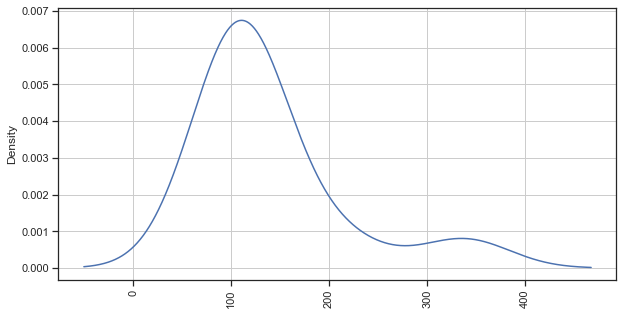

Europe  Europe
1       1         109
2       2          79
3       3         129
4       4         127
5       5         124
6       6         209
7       7          86
8       8         112
9       9         111
10      10        101
11      11        338
Name: Europe, dtype: int64


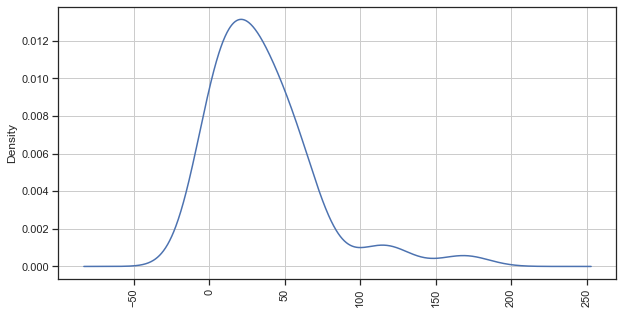

Europe  political.knowledge
1       2                       60
        0                       28
        3                       18
        1                        3
2       2                       45
        3                       26
        0                        7
        1                        1
3       2                       62
        3                       37
        0                       29
        1                        1
4       2                       59
        0                       37
        3                       28
        1                        3
5       2                       62
        3                       33
        0                       28
        1                        1
6       2                      112
        0                       72
        3                       23
        1                        2
7       2                       50
        0                       23
        3                        8
        1                  

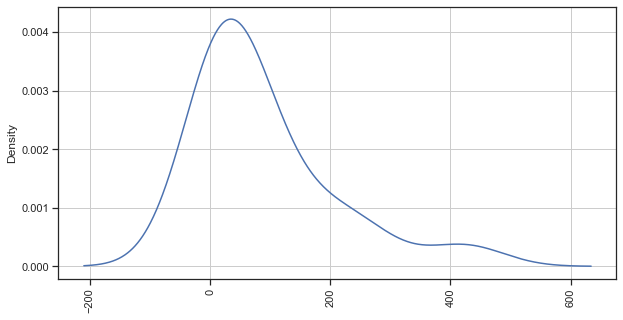

political.knowledge  Blair
0                    4        252
                     2        135
                     5         49
                     1         19
1                    4         23
                     2         12
                     1          2
                     5          1
2                    4        423
                     2        226
                     5         76
                     1         57
3                    4        138
                     2         65
                     5         27
                     1         19
                     3          1
Name: Blair, dtype: int64


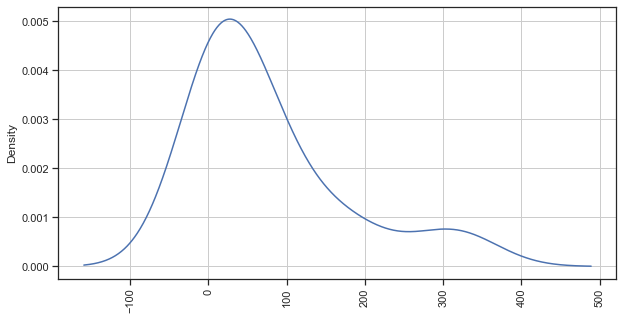

political.knowledge  Hague
0                    2        186
                     4        173
                     1         66
                     5         17
                     3         13
1                    2         14
                     4         11
                     1          5
                     3          5
                     5          3
2                    2        327
                     4        299
                     1        103
                     5         40
                     3         13
3                    2         97
                     4         75
                     1         59
                     5         13
                     3          6
Name: Hague, dtype: int64


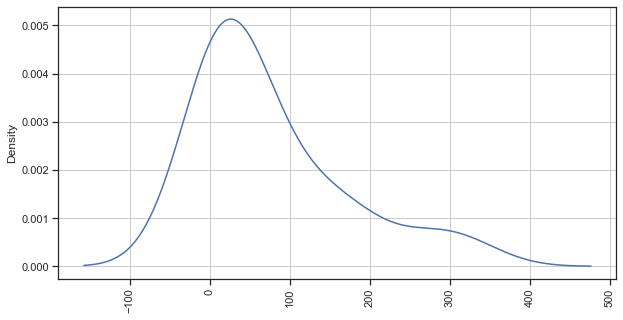

political.knowledge  economic.cond.national
0                    3                         179
                     4                         170
                     2                          63
                     5                          26
                     1                          17
1                    4                          16
                     3                          15
                     2                           5
                     1                           1
                     5                           1
2                    3                         318
                     4                         270
                     2                         138
                     5                          41
                     1                          15
3                    3                          95
                     4                          86
                     2                          51
                     5                

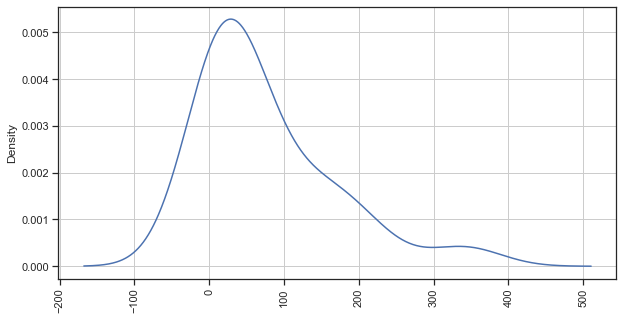

political.knowledge  economic.cond.household
0                    3                          185
                     4                          144
                     2                           75
                     5                           32
                     1                           19
1                    3                           19
                     4                           10
                     2                            5
                     1                            2
                     5                            2
2                    3                          341
                     4                          212
                     2                          153
                     5                           42
                     1                           34
3                    3                          103
                     4                           74
                     2                           47
                   

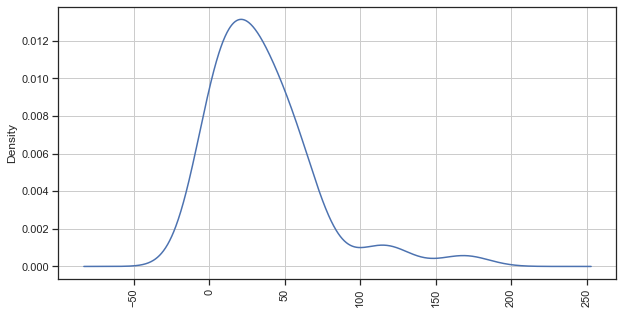

political.knowledge  Europe
0                    11        120
                     6          72
                     9          43
                     8          39
                     4          37
                     3          29
                     10         29
                     1          28
                     5          28
                     7          23
                     2           7
1                    11         15
                     7           5
                     8           4
                     1           3
                     4           3
                     10          3
                     6           2
                     2           1
                     3           1
                     5           1
2                    11        169
                     6         112
                     3          62
                     5          62
                     1          60
                     4          59
                     9     

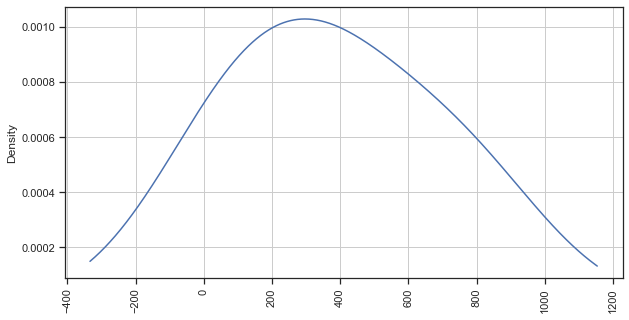

political.knowledge  political.knowledge
0                    0                      455
1                    1                       38
2                    2                      782
3                    3                      250
Name: political.knowledge, dtype: int64


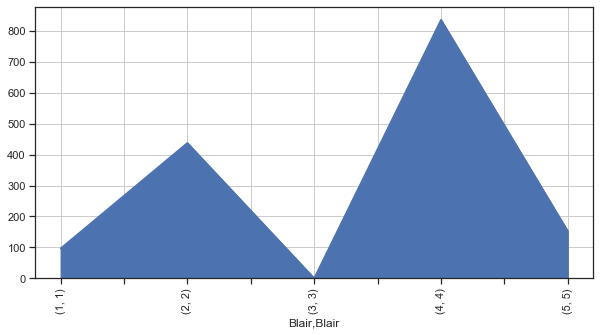

Blair  Blair
1      1         97
2      2        438
3      3          1
4      4        836
5      5        153
Name: Blair, dtype: int64


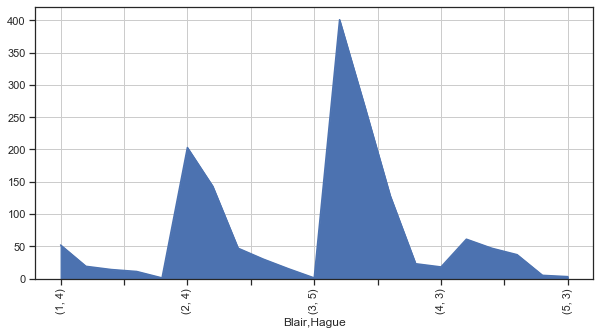

Blair  Hague
1      4         52
       2         19
       5         14
       1         11
       3          1
2      4        203
       2        143
       1         47
       5         30
       3         15
3      5          1
4      2        401
       4        266
       1        128
       5         23
       3         18
5      2         61
       1         47
       4         37
       5          5
       3          3
Name: Hague, dtype: int64


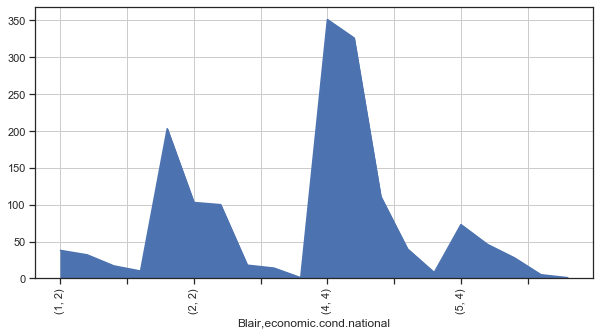

Blair  economic.cond.national
1      2                          38
       3                          32
       4                          17
       1                          10
2      3                         203
       2                         103
       4                         100
       1                          18
       5                          14
3      4                           1
4      4                         351
       3                         326
       2                         111
       5                          40
       1                           8
5      4                          73
       3                          46
       5                          28
       2                           5
       1                           1
Name: economic.cond.national, dtype: int64


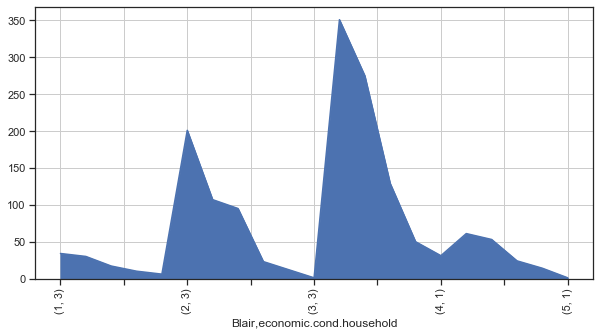

Blair  economic.cond.household
1      3                           34
       2                           30
       4                           17
       1                           10
       5                            6
2      3                          201
       2                          107
       4                           95
       1                           23
       5                           12
3      3                            1
4      3                          351
       4                          275
       2                          129
       5                           50
       1                           31
5      3                           61
       4                           53
       5                           24
       2                           14
       1                            1
Name: economic.cond.household, dtype: int64


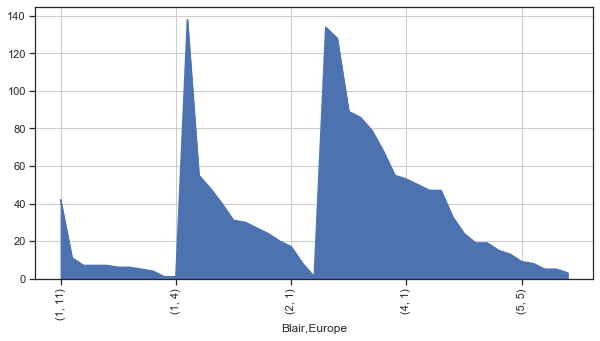

Blair  Europe
1      11         42
       8          11
       6           7
       7           7
       9           7
       1           6
       10          6
       5           5
       3           4
       2           1
       4           1
2      11        138
       6          55
       9          48
       10         40
       5          31
       8          30
       7          27
       4          24
       3          20
       1          17
       2           8
3      9           1
4      11        134
       6         128
       4          89
       3          86
       5          79
       8          68
       2          55
       1          53
       10         50
       7          47
       9          47
5      1          33
       11         24
       3          19
       6          19
       2          15
       4          13
       5           9
       9           8
       7           5
       10          5
       8           3
Name: Europe, dtype: int64


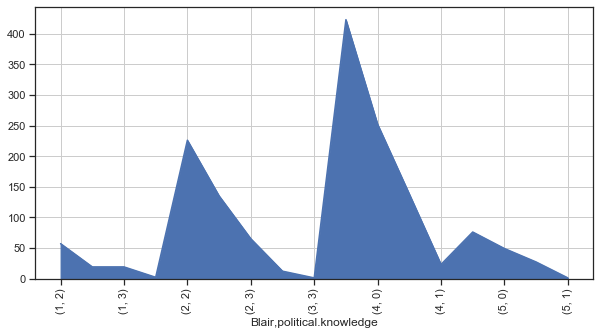

Blair  political.knowledge
1      2                       57
       0                       19
       3                       19
       1                        2
2      2                      226
       0                      135
       3                       65
       1                       12
3      3                        1
4      2                      423
       0                      252
       3                      138
       1                       23
5      2                       76
       0                       49
       3                       27
       1                        1
Name: political.knowledge, dtype: int64


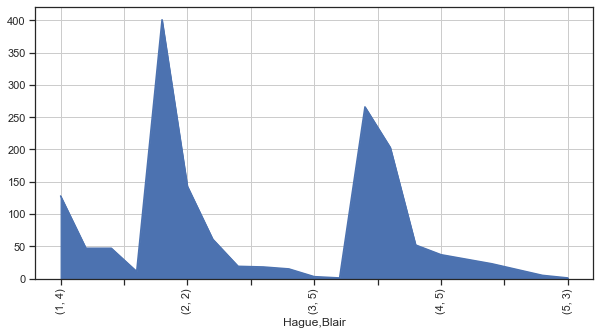

Hague  Blair
1      4        128
       2         47
       5         47
       1         11
2      4        401
       2        143
       5         61
       1         19
3      4         18
       2         15
       5          3
       1          1
4      4        266
       2        203
       1         52
       5         37
5      2         30
       4         23
       1         14
       5          5
       3          1
Name: Blair, dtype: int64


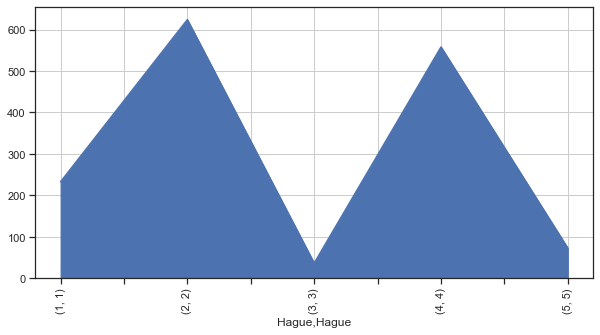

Hague  Hague
1      1        233
2      2        624
3      3         37
4      4        558
5      5         73
Name: Hague, dtype: int64


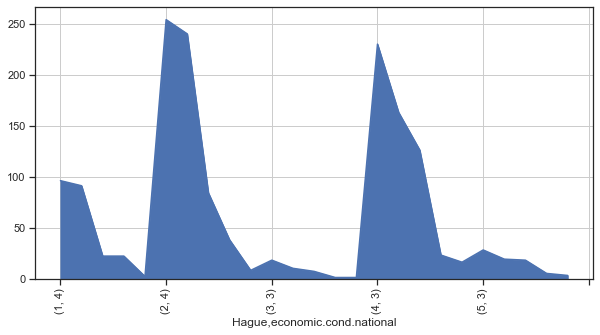

Hague  economic.cond.national
1      4                          96
       3                          91
       2                          22
       5                          22
       1                           2
2      4                         254
       3                         240
       2                          84
       5                          38
       1                           8
3      3                          18
       4                          10
       2                           7
       1                           1
       5                           1
4      3                         230
       4                         163
       2                         126
       1                          23
       5                          16
5      3                          28
       4                          19
       2                          18
       5                           5
       1                           3
Name: economic.cond.national, dtype: int64


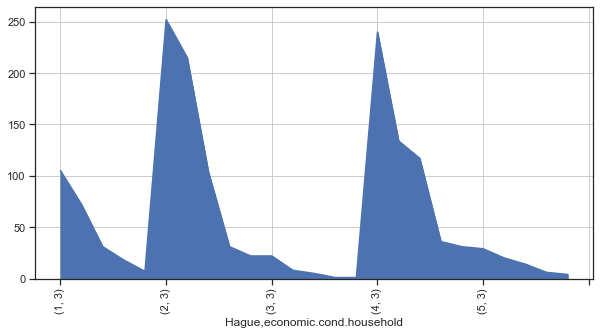

Hague  economic.cond.household
1      3                          105
       4                           72
       2                           31
       5                           18
       1                            7
2      3                          252
       4                          215
       2                          104
       5                           31
       1                           22
3      3                           22
       2                            8
       4                            5
       1                            1
       5                            1
4      3                          240
       4                          134
       2                          117
       5                           36
       1                           31
5      3                           29
       2                           20
       4                           14
       5                            6
       1                            4
Name: economic.cond

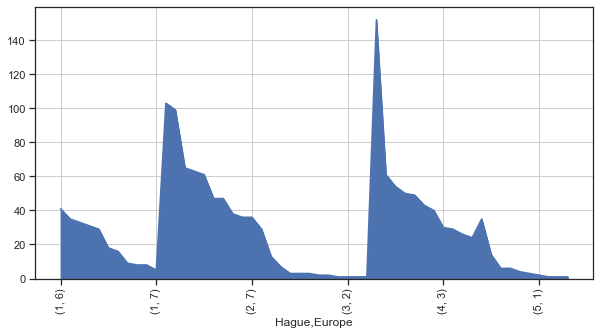

Hague  Europe
1      6          41
       11         35
       1          33
       3          31
       4          29
       2          18
       5          16
       10          9
       8           8
       9           8
       7           5
2      11        103
       6          99
       4          65
       3          63
       5          61
       1          47
       8          47
       9          38
       2          36
       7          36
       10         29
3      11         13
       6           7
       4           3
       5           3
       10          3
       3           2
       9           2
       1           1
       2           1
       7           1
       8           1
4      11        152
       6          61
       10         54
       8          50
       9          49
       5          43
       7          40
       3          30
       4          29
       1          26
       2          24
5      11         35
       9          14
       8           6

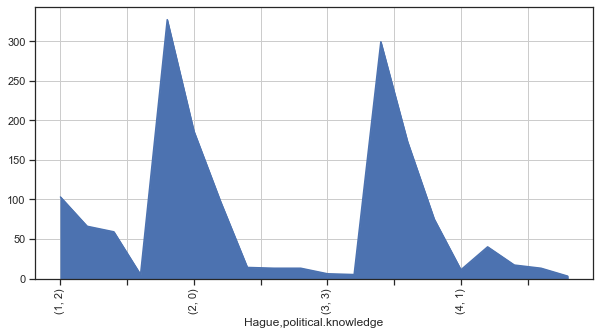

Hague  political.knowledge
1      2                      103
       0                       66
       3                       59
       1                        5
2      2                      327
       0                      186
       3                       97
       1                       14
3      0                       13
       2                       13
       3                        6
       1                        5
4      2                      299
       0                      173
       3                       75
       1                       11
5      2                       40
       0                       17
       3                       13
       1                        3
Name: political.knowledge, dtype: int64


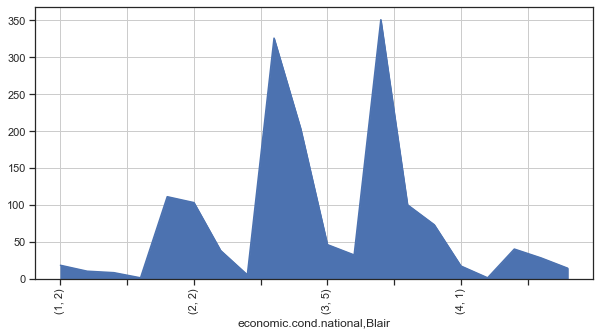

economic.cond.national  Blair
1                       2         18
                        1         10
                        4          8
                        5          1
2                       4        111
                        2        103
                        1         38
                        5          5
3                       4        326
                        2        203
                        5         46
                        1         32
4                       4        351
                        2        100
                        5         73
                        1         17
                        3          1
5                       4         40
                        5         28
                        2         14
Name: Blair, dtype: int64


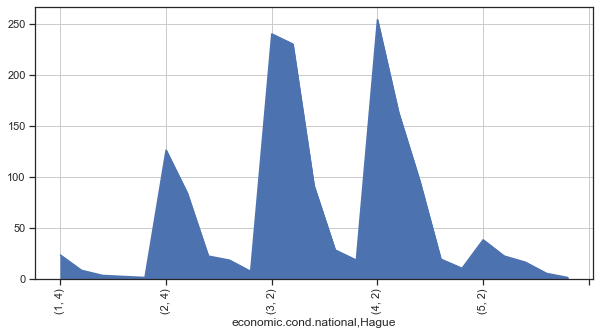

economic.cond.national  Hague
1                       4         23
                        2          8
                        5          3
                        1          2
                        3          1
2                       4        126
                        2         84
                        1         22
                        5         18
                        3          7
3                       2        240
                        4        230
                        1         91
                        5         28
                        3         18
4                       2        254
                        4        163
                        1         96
                        5         19
                        3         10
5                       2         38
                        1         22
                        4         16
                        5          5
                        3          1
Name: Hague, dtype: int64


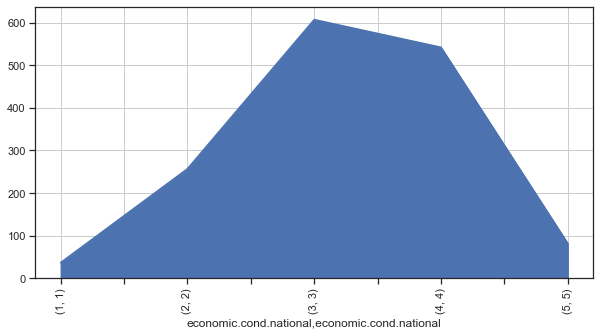

economic.cond.national  economic.cond.national
1                       1                          37
2                       2                         257
3                       3                         607
4                       4                         542
5                       5                          82
Name: economic.cond.national, dtype: int64


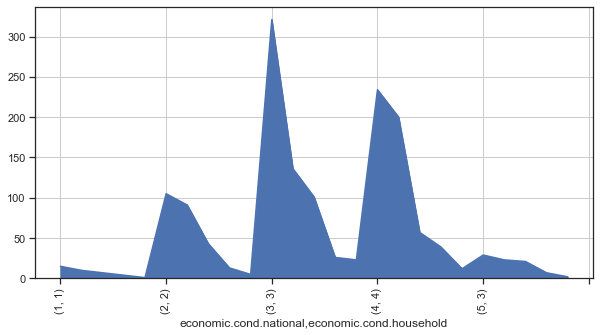

economic.cond.national  economic.cond.household
1                       1                           15
                        2                           10
                        3                            7
                        4                            4
                        5                            1
2                       2                          105
                        3                           91
                        4                           43
                        1                           13
                        5                            5
3                       3                          321
                        4                          136
                        2                          101
                        5                           26
                        1                           23
4                       4                          234
                        3                          200
                 

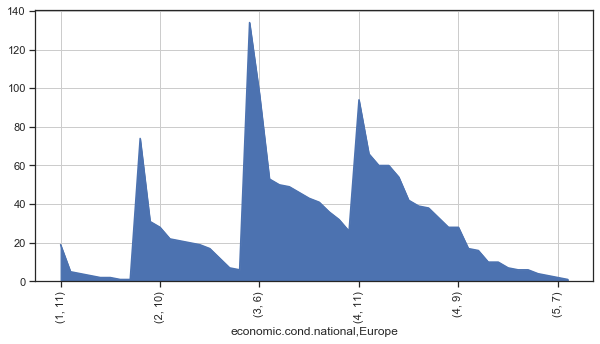

economic.cond.national  Europe
1                       11         19
                        6           5
                        8           4
                        9           3
                        1           2
                        10          2
                        3           1
                        7           1
2                       11         74
                        6          31
                        10         28
                        8          22
                        9          21
                        5          20
                        7          19
                        4          17
                        3          12
                        2           7
                        1           6
3                       11        134
                        6          97
                        9          53
                        3          50
                        8          49
                        4          46
                   

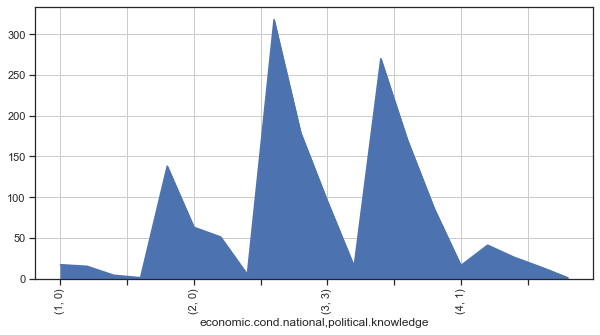

economic.cond.national  political.knowledge
1                       0                       17
                        2                       15
                        3                        4
                        1                        1
2                       2                      138
                        0                       63
                        3                       51
                        1                        5
3                       2                      318
                        0                      179
                        3                       95
                        1                       15
4                       2                      270
                        0                      170
                        3                       86
                        1                       16
5                       2                       41
                        0                       26
                        3             

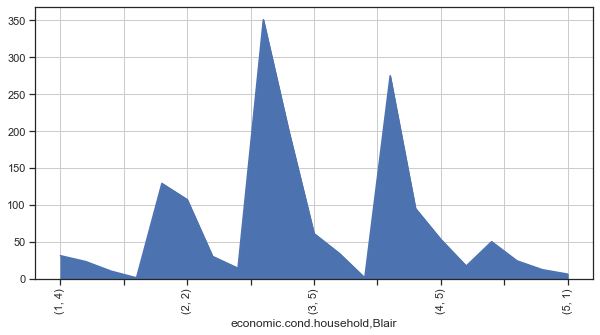

economic.cond.household  Blair
1                        4         31
                         2         23
                         1         10
                         5          1
2                        4        129
                         2        107
                         1         30
                         5         14
3                        4        351
                         2        201
                         5         61
                         1         34
                         3          1
4                        4        275
                         2         95
                         5         53
                         1         17
5                        4         50
                         5         24
                         2         12
                         1          6
Name: Blair, dtype: int64


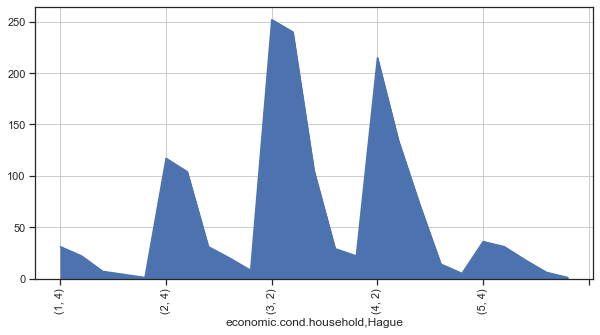

economic.cond.household  Hague
1                        4         31
                         2         22
                         1          7
                         5          4
                         3          1
2                        4        117
                         2        104
                         1         31
                         5         20
                         3          8
3                        2        252
                         4        240
                         1        105
                         5         29
                         3         22
4                        2        215
                         4        134
                         1         72
                         5         14
                         3          5
5                        4         36
                         2         31
                         1         18
                         5          6
                         3          1
Name: Hague, dtype:

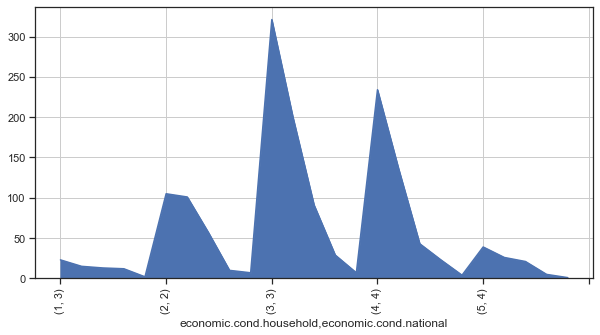

economic.cond.household  economic.cond.national
1                        3                          23
                         1                          15
                         2                          13
                         4                          12
                         5                           2
2                        2                         105
                         3                         101
                         4                          57
                         1                          10
                         5                           7
3                        3                         321
                         4                         200
                         2                          91
                         5                          29
                         1                           7
4                        4                         234
                         3                         136
                 

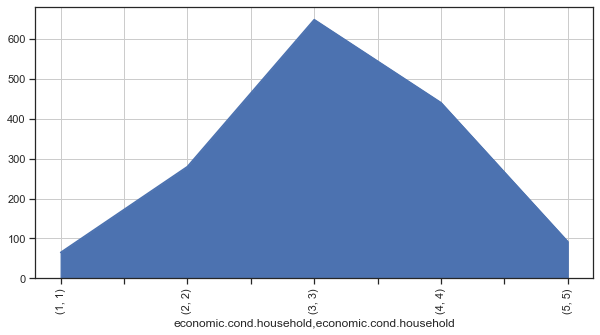

economic.cond.household  economic.cond.household
1                        1                           65
2                        2                          280
3                        3                          648
4                        4                          440
5                        5                           92
Name: economic.cond.household, dtype: int64


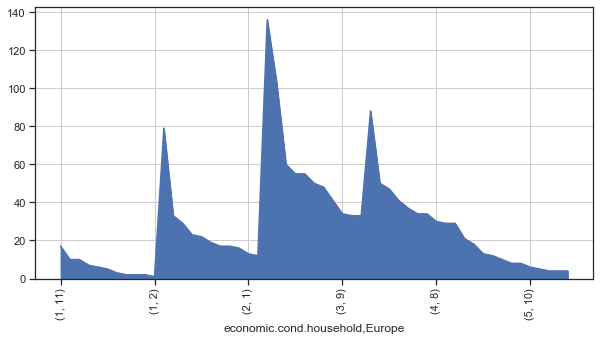

economic.cond.household  Europe
1                        11         17
                         6          10
                         9          10
                         8           7
                         4           6
                         7           5
                         3           3
                         1           2
                         5           2
                         10          2
                         2           1
2                        11         79
                         6          33
                         9          29
                         10         23
                         7          22
                         4          19
                         5          17
                         8          17
                         3          16
                         1          13
                         2          12
3                        11        136
                         6         103
                         5      

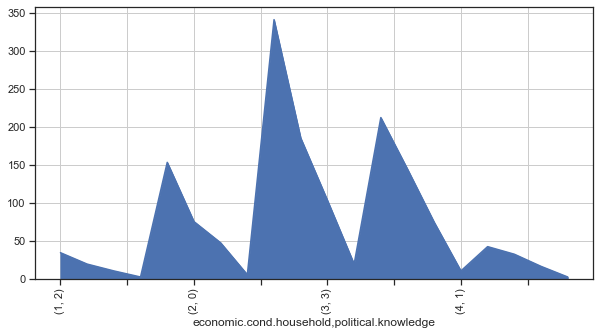

economic.cond.household  political.knowledge
1                        2                       34
                         0                       19
                         3                       10
                         1                        2
2                        2                      153
                         0                       75
                         3                       47
                         1                        5
3                        2                      341
                         0                      185
                         3                      103
                         1                       19
4                        2                      212
                         0                      144
                         3                       74
                         1                       10
5                        2                       42
                         0                       32
                   

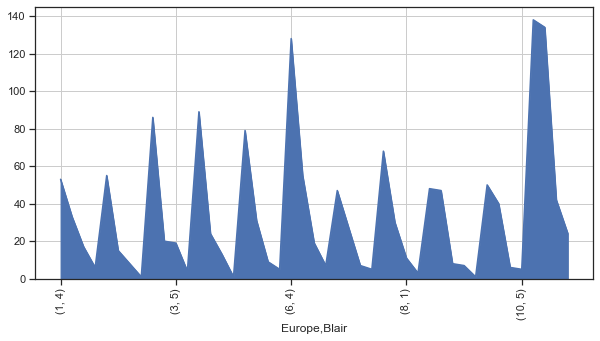

Europe  Blair
1       4         53
        5         33
        2         17
        1          6
2       4         55
        5         15
        2          8
        1          1
3       4         86
        2         20
        5         19
        1          4
4       4         89
        2         24
        5         13
        1          1
5       4         79
        2         31
        5          9
        1          5
6       4        128
        2         55
        5         19
        1          7
7       4         47
        2         27
        1          7
        5          5
8       4         68
        2         30
        1         11
        5          3
9       2         48
        4         47
        5          8
        1          7
        3          1
10      4         50
        2         40
        1          6
        5          5
11      2        138
        4        134
        1         42
        5         24
Name: Blair, dtype: int64


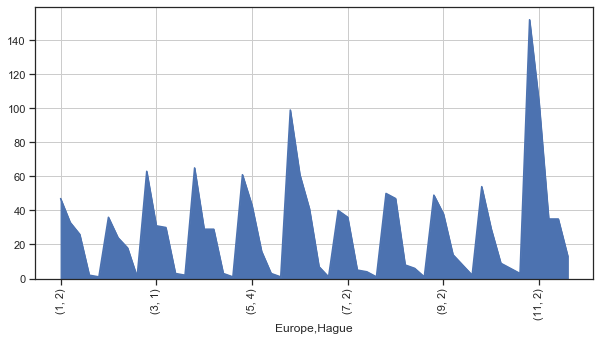

Europe  Hague
1       2         47
        1         33
        4         26
        5          2
        3          1
2       2         36
        4         24
        1         18
        3          1
3       2         63
        1         31
        4         30
        5          3
        3          2
4       2         65
        1         29
        4         29
        3          3
        5          1
5       2         61
        4         43
        1         16
        3          3
        5          1
6       2         99
        4         61
        1         41
        3          7
        5          1
7       4         40
        2         36
        1          5
        5          4
        3          1
8       4         50
        2         47
        1          8
        5          6
        3          1
9       4         49
        2         38
        5         14
        1          8
        3          2
10      4         54
        2         29
        1          9

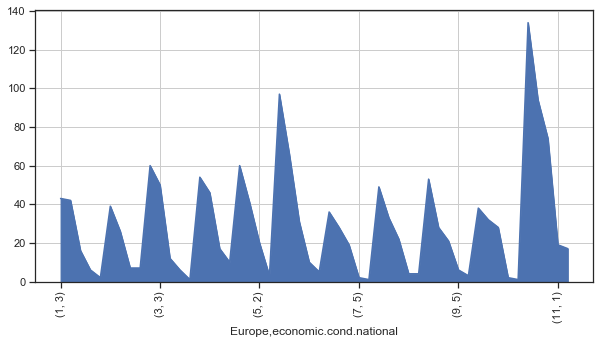

Europe  economic.cond.national
1       3                          43
        4                          42
        5                          16
        2                           6
        1                           2
2       4                          39
        3                          26
        2                           7
        5                           7
3       4                          60
        3                          50
        2                          12
        5                           6
        1                           1
4       4                          54
        3                          46
        2                          17
        5                          10
5       4                          60
        3                          41
        2                          20
        5                           3
6       3                          97
        4                          66
        2                          31
        5          

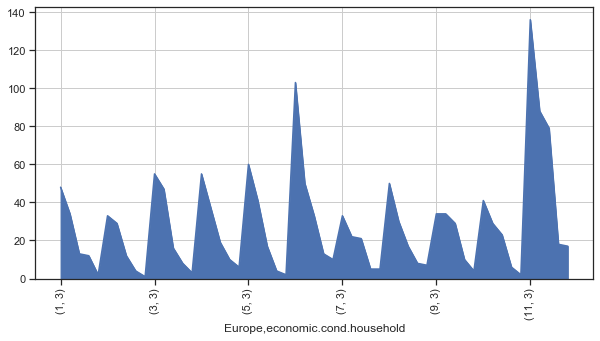

Europe  economic.cond.household
1       3                           48
        4                           34
        2                           13
        5                           12
        1                            2
2       3                           33
        4                           29
        2                           12
        5                            4
        1                            1
3       3                           55
        4                           47
        2                           16
        5                            8
        1                            3
4       3                           55
        4                           37
        2                           19
        5                           10
        1                            6
5       3                           60
        4                           41
        2                           17
        5                            4
        1                       

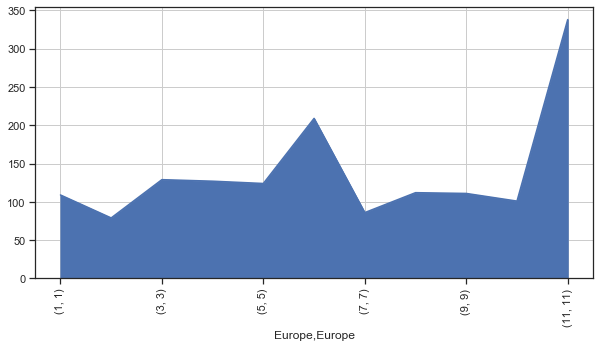

Europe  Europe
1       1         109
2       2          79
3       3         129
4       4         127
5       5         124
6       6         209
7       7          86
8       8         112
9       9         111
10      10        101
11      11        338
Name: Europe, dtype: int64


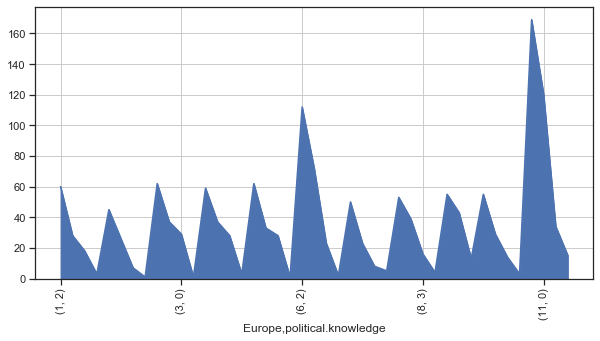

Europe  political.knowledge
1       2                       60
        0                       28
        3                       18
        1                        3
2       2                       45
        3                       26
        0                        7
        1                        1
3       2                       62
        3                       37
        0                       29
        1                        1
4       2                       59
        0                       37
        3                       28
        1                        3
5       2                       62
        3                       33
        0                       28
        1                        1
6       2                      112
        0                       72
        3                       23
        1                        2
7       2                       50
        0                       23
        3                        8
        1                  

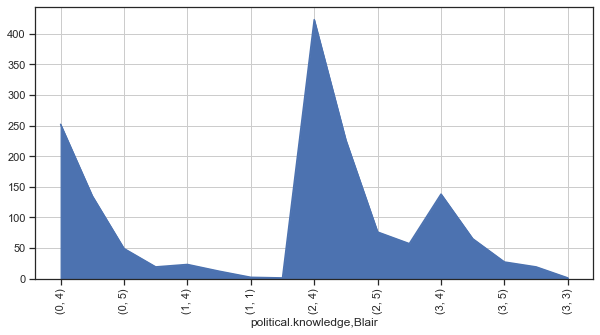

political.knowledge  Blair
0                    4        252
                     2        135
                     5         49
                     1         19
1                    4         23
                     2         12
                     1          2
                     5          1
2                    4        423
                     2        226
                     5         76
                     1         57
3                    4        138
                     2         65
                     5         27
                     1         19
                     3          1
Name: Blair, dtype: int64


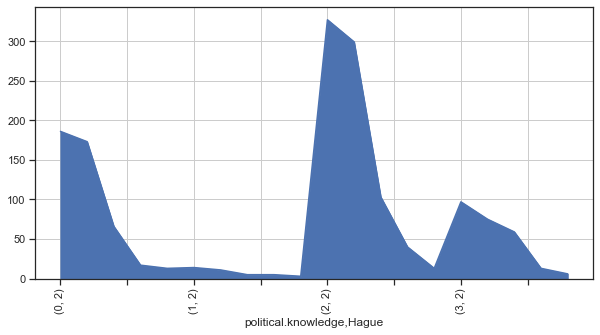

political.knowledge  Hague
0                    2        186
                     4        173
                     1         66
                     5         17
                     3         13
1                    2         14
                     4         11
                     1          5
                     3          5
                     5          3
2                    2        327
                     4        299
                     1        103
                     5         40
                     3         13
3                    2         97
                     4         75
                     1         59
                     5         13
                     3          6
Name: Hague, dtype: int64


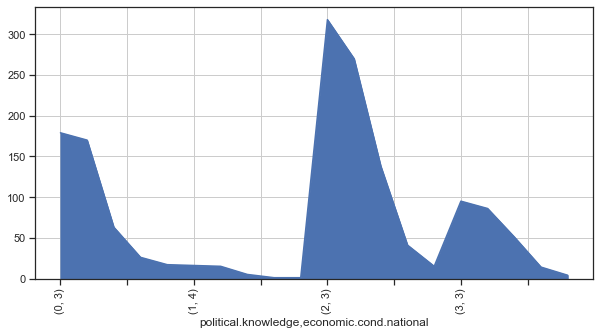

political.knowledge  economic.cond.national
0                    3                         179
                     4                         170
                     2                          63
                     5                          26
                     1                          17
1                    4                          16
                     3                          15
                     2                           5
                     1                           1
                     5                           1
2                    3                         318
                     4                         270
                     2                         138
                     5                          41
                     1                          15
3                    3                          95
                     4                          86
                     2                          51
                     5                

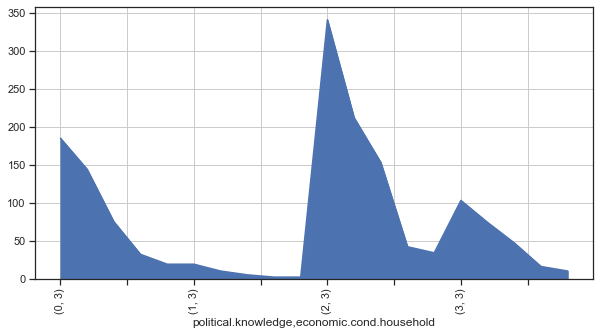

political.knowledge  economic.cond.household
0                    3                          185
                     4                          144
                     2                           75
                     5                           32
                     1                           19
1                    3                           19
                     4                           10
                     2                            5
                     1                            2
                     5                            2
2                    3                          341
                     4                          212
                     2                          153
                     5                           42
                     1                           34
3                    3                          103
                     4                           74
                     2                           47
                   

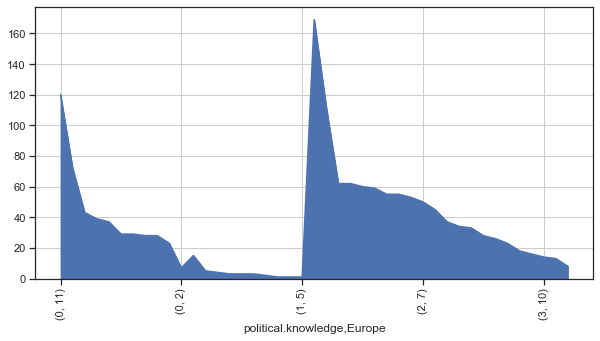

political.knowledge  Europe
0                    11        120
                     6          72
                     9          43
                     8          39
                     4          37
                     3          29
                     10         29
                     1          28
                     5          28
                     7          23
                     2           7
1                    11         15
                     7           5
                     8           4
                     1           3
                     4           3
                     10          3
                     6           2
                     2           1
                     3           1
                     5           1
2                    11        169
                     6         112
                     3          62
                     5          62
                     1          60
                     4          59
                     9     

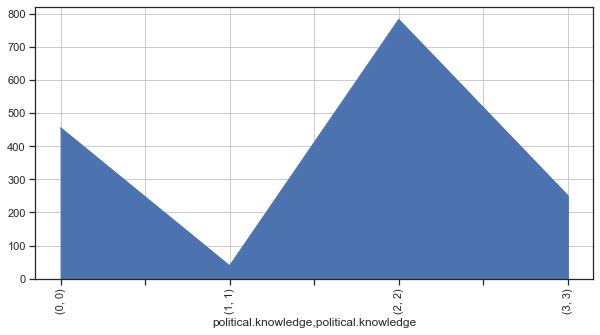

political.knowledge  political.knowledge
0                    0                      455
1                    1                       38
2                    2                      782
3                    3                      250
Name: political.knowledge, dtype: int64


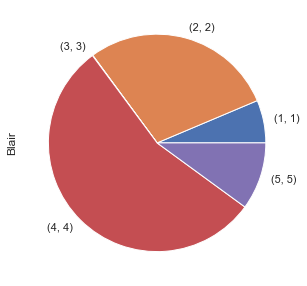

Blair  Blair
1      1         97
2      2        438
3      3          1
4      4        836
5      5        153
Name: Blair, dtype: int64


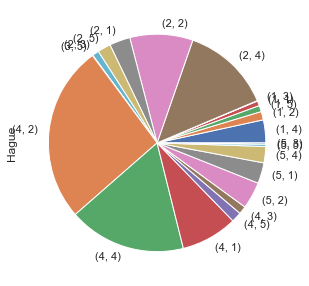

Blair  Hague
1      4         52
       2         19
       5         14
       1         11
       3          1
2      4        203
       2        143
       1         47
       5         30
       3         15
3      5          1
4      2        401
       4        266
       1        128
       5         23
       3         18
5      2         61
       1         47
       4         37
       5          5
       3          3
Name: Hague, dtype: int64


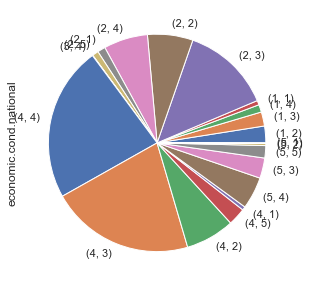

Blair  economic.cond.national
1      2                          38
       3                          32
       4                          17
       1                          10
2      3                         203
       2                         103
       4                         100
       1                          18
       5                          14
3      4                           1
4      4                         351
       3                         326
       2                         111
       5                          40
       1                           8
5      4                          73
       3                          46
       5                          28
       2                           5
       1                           1
Name: economic.cond.national, dtype: int64


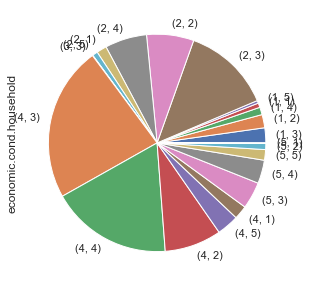

Blair  economic.cond.household
1      3                           34
       2                           30
       4                           17
       1                           10
       5                            6
2      3                          201
       2                          107
       4                           95
       1                           23
       5                           12
3      3                            1
4      3                          351
       4                          275
       2                          129
       5                           50
       1                           31
5      3                           61
       4                           53
       5                           24
       2                           14
       1                            1
Name: economic.cond.household, dtype: int64


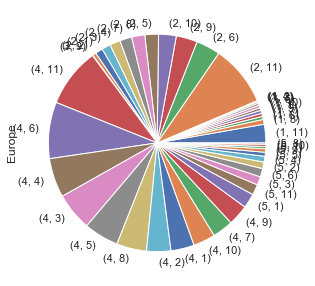

Blair  Europe
1      11         42
       8          11
       6           7
       7           7
       9           7
       1           6
       10          6
       5           5
       3           4
       2           1
       4           1
2      11        138
       6          55
       9          48
       10         40
       5          31
       8          30
       7          27
       4          24
       3          20
       1          17
       2           8
3      9           1
4      11        134
       6         128
       4          89
       3          86
       5          79
       8          68
       2          55
       1          53
       10         50
       7          47
       9          47
5      1          33
       11         24
       3          19
       6          19
       2          15
       4          13
       5           9
       9           8
       7           5
       10          5
       8           3
Name: Europe, dtype: int64


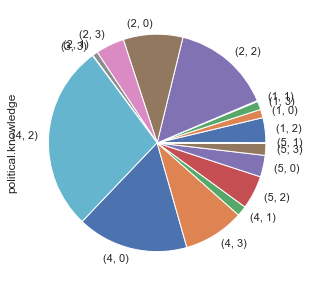

Blair  political.knowledge
1      2                       57
       0                       19
       3                       19
       1                        2
2      2                      226
       0                      135
       3                       65
       1                       12
3      3                        1
4      2                      423
       0                      252
       3                      138
       1                       23
5      2                       76
       0                       49
       3                       27
       1                        1
Name: political.knowledge, dtype: int64


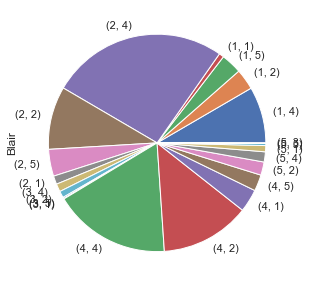

Hague  Blair
1      4        128
       2         47
       5         47
       1         11
2      4        401
       2        143
       5         61
       1         19
3      4         18
       2         15
       5          3
       1          1
4      4        266
       2        203
       1         52
       5         37
5      2         30
       4         23
       1         14
       5          5
       3          1
Name: Blair, dtype: int64


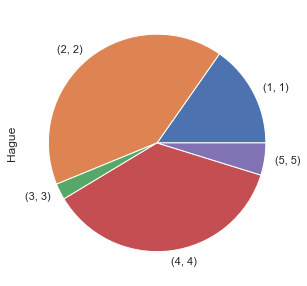

Hague  Hague
1      1        233
2      2        624
3      3         37
4      4        558
5      5         73
Name: Hague, dtype: int64


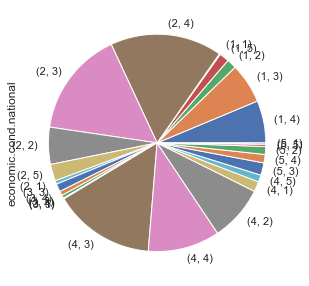

Hague  economic.cond.national
1      4                          96
       3                          91
       2                          22
       5                          22
       1                           2
2      4                         254
       3                         240
       2                          84
       5                          38
       1                           8
3      3                          18
       4                          10
       2                           7
       1                           1
       5                           1
4      3                         230
       4                         163
       2                         126
       1                          23
       5                          16
5      3                          28
       4                          19
       2                          18
       5                           5
       1                           3
Name: economic.cond.national, dtype: int64


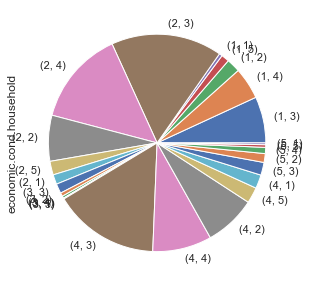

Hague  economic.cond.household
1      3                          105
       4                           72
       2                           31
       5                           18
       1                            7
2      3                          252
       4                          215
       2                          104
       5                           31
       1                           22
3      3                           22
       2                            8
       4                            5
       1                            1
       5                            1
4      3                          240
       4                          134
       2                          117
       5                           36
       1                           31
5      3                           29
       2                           20
       4                           14
       5                            6
       1                            4
Name: economic.cond

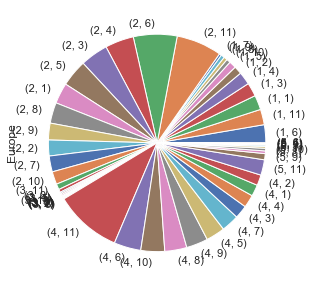

Hague  Europe
1      6          41
       11         35
       1          33
       3          31
       4          29
       2          18
       5          16
       10          9
       8           8
       9           8
       7           5
2      11        103
       6          99
       4          65
       3          63
       5          61
       1          47
       8          47
       9          38
       2          36
       7          36
       10         29
3      11         13
       6           7
       4           3
       5           3
       10          3
       3           2
       9           2
       1           1
       2           1
       7           1
       8           1
4      11        152
       6          61
       10         54
       8          50
       9          49
       5          43
       7          40
       3          30
       4          29
       1          26
       2          24
5      11         35
       9          14
       8           6

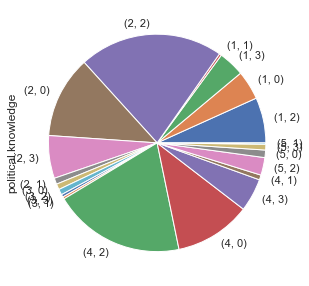

Hague  political.knowledge
1      2                      103
       0                       66
       3                       59
       1                        5
2      2                      327
       0                      186
       3                       97
       1                       14
3      0                       13
       2                       13
       3                        6
       1                        5
4      2                      299
       0                      173
       3                       75
       1                       11
5      2                       40
       0                       17
       3                       13
       1                        3
Name: political.knowledge, dtype: int64


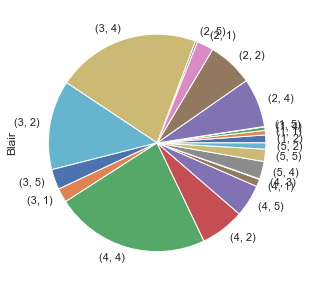

economic.cond.national  Blair
1                       2         18
                        1         10
                        4          8
                        5          1
2                       4        111
                        2        103
                        1         38
                        5          5
3                       4        326
                        2        203
                        5         46
                        1         32
4                       4        351
                        2        100
                        5         73
                        1         17
                        3          1
5                       4         40
                        5         28
                        2         14
Name: Blair, dtype: int64


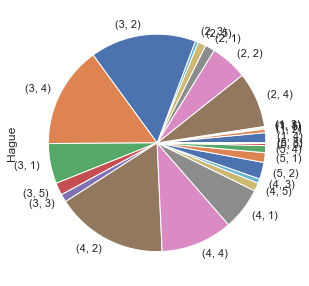

economic.cond.national  Hague
1                       4         23
                        2          8
                        5          3
                        1          2
                        3          1
2                       4        126
                        2         84
                        1         22
                        5         18
                        3          7
3                       2        240
                        4        230
                        1         91
                        5         28
                        3         18
4                       2        254
                        4        163
                        1         96
                        5         19
                        3         10
5                       2         38
                        1         22
                        4         16
                        5          5
                        3          1
Name: Hague, dtype: int64


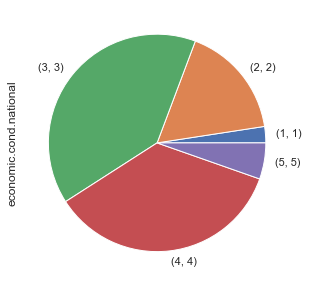

economic.cond.national  economic.cond.national
1                       1                          37
2                       2                         257
3                       3                         607
4                       4                         542
5                       5                          82
Name: economic.cond.national, dtype: int64


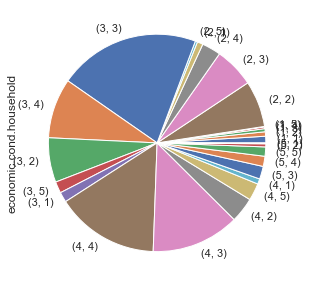

economic.cond.national  economic.cond.household
1                       1                           15
                        2                           10
                        3                            7
                        4                            4
                        5                            1
2                       2                          105
                        3                           91
                        4                           43
                        1                           13
                        5                            5
3                       3                          321
                        4                          136
                        2                          101
                        5                           26
                        1                           23
4                       4                          234
                        3                          200
                 

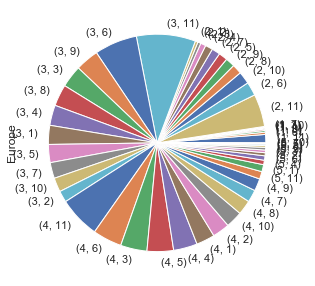

economic.cond.national  Europe
1                       11         19
                        6           5
                        8           4
                        9           3
                        1           2
                        10          2
                        3           1
                        7           1
2                       11         74
                        6          31
                        10         28
                        8          22
                        9          21
                        5          20
                        7          19
                        4          17
                        3          12
                        2           7
                        1           6
3                       11        134
                        6          97
                        9          53
                        3          50
                        8          49
                        4          46
                   

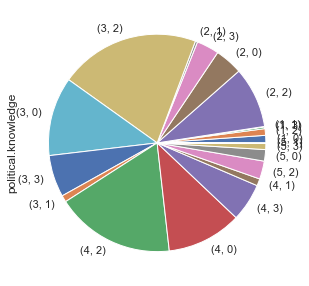

economic.cond.national  political.knowledge
1                       0                       17
                        2                       15
                        3                        4
                        1                        1
2                       2                      138
                        0                       63
                        3                       51
                        1                        5
3                       2                      318
                        0                      179
                        3                       95
                        1                       15
4                       2                      270
                        0                      170
                        3                       86
                        1                       16
5                       2                       41
                        0                       26
                        3             

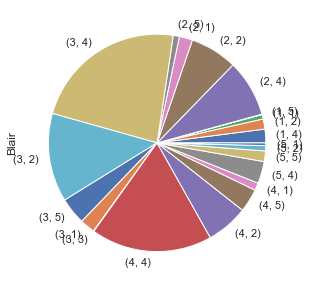

economic.cond.household  Blair
1                        4         31
                         2         23
                         1         10
                         5          1
2                        4        129
                         2        107
                         1         30
                         5         14
3                        4        351
                         2        201
                         5         61
                         1         34
                         3          1
4                        4        275
                         2         95
                         5         53
                         1         17
5                        4         50
                         5         24
                         2         12
                         1          6
Name: Blair, dtype: int64


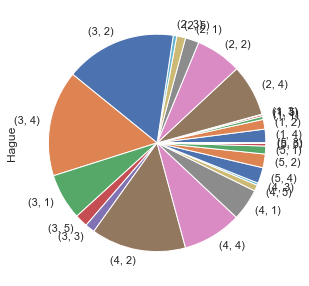

economic.cond.household  Hague
1                        4         31
                         2         22
                         1          7
                         5          4
                         3          1
2                        4        117
                         2        104
                         1         31
                         5         20
                         3          8
3                        2        252
                         4        240
                         1        105
                         5         29
                         3         22
4                        2        215
                         4        134
                         1         72
                         5         14
                         3          5
5                        4         36
                         2         31
                         1         18
                         5          6
                         3          1
Name: Hague, dtype:

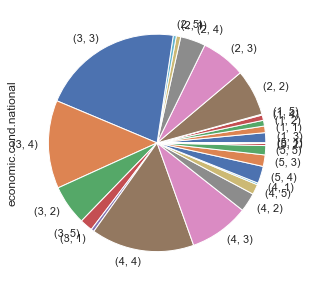

economic.cond.household  economic.cond.national
1                        3                          23
                         1                          15
                         2                          13
                         4                          12
                         5                           2
2                        2                         105
                         3                         101
                         4                          57
                         1                          10
                         5                           7
3                        3                         321
                         4                         200
                         2                          91
                         5                          29
                         1                           7
4                        4                         234
                         3                         136
                 

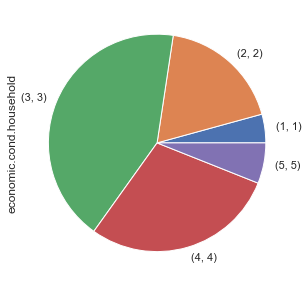

economic.cond.household  economic.cond.household
1                        1                           65
2                        2                          280
3                        3                          648
4                        4                          440
5                        5                           92
Name: economic.cond.household, dtype: int64


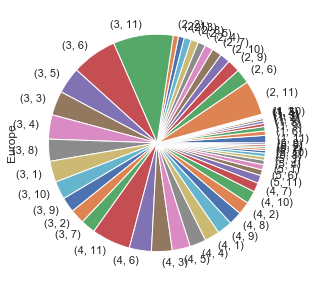

economic.cond.household  Europe
1                        11         17
                         6          10
                         9          10
                         8           7
                         4           6
                         7           5
                         3           3
                         1           2
                         5           2
                         10          2
                         2           1
2                        11         79
                         6          33
                         9          29
                         10         23
                         7          22
                         4          19
                         5          17
                         8          17
                         3          16
                         1          13
                         2          12
3                        11        136
                         6         103
                         5      

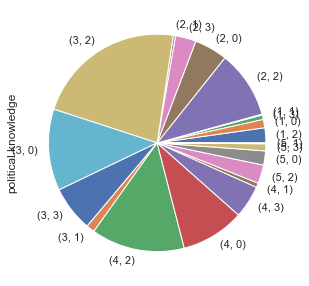

economic.cond.household  political.knowledge
1                        2                       34
                         0                       19
                         3                       10
                         1                        2
2                        2                      153
                         0                       75
                         3                       47
                         1                        5
3                        2                      341
                         0                      185
                         3                      103
                         1                       19
4                        2                      212
                         0                      144
                         3                       74
                         1                       10
5                        2                       42
                         0                       32
                   

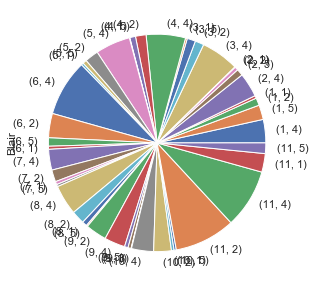

Europe  Blair
1       4         53
        5         33
        2         17
        1          6
2       4         55
        5         15
        2          8
        1          1
3       4         86
        2         20
        5         19
        1          4
4       4         89
        2         24
        5         13
        1          1
5       4         79
        2         31
        5          9
        1          5
6       4        128
        2         55
        5         19
        1          7
7       4         47
        2         27
        1          7
        5          5
8       4         68
        2         30
        1         11
        5          3
9       2         48
        4         47
        5          8
        1          7
        3          1
10      4         50
        2         40
        1          6
        5          5
11      2        138
        4        134
        1         42
        5         24
Name: Blair, dtype: int64


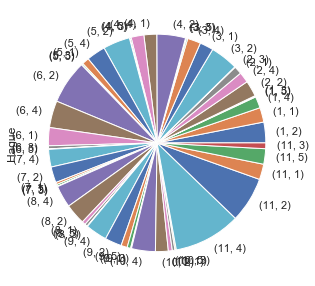

Europe  Hague
1       2         47
        1         33
        4         26
        5          2
        3          1
2       2         36
        4         24
        1         18
        3          1
3       2         63
        1         31
        4         30
        5          3
        3          2
4       2         65
        1         29
        4         29
        3          3
        5          1
5       2         61
        4         43
        1         16
        3          3
        5          1
6       2         99
        4         61
        1         41
        3          7
        5          1
7       4         40
        2         36
        1          5
        5          4
        3          1
8       4         50
        2         47
        1          8
        5          6
        3          1
9       4         49
        2         38
        5         14
        1          8
        3          2
10      4         54
        2         29
        1          9

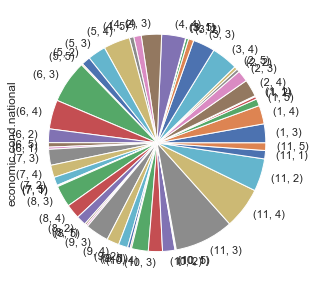

Europe  economic.cond.national
1       3                          43
        4                          42
        5                          16
        2                           6
        1                           2
2       4                          39
        3                          26
        2                           7
        5                           7
3       4                          60
        3                          50
        2                          12
        5                           6
        1                           1
4       4                          54
        3                          46
        2                          17
        5                          10
5       4                          60
        3                          41
        2                          20
        5                           3
6       3                          97
        4                          66
        2                          31
        5          

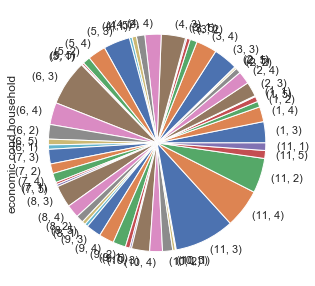

Europe  economic.cond.household
1       3                           48
        4                           34
        2                           13
        5                           12
        1                            2
2       3                           33
        4                           29
        2                           12
        5                            4
        1                            1
3       3                           55
        4                           47
        2                           16
        5                            8
        1                            3
4       3                           55
        4                           37
        2                           19
        5                           10
        1                            6
5       3                           60
        4                           41
        2                           17
        5                            4
        1                       

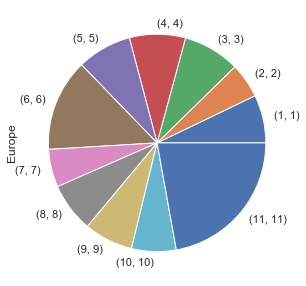

Europe  Europe
1       1         109
2       2          79
3       3         129
4       4         127
5       5         124
6       6         209
7       7          86
8       8         112
9       9         111
10      10        101
11      11        338
Name: Europe, dtype: int64


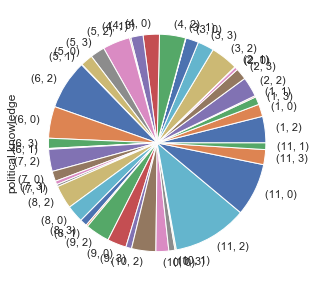

Europe  political.knowledge
1       2                       60
        0                       28
        3                       18
        1                        3
2       2                       45
        3                       26
        0                        7
        1                        1
3       2                       62
        3                       37
        0                       29
        1                        1
4       2                       59
        0                       37
        3                       28
        1                        3
5       2                       62
        3                       33
        0                       28
        1                        1
6       2                      112
        0                       72
        3                       23
        1                        2
7       2                       50
        0                       23
        3                        8
        1                  

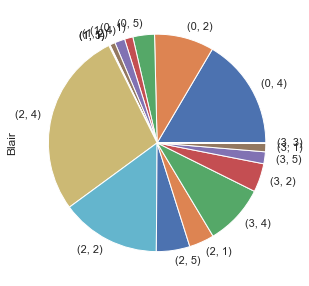

political.knowledge  Blair
0                    4        252
                     2        135
                     5         49
                     1         19
1                    4         23
                     2         12
                     1          2
                     5          1
2                    4        423
                     2        226
                     5         76
                     1         57
3                    4        138
                     2         65
                     5         27
                     1         19
                     3          1
Name: Blair, dtype: int64


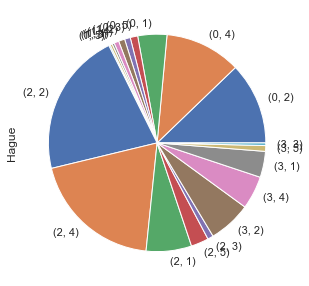

political.knowledge  Hague
0                    2        186
                     4        173
                     1         66
                     5         17
                     3         13
1                    2         14
                     4         11
                     1          5
                     3          5
                     5          3
2                    2        327
                     4        299
                     1        103
                     5         40
                     3         13
3                    2         97
                     4         75
                     1         59
                     5         13
                     3          6
Name: Hague, dtype: int64


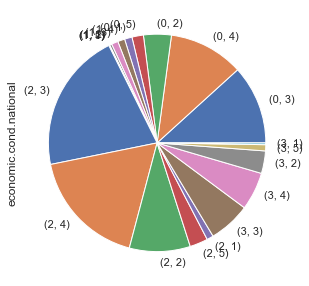

political.knowledge  economic.cond.national
0                    3                         179
                     4                         170
                     2                          63
                     5                          26
                     1                          17
1                    4                          16
                     3                          15
                     2                           5
                     1                           1
                     5                           1
2                    3                         318
                     4                         270
                     2                         138
                     5                          41
                     1                          15
3                    3                          95
                     4                          86
                     2                          51
                     5                

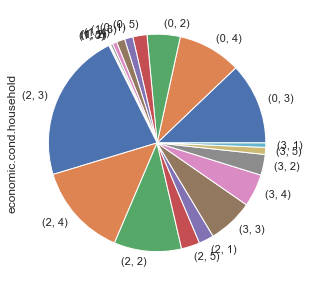

political.knowledge  economic.cond.household
0                    3                          185
                     4                          144
                     2                           75
                     5                           32
                     1                           19
1                    3                           19
                     4                           10
                     2                            5
                     1                            2
                     5                            2
2                    3                          341
                     4                          212
                     2                          153
                     5                           42
                     1                           34
3                    3                          103
                     4                           74
                     2                           47
                   

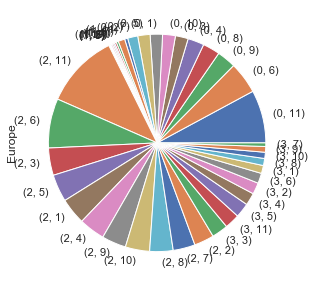

political.knowledge  Europe
0                    11        120
                     6          72
                     9          43
                     8          39
                     4          37
                     3          29
                     10         29
                     1          28
                     5          28
                     7          23
                     2           7
1                    11         15
                     7           5
                     8           4
                     1           3
                     4           3
                     10          3
                     6           2
                     2           1
                     3           1
                     5           1
2                    11        169
                     6         112
                     3          62
                     5          62
                     1          60
                     4          59
                     9     

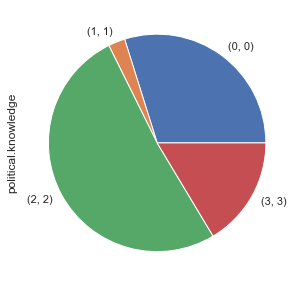

political.knowledge  political.knowledge
0                    0                      455
1                    1                       38
2                    2                      782
3                    3                      250
Name: political.knowledge, dtype: int64


In [54]:
cat=['Blair','Hague','economic.cond.national','economic.cond.household','Europe','political.knowledge']
knd=['line','bar','hist','box','kde','area','pie']
for k in range(len(knd)):
    for i in range(len(cat)):
        for j in range(len(cat)):
            df.groupby(cat[i])[cat[j]].value_counts(ascending=False).plot(kind=knd[k],figsize=(10,5),grid=True),
            plt.xticks(rotation=90)
            plt.show()
            print(df.groupby(cat[i])[cat[j]].value_counts(ascending=False))

In [55]:
from mpl_toolkits.mplot3d import Axes3D  

import matplotlib.pyplot as plt
import numpy as np

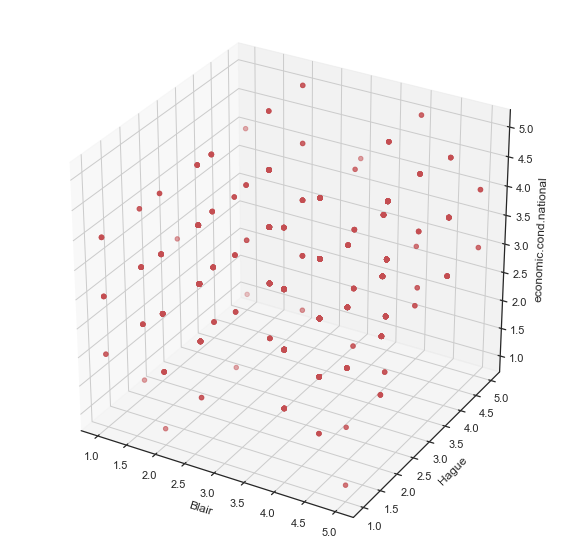

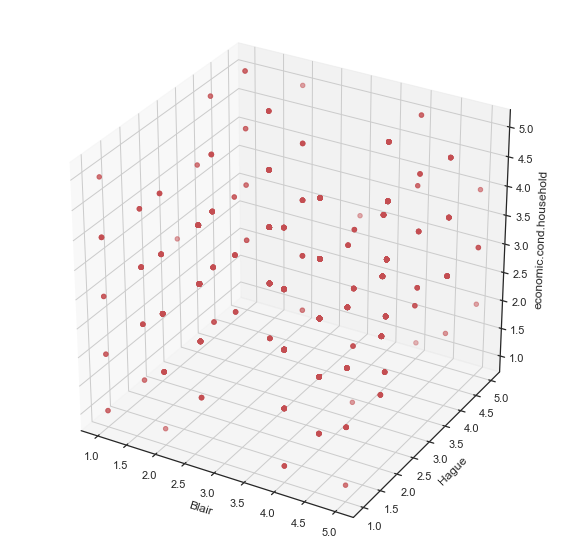

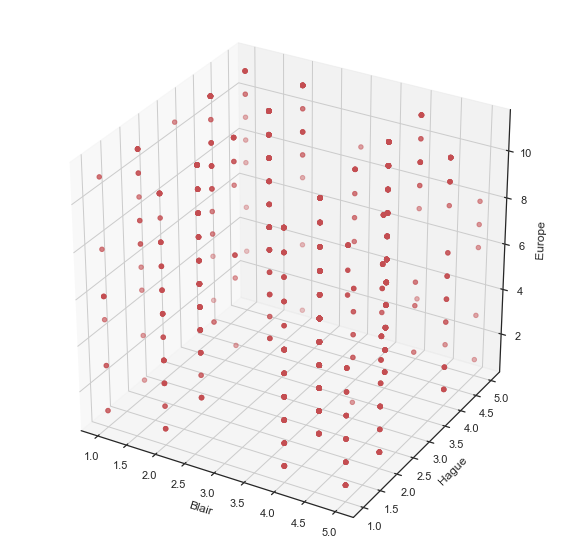

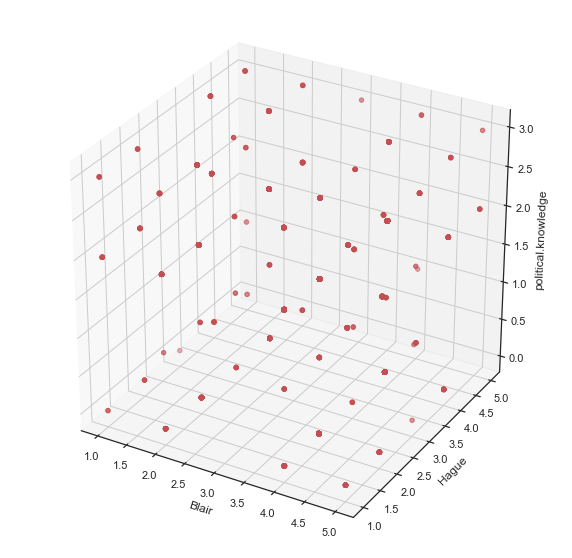

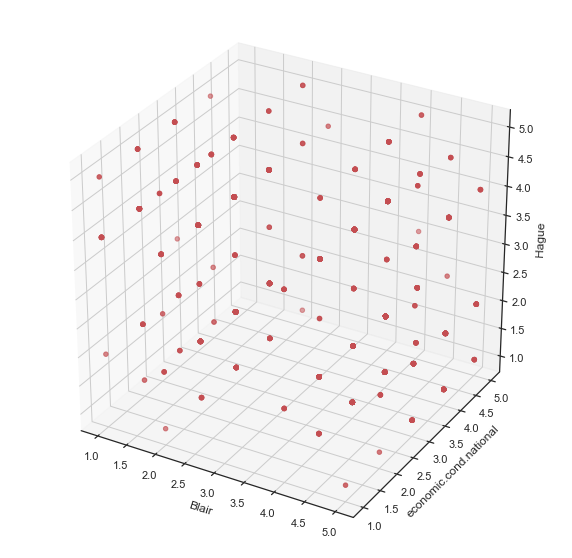

...

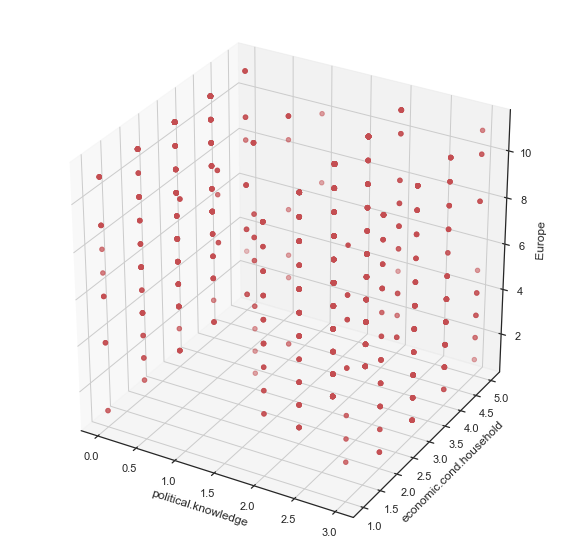

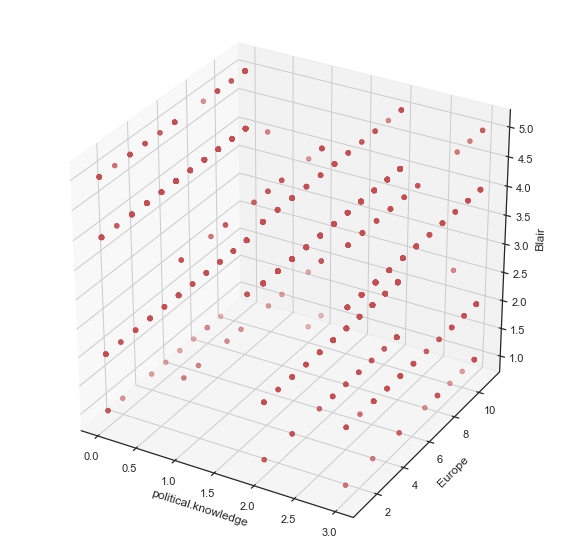

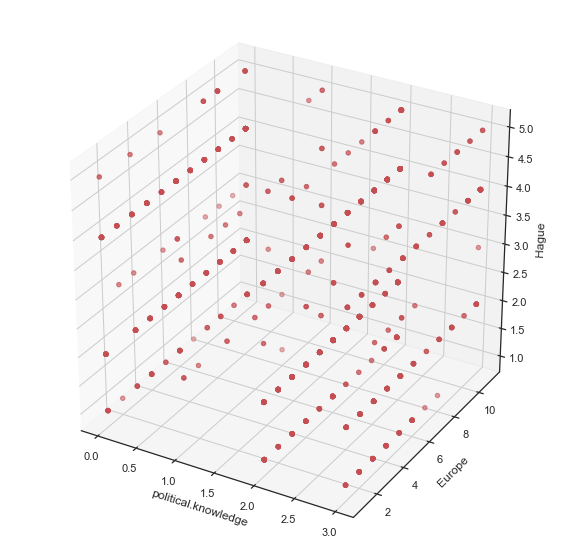

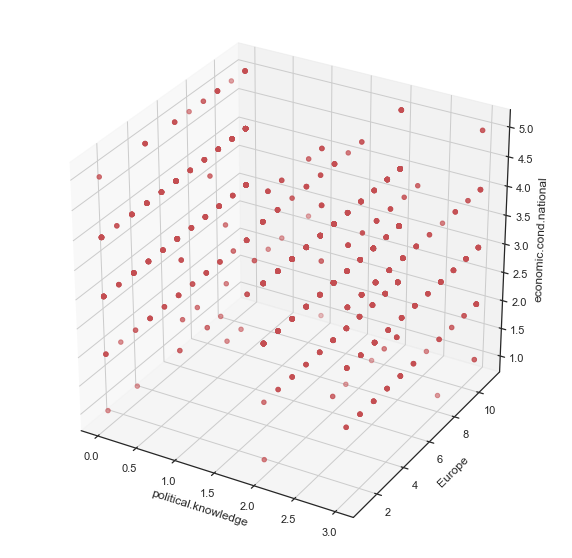

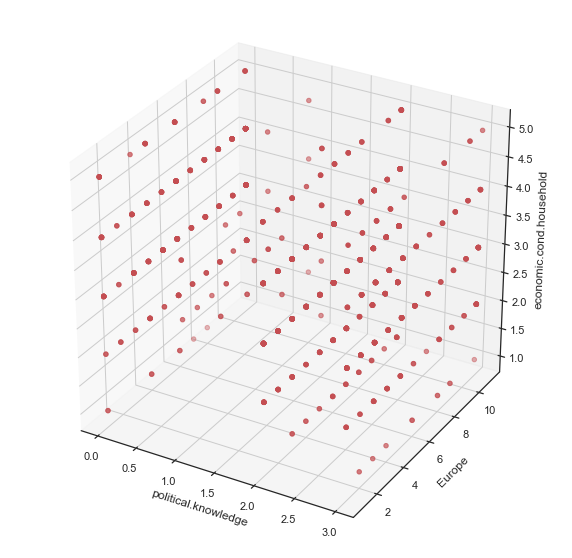

In [56]:
cat=['Blair','Hague','economic.cond.national','economic.cond.household','Europe','political.knowledge']
for i in range(len(cat)):
    for j in range(len(cat)):
        for k in range(len(cat)):
            if i==j:
                print("")
            elif j==k:
                print("")
            elif k==i:
                print("")
            elif i==j==k:
                print("")
            else:
                fig = plt.figure(figsize=(10,10))
                ax = fig.add_subplot(111, projection='3d')
                xs = df[cat[i]]
                ys = df[cat[j]]
                zs = df[cat[k]]
                ax.scatter(xs, ys, zs,c=['r'],marker = 'o')
                ax.set_xlabel(cat[i])
                ax.set_ylabel(cat[j])
                ax.set_zlabel(cat[k])
                plt.show()                

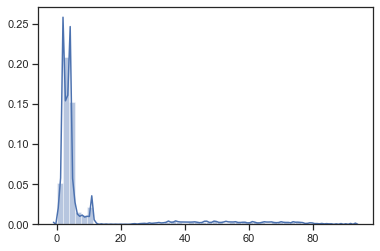

In [57]:
sns.distplot(df.drop(['vote','gender'],axis=1))

In [59]:
df.head()

,vote,age,economic.cond.national,economic.cond.household,Blair,Hague,Europe,political.knowledge,gender
0,Labour,43,3,3,4,1,2,2,female
1,Labour,36,4,4,4,4,5,2,male
2,Labour,35,4,4,5,2,3,2,male
3,Labour,24,4,2,2,1,4,0,female
4,Labour,41,2,2,1,1,6,2,male


# Data splitting

In [60]:
df.rename(columns={"economic.cond.national":"national_ecnomic_cond","economic.cond.household":"household_economic_cond","political.knowledge":"political_knowledge"},inplace=True)

In [61]:
df.head()

,vote,age,national_ecnomic_cond,household_economic_cond,Blair,Hague,Europe,political_knowledge,gender
0,Labour,43,3,3,4,1,2,2,female
1,Labour,36,4,4,4,4,5,2,male
2,Labour,35,4,4,5,2,3,2,male
3,Labour,24,4,2,2,1,4,0,female
4,Labour,41,2,2,1,1,6,2,male


In [62]:
df.columns

Index(['vote', 'age', 'national_ecnomic_cond', 'household_economic_cond',
       'Blair', 'Hague', 'Europe', 'political_knowledge', 'gender'],
      dtype='object')

In [63]:
X=df.iloc[:,1:8]
y=df['vote']

In [64]:
X.head()

,age,national_ecnomic_cond,household_economic_cond,Blair,Hague,Europe,political_knowledge
0,43,3,3,4,1,2,2
1,36,4,4,4,4,5,2
2,35,4,4,5,2,3,2
3,24,4,2,2,1,4,0
4,41,2,2,1,1,6,2


In [65]:
g=df['gender']

In [66]:
from sklearn.preprocessing import MinMaxScaler

In [67]:
X_scaled = X.apply(lambda x:(x-x.min()) / (x.max()-x.min()))

In [68]:
X_scaled['gender']=g

In [69]:
X_scaled=pd.get_dummies(X_scaled)

In [70]:
X_scaled.head()

,age,national_ecnomic_cond,household_economic_cond,Blair,Hague,Europe,political_knowledge,gender_female,gender_male
0,0.275362,0.50,0.50,0.75,0.00,0.1,0.666667,1,0
1,0.173913,0.75,0.75,0.75,0.75,0.4,0.666667,0,1
2,0.159420,0.75,0.75,1.00,0.25,0.2,0.666667,0,1
3,0.000000,0.75,0.25,0.25,0.00,0.3,0.000000,1,0
4,0.246377,0.25,0.25,0.00,0.00,0.5,0.666667,0,1


In [71]:
df.head()

,vote,age,national_ecnomic_cond,household_economic_cond,Blair,Hague,Europe,political_knowledge,gender
0,Labour,43,3,3,4,1,2,2,female
1,Labour,36,4,4,4,4,5,2,male
2,Labour,35,4,4,5,2,3,2,male
3,Labour,24,4,2,2,1,4,0,female
4,Labour,41,2,2,1,1,6,2,male


In [72]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.3 , random_state=1)

In [73]:
from sklearn.linear_model import LogisticRegression
import scipy.stats as stats
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import scale
from sklearn import preprocessing
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn import metrics

# 1. Logistic Regression

In [74]:
model = LogisticRegression(max_iter=1000)
model.fit(X_train, y_train)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [75]:
y_train_predict = model.predict(X_train)
model_score = model.score(X_train, y_train)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_train, y_train_predict))
print("\nclassification report \n",metrics.classification_report(y_train, y_train_predict))

Accuracy 

 0.8369259606373008

Confusion matrix 

 [[225 107]
 [ 67 668]]

classification report 
               precision    recall  f1-score   support

Conservative       0.77      0.68      0.72       332
      Labour       0.86      0.91      0.88       735

    accuracy                           0.84      1067
   macro avg       0.82      0.79      0.80      1067
weighted avg       0.83      0.84      0.83      1067



In [76]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()

AUC: 0.890


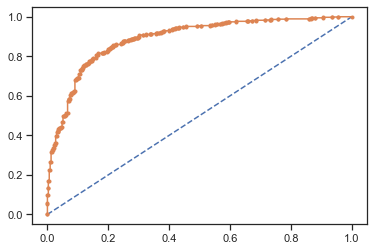

In [77]:
# predict probabilities
probs = model.predict_proba(X_train)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_train, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_train), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [78]:
y_test_predict = model.predict(X_test)
model_score = model.score(X_test, y_test)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_test, y_test_predict))
print("\nclassification report \n",metrics.classification_report(y_test, y_test_predict))

Accuracy 

 0.8209606986899564

Confusion matrix 

 [[ 84  46]
 [ 36 292]]

classification report 
               precision    recall  f1-score   support

Conservative       0.70      0.65      0.67       130
      Labour       0.86      0.89      0.88       328

    accuracy                           0.82       458
   macro avg       0.78      0.77      0.77       458
weighted avg       0.82      0.82      0.82       458



AUC: 0.883


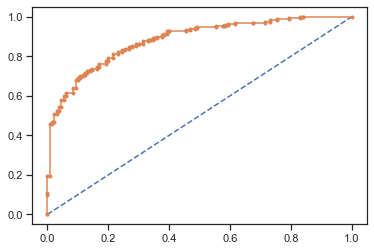

In [79]:
# predict probabilities
probs = model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_test), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

# 2. Linear Discriminant Analysis(LDA)

In [80]:
model = LinearDiscriminantAnalysis()
model.fit(X_train, y_train)

LinearDiscriminantAnalysis(n_components=None, priors=None, shrinkage=None,
                           solver='svd', store_covariance=False, tol=0.0001)

In [81]:
y_train_predict = model.predict(X_train)
model_score = model.score(X_train, y_train)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_train, y_train_predict))
print("\nclassification report \n",metrics.classification_report(y_train, y_train_predict))

Accuracy 

 0.8369259606373008

Confusion matrix 

 [[233  99]
 [ 75 660]]

classification report 
               precision    recall  f1-score   support

Conservative       0.76      0.70      0.73       332
      Labour       0.87      0.90      0.88       735

    accuracy                           0.84      1067
   macro avg       0.81      0.80      0.81      1067
weighted avg       0.83      0.84      0.84      1067



AUC: 0.889


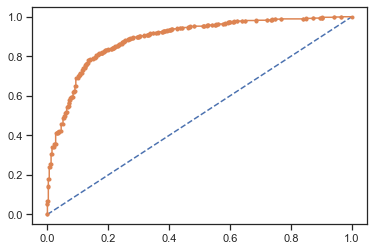

In [82]:
# predict probabilities
probs = model.predict_proba(X_train)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_train, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_train), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [83]:
y_test_predict = model.predict(X_test)
model_score = model.score(X_test, y_test)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_test, y_test_predict))
print("\nclassification report \n",metrics.classification_report(y_test, y_test_predict))

Accuracy 

 0.8187772925764192

Confusion matrix 

 [[ 86  44]
 [ 39 289]]

classification report 
               precision    recall  f1-score   support

Conservative       0.69      0.66      0.67       130
      Labour       0.87      0.88      0.87       328

    accuracy                           0.82       458
   macro avg       0.78      0.77      0.77       458
weighted avg       0.82      0.82      0.82       458



AUC: 0.884


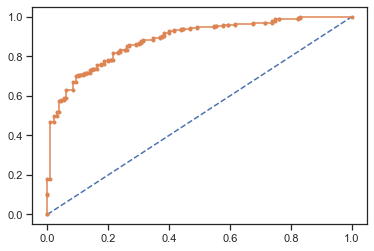

In [84]:
# predict probabilities
probs = model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_test), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

# 3 KNN Model

In [85]:
from sklearn.neighbors import KNeighborsClassifier

model=KNeighborsClassifier()
model.fit(X_train,y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                     weights='uniform')

In [86]:
y_train_predict = model.predict(X_train)
model_score = model.score(X_train, y_train)
print(model_score)
print(metrics.confusion_matrix(y_train, y_train_predict))
print(metrics.classification_report(y_train, y_train_predict))

0.8650421743205249
[[251  81]
 [ 63 672]]
              precision    recall  f1-score   support

Conservative       0.80      0.76      0.78       332
      Labour       0.89      0.91      0.90       735

    accuracy                           0.87      1067
   macro avg       0.85      0.84      0.84      1067
weighted avg       0.86      0.87      0.86      1067



AUC: 0.935


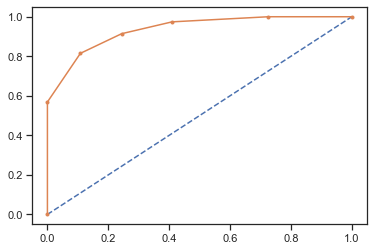

In [87]:
# predict probabilities
probs = model.predict_proba(X_train)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_train, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_train), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [88]:
y_test_predict = model.predict(X_test)
model_score = model.score(X_test, y_test)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_test, y_test_predict))
print("\nclassification report \n",metrics.classification_report(y_test, y_test_predict))

Accuracy 

 0.8253275109170306

Confusion matrix 

 [[ 95  35]
 [ 45 283]]

classification report 
               precision    recall  f1-score   support

Conservative       0.68      0.73      0.70       130
      Labour       0.89      0.86      0.88       328

    accuracy                           0.83       458
   macro avg       0.78      0.80      0.79       458
weighted avg       0.83      0.83      0.83       458



AUC: 0.865


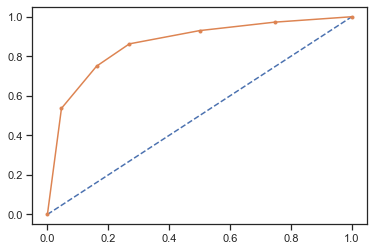

In [89]:
# predict probabilities
probs = model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_test), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

# 4. Naïve Bayes Model

In [90]:
from sklearn.naive_bayes import GaussianNB


In [91]:
model = GaussianNB()
model.fit(X_train, y_train)

GaussianNB(priors=None, var_smoothing=1e-09)

In [92]:
y_train_predict = model.predict(X_train)
model_score = model.score(X_train, y_train)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_train, y_train_predict))
print("\nclassification report \n",metrics.classification_report(y_train, y_train_predict))

Accuracy 

 0.8294283036551078

Confusion matrix 

 [[238  94]
 [ 88 647]]

classification report 
               precision    recall  f1-score   support

Conservative       0.73      0.72      0.72       332
      Labour       0.87      0.88      0.88       735

    accuracy                           0.83      1067
   macro avg       0.80      0.80      0.80      1067
weighted avg       0.83      0.83      0.83      1067



AUC: 0.886


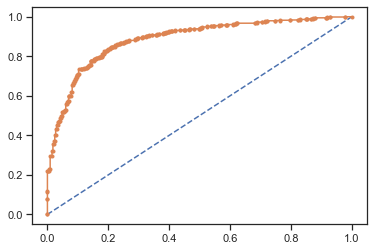

In [93]:
# predict probabilities
probs = model.predict_proba(X_train)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_train, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_train), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [94]:
y_test_predict = model.predict(X_test)
model_score = model.score(X_test, y_test)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_test, y_test_predict))
print("\nclassification report \n",metrics.classification_report(y_test, y_test_predict))

Accuracy 

 0.8165938864628821

Confusion matrix 

 [[ 93  37]
 [ 47 281]]

classification report 
               precision    recall  f1-score   support

Conservative       0.66      0.72      0.69       130
      Labour       0.88      0.86      0.87       328

    accuracy                           0.82       458
   macro avg       0.77      0.79      0.78       458
weighted avg       0.82      0.82      0.82       458



AUC: 0.882


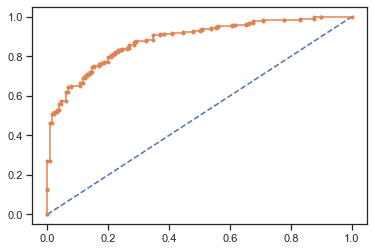

In [95]:
# predict probabilities
probs = model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_test), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

# 5.Support vector machine (SVM) model

In [96]:
from sklearn import svm

model= svm.SVC(random_state=1,probability=True)
model.fit(X_train, y_train)

SVC(C=1.0, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='scale', kernel='rbf',
    max_iter=-1, probability=True, random_state=1, shrinking=True, tol=0.001,
    verbose=False)

In [97]:
y_train_predict = model.predict(X_train)
model_score = model.score(X_train, y_train)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_train, y_train_predict))
print("\nclassification report \n",metrics.classification_report(y_train, y_train_predict))

Accuracy 

 0.8528584817244611

Confusion matrix 

 [[229 103]
 [ 54 681]]

classification report 
               precision    recall  f1-score   support

Conservative       0.81      0.69      0.74       332
      Labour       0.87      0.93      0.90       735

    accuracy                           0.85      1067
   macro avg       0.84      0.81      0.82      1067
weighted avg       0.85      0.85      0.85      1067



AUC: 0.913


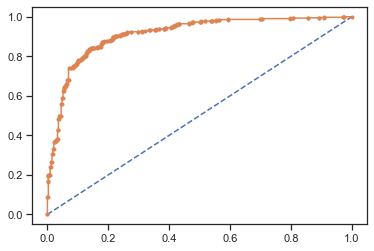

In [98]:
# predict probabilities
probs = model.predict_proba(X_train)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_train, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_train), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [99]:
y_test_predict = model.predict(X_test)
model_score = model.score(X_test, y_test)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_test, y_test_predict))
print("\nclassification report \n",metrics.classification_report(y_test, y_test_predict))

Accuracy 

 0.8209606986899564

Confusion matrix 

 [[ 83  47]
 [ 35 293]]

classification report 
               precision    recall  f1-score   support

Conservative       0.70      0.64      0.67       130
      Labour       0.86      0.89      0.88       328

    accuracy                           0.82       458
   macro avg       0.78      0.77      0.77       458
weighted avg       0.82      0.82      0.82       458



AUC: 0.899


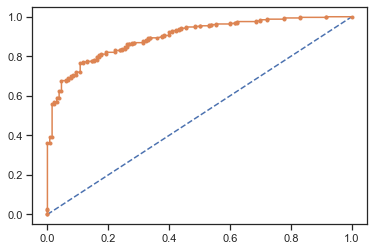

In [100]:
# predict probabilities
probs = model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_test), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

# 6.Random Forest with model tuning/GridSearch

In [101]:
from sklearn.ensemble import RandomForestClassifier

from sklearn.model_selection import GridSearchCV

param_grid = {
    'max_depth': [7,9,11],
    'max_features': [5,6,7],
    'min_samples_leaf': [5,10,15],
    'min_samples_split': [50,75,100],
    'n_estimators': [100]
}

rfcl = RandomForestClassifier()

grid_search = GridSearchCV(estimator = rfcl, param_grid = param_grid, cv = 3)

In [102]:
grid_search.fit(X_train, y_train)
grid_search.best_params_

{'max_depth': 11,
 'max_features': 7,
 'min_samples_leaf': 10,
 'min_samples_split': 50,
 'n_estimators': 100}

In [103]:
best_grid = grid_search.best_estimator_

In [104]:
best_grid

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=11, max_features=7,
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=10, min_samples_split=50,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [105]:
model=best_grid
model.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=11, max_features=7,
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=10, min_samples_split=50,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [106]:
y_train_predict = model.predict(X_train)
model_score = model.score(X_train, y_train)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_train, y_train_predict))
print("\nclassification report \n",metrics.classification_report(y_train, y_train_predict))

Accuracy 

 0.8462980318650422

Confusion matrix 

 [[226 106]
 [ 58 677]]

classification report 
               precision    recall  f1-score   support

Conservative       0.80      0.68      0.73       332
      Labour       0.86      0.92      0.89       735

    accuracy                           0.85      1067
   macro avg       0.83      0.80      0.81      1067
weighted avg       0.84      0.85      0.84      1067



AUC: 0.916


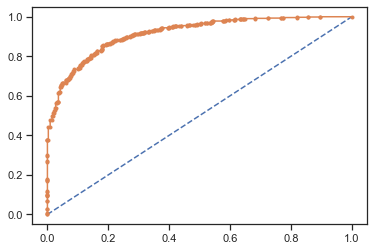

In [107]:
# predict probabilities
probs = model.predict_proba(X_train)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_train, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_train), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [108]:
y_test_predict = model.predict(X_test)
model_score = model.score(X_test, y_test)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_test, y_test_predict))
print("\nclassification report \n",metrics.classification_report(y_test, y_test_predict))

Accuracy 

 0.8165938864628821

Confusion matrix 

 [[ 83  47]
 [ 37 291]]

classification report 
               precision    recall  f1-score   support

Conservative       0.69      0.64      0.66       130
      Labour       0.86      0.89      0.87       328

    accuracy                           0.82       458
   macro avg       0.78      0.76      0.77       458
weighted avg       0.81      0.82      0.81       458



AUC: 0.890


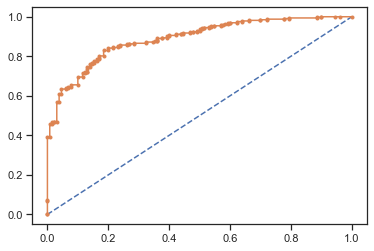

In [109]:
# predict probabilities
probs = model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_test), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

# 7.Random forest without tuning

In [110]:
model=RandomForestClassifier(n_estimators=200,random_state=1)
model.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=200,
                       n_jobs=None, oob_score=False, random_state=1, verbose=0,
                       warm_start=False)

In [111]:
y_train_predict = model.predict(X_train)
model_score = model.score(X_train, y_train)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_train, y_train_predict))
print("\nclassification report \n",metrics.classification_report(y_train, y_train_predict))

Accuracy 

 0.9990627928772259

Confusion matrix 

 [[331   1]
 [  0 735]]

classification report 
               precision    recall  f1-score   support

Conservative       1.00      1.00      1.00       332
      Labour       1.00      1.00      1.00       735

    accuracy                           1.00      1067
   macro avg       1.00      1.00      1.00      1067
weighted avg       1.00      1.00      1.00      1067



AUC: 1.000


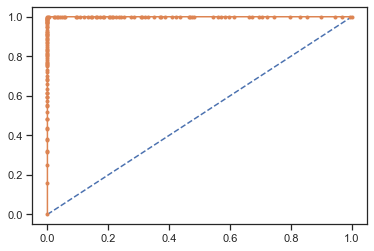

In [112]:
# predict probabilities
probs = model.predict_proba(X_train)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_train, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_train), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [113]:
y_test_predict = model.predict(X_test)
model_score = model.score(X_test, y_test)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_test, y_test_predict))
print("\nclassification report \n",metrics.classification_report(y_test, y_test_predict))

Accuracy 

 0.8231441048034934

Confusion matrix 

 [[ 89  41]
 [ 40 288]]

classification report 
               precision    recall  f1-score   support

Conservative       0.69      0.68      0.69       130
      Labour       0.88      0.88      0.88       328

    accuracy                           0.82       458
   macro avg       0.78      0.78      0.78       458
weighted avg       0.82      0.82      0.82       458



AUC: 0.886


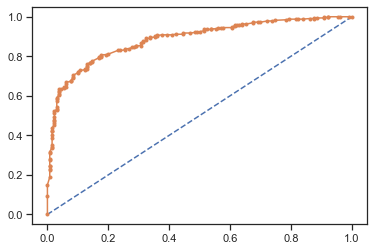

In [114]:
# predict probabilities
probs = model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_test), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

  # using SMOTE*************************

In [115]:
from imblearn.over_sampling import SMOTE

In [116]:
sm = SMOTE(random_state=2)
X_train_res, y_train_res = sm.fit_sample(X_train, y_train.ravel())

# 9.Logistic regression with SMOTE

In [117]:
model = LogisticRegression(max_iter=1000)
model.fit(X_train_res, y_train_res)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [118]:
y_train_predict = model.predict(X_train_res)
model_score = model.score(X_train_res, y_train_res)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_train_res, y_train_predict))
print("\nclassification report \n",metrics.classification_report(y_train_res, y_train_predict))

Accuracy 

 0.817687074829932

Confusion matrix 

 [[594 141]
 [127 608]]

classification report 
               precision    recall  f1-score   support

Conservative       0.82      0.81      0.82       735
      Labour       0.81      0.83      0.82       735

    accuracy                           0.82      1470
   macro avg       0.82      0.82      0.82      1470
weighted avg       0.82      0.82      0.82      1470



AUC: 0.896


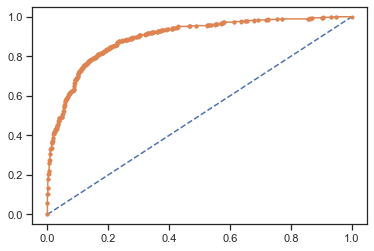

In [119]:
# predict probabilities
probs = model.predict_proba(X_train_res)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_train_res, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_train_res), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [120]:
y_test_predict = model.predict(X_test)
model_score = model.score(X_test, y_test)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_test, y_test_predict))
print("\nclassification report \n",metrics.classification_report(y_test, y_test_predict))

Accuracy 

 0.7969432314410481

Confusion matrix 

 [[102  28]
 [ 65 263]]

classification report 
               precision    recall  f1-score   support

Conservative       0.61      0.78      0.69       130
      Labour       0.90      0.80      0.85       328

    accuracy                           0.80       458
   macro avg       0.76      0.79      0.77       458
weighted avg       0.82      0.80      0.80       458



AUC: 0.882


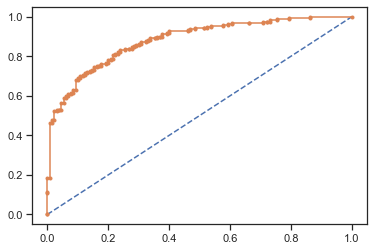

In [121]:
# predict probabilities
probs = model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_test), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [122]:
from sklearn.model_selection import cross_val_score
scores = cross_val_score(model, X_train_res, y_train_res, cv=10)


In [123]:
scores = cross_val_score(model, X_train_res, y_train_res, cv=10)
print(scores)
print(scores.max())
print(scores.min())
print(scores.max()-scores.min())

[0.82312925 0.78911565 0.85034014 0.80952381 0.82312925 0.84353741
 0.78911565 0.80272109 0.82993197 0.79591837]
0.8503401360544217
0.7891156462585034
0.061224489795918324


# 10. LDA with smote

In [124]:
model = LinearDiscriminantAnalysis()
model.fit(X_train_res, y_train_res)

LinearDiscriminantAnalysis(n_components=None, priors=None, shrinkage=None,
                           solver='svd', store_covariance=False, tol=0.0001)

In [125]:
y_train_predict = model.predict(X_train_res)
model_score = model.score(X_train_res, y_train_res)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_train_res, y_train_predict))
print("\nclassification report \n",metrics.classification_report(y_train_res, y_train_predict))

Accuracy 

 0.8170068027210884

Confusion matrix 

 [[593 142]
 [127 608]]

classification report 
               precision    recall  f1-score   support

Conservative       0.82      0.81      0.82       735
      Labour       0.81      0.83      0.82       735

    accuracy                           0.82      1470
   macro avg       0.82      0.82      0.82      1470
weighted avg       0.82      0.82      0.82      1470



AUC: 0.895


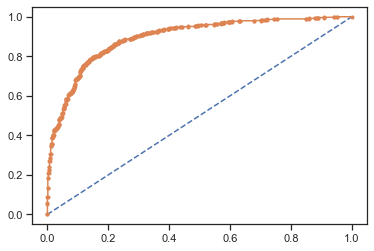

In [126]:
# predict probabilities
probs = model.predict_proba(X_train_res)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_train_res, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_train_res), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [127]:
y_test_predict = model.predict(X_test)
model_score = model.score(X_test, y_test)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_test, y_test_predict))
print("\nclassification report \n",metrics.classification_report(y_test, y_test_predict))

Accuracy 

 0.7925764192139738

Confusion matrix 

 [[102  28]
 [ 67 261]]

classification report 
               precision    recall  f1-score   support

Conservative       0.60      0.78      0.68       130
      Labour       0.90      0.80      0.85       328

    accuracy                           0.79       458
   macro avg       0.75      0.79      0.76       458
weighted avg       0.82      0.79      0.80       458



AUC: 0.882


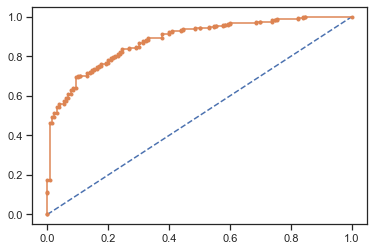

In [128]:
# predict probabilities
probs = model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_test), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [129]:
scores = cross_val_score(model, X_train_res, y_train_res, cv=10)
print(scores)
print(scores.max())
print(scores.min())
print(scores.max()-scores.min())

[0.82312925 0.79591837 0.82312925 0.81632653 0.82312925 0.84353741
 0.78911565 0.80272109 0.82993197 0.79591837]
0.8435374149659864
0.7891156462585034
0.054421768707483054


# Navie bayes with smote

In [130]:
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics

In [131]:
model = GaussianNB()
model.fit(X_train_res, y_train_res)

GaussianNB(priors=None, var_smoothing=1e-09)

In [132]:
## Performance Matrix on train data set with SMOTE
y_train_predict = model.predict(X_train_res)
model_score = model.score(X_train_res, y_train_res)
print(model_score)
print(metrics.confusion_matrix(y_train_res, y_train_predict))
print(metrics.classification_report(y_train_res ,y_train_predict))

0.8149659863945579
[[594 141]
 [131 604]]
              precision    recall  f1-score   support

Conservative       0.82      0.81      0.81       735
      Labour       0.81      0.82      0.82       735

    accuracy                           0.81      1470
   macro avg       0.82      0.81      0.81      1470
weighted avg       0.82      0.81      0.81      1470



AUC: 0.894


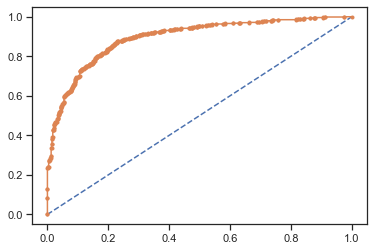

In [133]:
# predict probabilities
probs = model.predict_proba(X_train_res)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_train_res, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_train_res), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [134]:
y_test_predict = model.predict(X_test)
model_score = model.score(X_test, y_test)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_test, y_test_predict))
print("\nclassification report \n",metrics.classification_report(y_test, y_test_predict))

Accuracy 

 0.7816593886462883

Confusion matrix 

 [[104  26]
 [ 74 254]]

classification report 
               precision    recall  f1-score   support

Conservative       0.58      0.80      0.68       130
      Labour       0.91      0.77      0.84       328

    accuracy                           0.78       458
   macro avg       0.75      0.79      0.76       458
weighted avg       0.82      0.78      0.79       458



AUC: 0.879


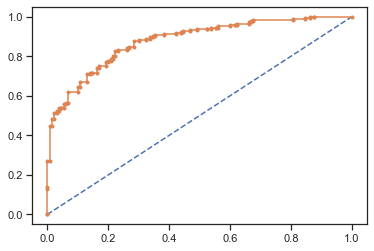

In [135]:
# predict probabilities
probs = model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_test), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [136]:
from sklearn.model_selection import cross_val_score
scores = cross_val_score(model, X_train_res, y_train_res, cv=10)

In [137]:
print(scores.max())
print(scores.min())
print(scores.max()-scores.min())

0.8435374149659864
0.7687074829931972
0.0748299319727892


# XGBOOST WITH SMOTE

In [138]:
import xgboost as xgb
model=xgb.XGBClassifier(random_state=1,learning_rate=0.01)
model.fit(X_train_res, y_train_res)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0,
              learning_rate=0.01, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=None, n_estimators=100, n_jobs=1,
              nthread=None, objective='binary:logistic', random_state=1,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=1, verbosity=1)

In [139]:
## Performance Matrix on train data set
y_train_predict = model.predict(X_train_res)
model_score = model.score(X_train_res, y_train_res)
print(model_score)
print(metrics.confusion_matrix(y_train_res, y_train_predict))
print(metrics.classification_report(y_train_res, y_train_predict))

0.8510204081632653
[[624 111]
 [108 627]]
              precision    recall  f1-score   support

Conservative       0.85      0.85      0.85       735
      Labour       0.85      0.85      0.85       735

    accuracy                           0.85      1470
   macro avg       0.85      0.85      0.85      1470
weighted avg       0.85      0.85      0.85      1470



AUC: 0.921


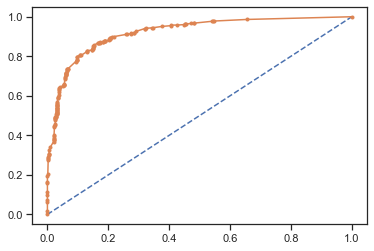

In [140]:
# predict probabilities
probs = model.predict_proba(X_train_res)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_train_res, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_train_res), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [141]:
y_test_predict = model.predict(X_test)
model_score = model.score(X_test, y_test)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_test, y_test_predict))
print("\nclassification report \n",metrics.classification_report(y_test, y_test_predict))

Accuracy 

 0.8122270742358079

Confusion matrix 

 [[104  26]
 [ 60 268]]

classification report 
               precision    recall  f1-score   support

Conservative       0.63      0.80      0.71       130
      Labour       0.91      0.82      0.86       328

    accuracy                           0.81       458
   macro avg       0.77      0.81      0.78       458
weighted avg       0.83      0.81      0.82       458



AUC: 0.895


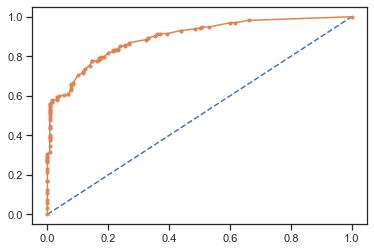

In [142]:
# predict probabilities
probs = model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_test), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [143]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(model, X_train_res, y_train_res, cv=10)

In [144]:
print(scores)
print(scores.max())
print(scores.min())
print(scores.max()-scores.min())

[0.80272109 0.78231293 0.83673469 0.82993197 0.82312925 0.84353741
 0.83673469 0.86394558 0.83673469 0.86394558]
0.8639455782312925
0.782312925170068
0.08163265306122447


# KNN With SMOTE

In [145]:
from sklearn.neighbors import KNeighborsClassifier

model=KNeighborsClassifier()
model.fit(X_train_res,y_train_res)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                     weights='uniform')

In [146]:
## Performance Matrix on train data set
y_train_predict = model.predict(X_train_res)
model_score = model.score(X_train_res, y_train_res)
print(model_score)
print(metrics.confusion_matrix(y_train_res, y_train_predict))
print(metrics.classification_report(y_train_res, y_train_predict))

0.8884353741496599
[[688  47]
 [117 618]]
              precision    recall  f1-score   support

Conservative       0.85      0.94      0.89       735
      Labour       0.93      0.84      0.88       735

    accuracy                           0.89      1470
   macro avg       0.89      0.89      0.89      1470
weighted avg       0.89      0.89      0.89      1470



AUC: 0.966


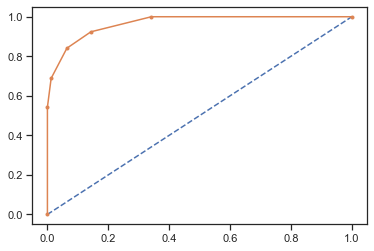

In [147]:
# predict probabilities
probs = model.predict_proba(X_train_res)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_train_res, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_train_res), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [148]:
y_test_predict = model.predict(X_test)
model_score = model.score(X_test, y_test)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_test, y_test_predict))
print("\nclassification report \n",metrics.classification_report(y_test, y_test_predict))

Accuracy 

 0.7663755458515283

Confusion matrix 

 [[106  24]
 [ 83 245]]

classification report 
               precision    recall  f1-score   support

Conservative       0.56      0.82      0.66       130
      Labour       0.91      0.75      0.82       328

    accuracy                           0.77       458
   macro avg       0.74      0.78      0.74       458
weighted avg       0.81      0.77      0.78       458



AUC: 0.851


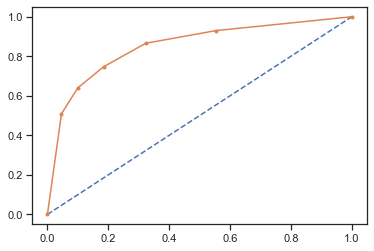

In [149]:
# predict probabilities
probs = model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_test), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [150]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(model, X_train_res, y_train_res, cv=10)

In [151]:
scores = cross_val_score(model, X_train_res, y_train_res, cv=10)
print(scores)
print(scores.max())
print(scores.min())
print(scores.max()-scores.min())

[0.80952381 0.78911565 0.8707483  0.82312925 0.82312925 0.85034014
 0.82993197 0.89115646 0.80952381 0.88435374]
0.891156462585034
0.7891156462585034
0.10204081632653061


# SVM with SMOTE

In [152]:
from sklearn import svm

model= svm.SVC(random_state=1,probability=True)
model.fit(X_train_res, y_train_res)

SVC(C=1.0, break_ties=False, cache_size=200, class_weight=None, coef0=0.0,
    decision_function_shape='ovr', degree=3, gamma='scale', kernel='rbf',
    max_iter=-1, probability=True, random_state=1, shrinking=True, tol=0.001,
    verbose=False)

In [153]:
## Performance Matrix on train data set
y_train_predict = model.predict(X_train_res)
model_score = model.score(X_train_res, y_train_res)
print(model_score)
print(metrics.confusion_matrix(y_train_res, y_train_predict))
print(metrics.classification_report(y_train_res, y_train_predict))

0.861904761904762
[[641  94]
 [109 626]]
              precision    recall  f1-score   support

Conservative       0.85      0.87      0.86       735
      Labour       0.87      0.85      0.86       735

    accuracy                           0.86      1470
   macro avg       0.86      0.86      0.86      1470
weighted avg       0.86      0.86      0.86      1470



AUC: 0.926


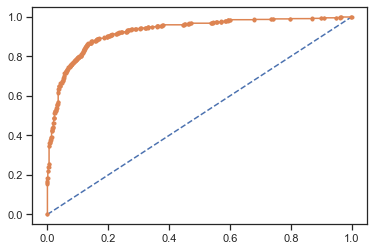

In [154]:
# predict probabilities
probs = model.predict_proba(X_train_res)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_train_res, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_train_res), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [155]:
y_test_predict = model.predict(X_test)
model_score = model.score(X_test, y_test)

print("Accuracy \n\n",model_score)
print("\nConfusion matrix \n\n",metrics.confusion_matrix(y_test, y_test_predict))
print("\nclassification report \n",metrics.classification_report(y_test, y_test_predict))

Accuracy 

 0.8078602620087336

Confusion matrix 

 [[109  21]
 [ 67 261]]

classification report 
               precision    recall  f1-score   support

Conservative       0.62      0.84      0.71       130
      Labour       0.93      0.80      0.86       328

    accuracy                           0.81       458
   macro avg       0.77      0.82      0.78       458
weighted avg       0.84      0.81      0.82       458



AUC: 0.899


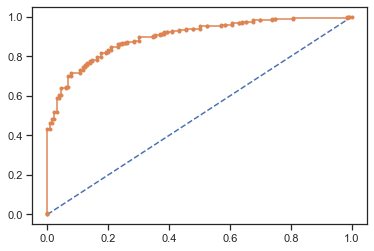

In [156]:
# predict probabilities
probs = model.predict_proba(X_test)
# keep probabilities for the positive outcome only
probs = probs[:, 1]
# calculate AUC
from sklearn.metrics import roc_auc_score
auc = roc_auc_score(y_test, probs)
print('AUC: %.3f' % auc)
# calculate roc curve
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_test), probs)
plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [157]:
scores = cross_val_score(model, X_train_res, y_train_res, cv=10)
print(scores)
print(scores.max())
print(scores.min())
print(scores.max()-scores.min())

[0.82993197 0.82312925 0.8707483  0.84353741 0.86394558 0.86394558
 0.84353741 0.81632653 0.82312925 0.8707483 ]
0.8707482993197279
0.8163265306122449
0.05442176870748294


In [158]:
df = pd.read_excel ('Election_Data.xlsx', sheet_name='Election_Dataset_Two Classes')

In [160]:
df_cat=df[['vote','gender']]

In [161]:
df_cat

,vote,gender
0,Labour,female
1,Labour,male
2,Labour,male
3,Labour,female
4,Labour,male
...,...,...
1520,Conservative,male
1521,Conservative,male
1522,Labour,male
1523,Conservative,male


In [162]:
df_num=df[['age','economic.cond.national','economic.cond.household','Blair','Hague','Europe','political.knowledge']]

In [168]:
df[['age','economic.cond.national','economic.cond.household','Blair','Hague','Europe','political.knowledge']].describe()

,age,economic.cond.national,economic.cond.household,Blair,Hague,Europe,political.knowledge
count,1525.000000,1525.000000,1525.000000,1525.000000,1525.000000,1525.000000,1525.000000
mean,54.182295,3.245902,3.140328,3.334426,2.746885,6.728525,1.542295
std,15.711209,0.880969,0.929951,1.174824,1.230703,3.297538,1.083315
min,24.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000
25%,41.000000,3.000000,3.000000,2.000000,2.000000,4.000000,0.000000
50%,53.000000,3.000000,3.000000,4.000000,2.000000,6.000000,2.000000
75%,67.000000,4.000000,4.000000,4.000000,4.000000,10.000000,2.000000
max,93.000000,5.000000,5.000000,5.000000,5.000000,11.000000,3.000000


In [166]:
df[['vote','gender']].describe()

,vote,gender
count,1525,1525
unique,2,2
top,Labour,female
freq,1063,812


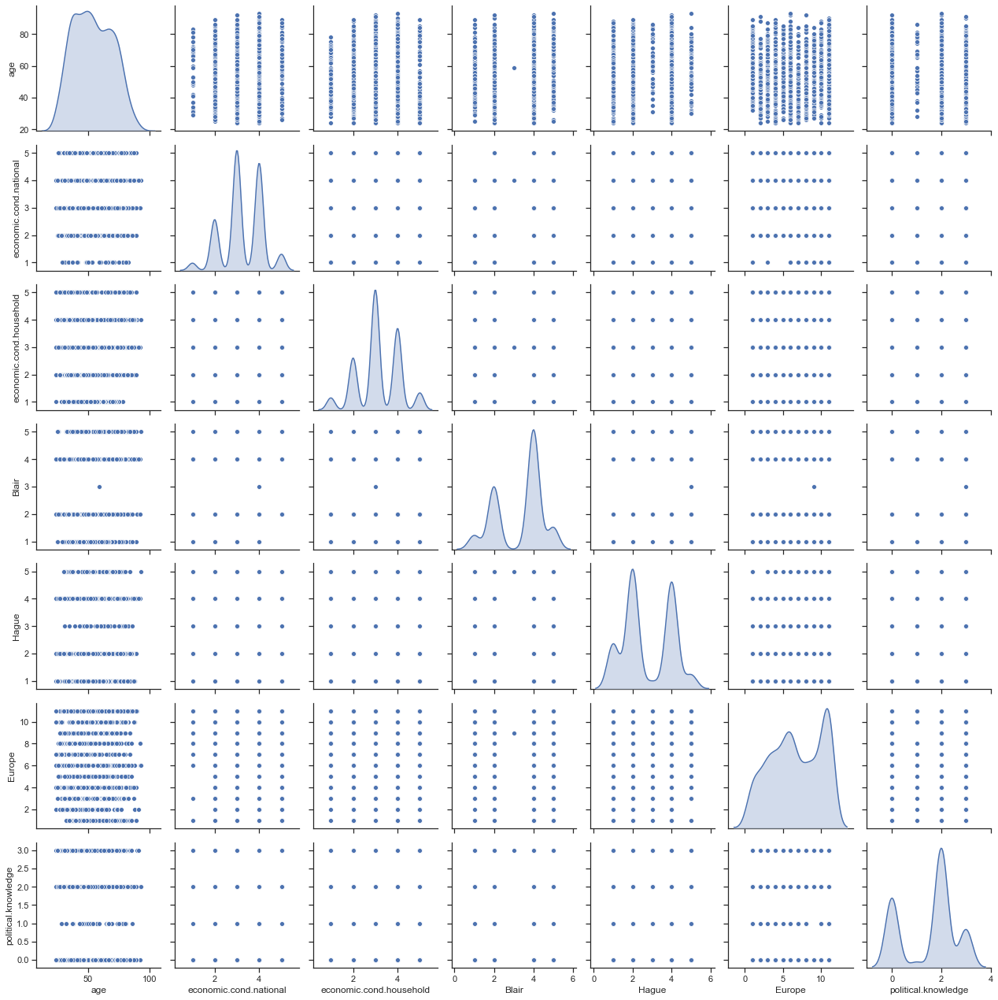

In [173]:
sns.pairplot(df.drop('Unnamed: 0',axis=1),diag_kind='kde')

In [171]:
df.head()

,Unnamed: 0,vote,age,economic.cond.national,economic.cond.household,Blair,Hague,Europe,political.knowledge,gender
0,1,Labour,43,3,3,4,1,2,2,female
1,2,Labour,36,4,4,4,4,5,2,male
2,3,Labour,35,4,4,5,2,3,2,male
3,4,Labour,24,4,2,2,1,4,0,female
4,5,Labour,41,2,2,1,1,6,2,male


In [202]:
cat=['Blair','Hague','economic.cond.national','economic.cond.household','Europe','political.knowledge']
for i in range(len(cat)):
    display(pd.crosstab([df['vote'],df[cat[i]]],df['gender'],margins=True))


gender              female  male   All
vote         Blair                    
Conservative 1          28    31    59
             2         142   100   242
             3           0     1     1
             4          88    69   157
             5           1     2     3
Labour       1          24    14    38
             2         116    80   196
             4         345   334   679
             5          68    82   150
All                    812   713  1525

gender              female  male   All
vote         Hague                    
Conservative 1           6     5    11
             2          58    38    96
             3           6     3     9
             4         161   126   287
             5          28    31    59
Labour       1         106   116   222
             2         274   254   528
             3          18    10    28
             4         149   122   271
             5           6     8    14
All                    812   713  1525

gender                               female  male   All
vote         economic.cond.national                    
Conservative 1                           12     9    21
             2                           74    66   140
             3                          117    83   200
             4                           52    40    92
             5                            4     5     9
Labour       1                           11     5    16
             2                           64    53   117
             3                          224   183   407
             4                          221   229   450
             5                           33    40    73
All                                     812   713  1525

gender                                female  male   All
vote         economic.cond.household                    
Conservative 1                            14    14    28
             2                            68    58   126
             3                           118    80   198
             4                            49    38    87
             5                            10    13    23
Labour       1                            23    14    37
             2                            85    69   154
             3                           232   218   450
             4                           178   175   353
             5                            35    34    69
All                                      812   713  1525

gender               female  male   All
vote         Europe                    
Conservative 1            4     1     5
             2            4     2     6
             3            7     7    14
             4           13     5    18
             5            8    12    20
             6           24    12    36
             7           21    11    32
             8           25    24    49
             9           25    31    56
             10          32    22    54
             11          96    76   172
Labour       1           46    58   104
             2           28    45    73
             3           51    64   115
             4           51    58   109
             5           54    50   104
             6          106    67   173
             7           32    22    54
             8           33    30    63
             9           28    27    55
             10          28    19    47
             11          96    70   166
All                     812   713  1525

gender                            female  male   All
vote         political.knowledge                    
Conservative 0                        57    38    95
             1                         5     6    11
             2                       169   115   284
             3                        28    44    72
Labour       0                       225   135   360
             1                        18     9    27
             2                       253   245   498
             3                        57   121   178
All                                  812   713  1525

In [182]:
pd.crosstab(df['vote'],df['Europe'],margins=True)

Europe,1,2,3,4,5,6,7,8,9,10,11,All
vote,,,,,,,,,,,,
Conservative,5,6,14,18,20,36,32,49,56,54,172,462
Labour,104,73,115,109,104,173,54,63,55,47,166,1063
All,109,79,129,127,124,209,86,112,111,101,338,1525


In [200]:
pd.crosstab([df['vote'],df['Europe']],df['gender'])

gender               female  male
vote         Europe              
Conservative 1            4     1
             2            4     2
             3            7     7
             4           13     5
             5            8    12
             6           24    12
             7           21    11
             8           25    24
             9           25    31
             10          32    22
             11          96    76
Labour       1           46    58
             2           28    45
             3           51    64
             4           51    58
             5           54    50
             6          106    67
             7           32    22
             8           33    30
             9           28    27
             10          28    19
             11          96    70

In [203]:
df['vote'].value_counts(normalize=True)

Labour          0.697049
Conservative    0.302951
Name: vote, dtype: float64